# <center> Прогнозирование оттока
### <center> Финальное решение и экономическая модель
##### <center> Глазунов А.В.

Задачей данного ноутбука является построение наилучшей модели посредством экспериментов с разными моделями бустинга, оверсэмплингом, дополнительными признаками, а также дальнейшее построение прототипа экономической модели для оценки применимости  машинного обучения для бизнеса.

Подключение диска и загрузка библиотек

In [1]:
from google.colab import drive
drive.mount('/content/gdrive',force_remount=True)


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [2]:
cd /content/gdrive/'My Drive'/Colab_Notebooks/CHURN_prediction_competition

/content/gdrive/My Drive/Colab_Notebooks/CHURN_prediction_competition


In [3]:
pip install category_encoders

     |████████████████████████████████| 81kB 4.1MB/s 


In [4]:
pip install catboost

     |████████████████████████████████| 64.8MB 55kB/s 


In [6]:
from sklearn.base import BaseEstimator, TransformerMixin


import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
from matplotlib import pyplot as plt
sns.set_style("darkgrid")
import pandas as pd
import numpy as np
from scipy import stats
import itertools
import random
from category_encoders import LeaveOneOutEncoder,TargetEncoder, BinaryEncoder,SumEncoder,BackwardDifferenceEncoder
from sklearn import model_selection, metrics, pipeline, preprocessing,impute
from sklearn.model_selection import train_test_split,StratifiedKFold, cross_val_score,GridSearchCV
from sklearn.feature_selection import SelectFromModel

from imblearn import over_sampling
import gc
from tqdm import tqdm_notebook

from sklearn.svm import LinearSVC
from sklearn.linear_model import LogisticRegression
import xgboost as xgb
import lightgbm as lgb
from catboost import CatBoostClassifier,Pool
from sklearn.linear_model import SGDClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,roc_auc_score,f1_score,classification_report,roc_curve, confusion_matrix,average_precision_score,precision_recall_curve,auc,precision_score,recall_score

Загрузка данных, инициализация функций, эксперименты с моделью

In [7]:
features = pd.read_csv('orange_small_churn_data.train')
labels = pd.read_csv('orange_small_churn_labels.train',header= None,names=['target'])
feats_train,feats_val,labels_train,labels_val = train_test_split(features,labels, test_size = 0.3,\
                                                                   shuffle=True,random_state=42,\
                                                                   stratify = labels)
feats_train.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230
6892,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,...,NaN,DHeTmBftjz,RO12,NaN,taul,1K8T,7gSz,8ij6Lg8,LJF4fPp,NaN,NaN,Bcur,9_Y1,Z5OU,VpdQ,NaN,me75fM6ugJ,kIsH,NaN,uKAI,Mtgm,NhsEn4L,NaN,NaN,NaN,7WwCtIM,1GbF,cJvF,AU8pNoi,7OmVzos,oslk,76DJixu,LM8l689qOp,NaN,NaN,Qu4f,RAYp,F2FyR07IdsN7I,NaN,NaN
34821,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,3.36,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,2jigUH7ejg,RO12,NaN,taul,1K8T,dm89,LG0vbUP,n1zVHpT8NN,NaN,NaN,5FzM,9_Y1,DmlN,09_Q,NaN,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,mAja5EA,FJ56cYO,cJvF,NaN,sE0uLpj,oslk,G9maF5M,NaN,NaN,NaN,w_Ub,RAYp,F2FyR07IdsN7I,NaN,NaN
34190,NaN,NaN,NaN,NaN,NaN,98.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,152.0,190.0,NaN,0.0,64.0,NaN,NaN,86.96,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN,NaN,4107204.0,NaN,NaN,...,NaN,zcRZptzip9,RO12,NaN,taul,1K8T,USOt,pro8v8X,CsjH_hi,NaN,NaN,rUBc,9_Y1,t_4G,VpdQ,IYzP,me75fM6ugJ,sBgB,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,mAjDcoz,xYrN,cJvF,FzaX,meWVy8V,oslk,DQ3u3MC,LM8l689qOp,NaN,NaN,Qu4f,RAYp,F2FyR07IdsN7I,NaN,NaN
24541,NaN,NaN,NaN,NaN,NaN,938.0,7.0,NaN,NaN,NaN,NaN,NaN,520.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,148.0,185.0,NaN,2.0,96.0,NaN,NaN,186.64,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,749586.0,NaN,NaN,...,NaN,mzKvyx8zhV,2Knk1KF,NaN,taul,1K8T,vSNn,fhk21Ss,Hz673939hSRjL,0eHFhrP,NaN,W9XQ,9_Y1,QMes,VpdQ,wMei,7M47J5GA0pTYIFxg5uy,kIsH,NaN,uKAI,L84s,Ie_5MZs,NaN,Go_XylT,NaN,XTbjhEX,F6F0,cJvF,FzaX,4UxGlow,zCkv,catzS2D,jySVZNlOJy,NaN,ELof,WqMG,ZI9m,TCU50_Yjmm6GIBZ0lL_,mj86,NaN
31483,NaN,NaN,NaN,NaN,NaN,602.0,7.0,NaN,NaN,NaN,NaN,NaN,88.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,0.0,NaN,NaN,166.56,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,NaN,639qrQK2Mx,RO12,NaN,taul,1K8T,AHgj,creg0bq,5q1hF23,NaN,NaN,6Yf9,9_Y1,15m3,sJzTlal,IYzP,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,mAjbk_S,oLcf,cJvF,FzaX,VgKv48t,oslk,nRgz4Af,LM8l689qOp,NaN,NaN,FSa2,RAYp,F2FyR07IdsN7I,NaN,NaN


In [8]:
test_data = pd.read_csv('orange_small_churn_test_data.csv', index_col='ID')
test_data.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,1225.0,7.0,NaN,NaN,NaN,NaN,NaN,2352.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,180.0,225.0,NaN,0.0,56.0,NaN,NaN,388.08,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,6726960.0,NaN,NaN,...,NaN,P1WvyxLp3Z,2Knk1KF,NaN,taul,1K8T,0Xwj,PHNvXy8,xUOdRmdN20,IBm9AvG,NaN,skcI,HLqf,vzJD,NaN,lVqb,NKv3VA1BpP,sBgB,NaN,uKAI,L84s,Ie_5MZs,NaN,xRz9wph,NaN,CWNY2py,jgOV,UYBR,FzaX,UF16siJ,zCkv,APgdzOv,jySVZNlOJy,NaN,ELof,xb3V,6fzt,Zy3gnGM,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,896.0,14.0,NaN,NaN,NaN,NaN,NaN,1560.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,112.0,140.0,NaN,0.0,96.0,NaN,NaN,133.12,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,NaN,bZkvyxLkBI,RO12,NaN,taul,1K8T,0Xwj,6KF0k8W,V4E_TU9097,NaN,NaN,CZsd,F3hy,vzJD,09_Q,IYzP,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,TDcECyH,PDRj,cJvF,FzaX,ot6oLzk,oslk,IIvC99a,LM8l689qOp,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,791.0,7.0,NaN,NaN,NaN,NaN,NaN,2824.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,172.0,215.0,NaN,4.0,16.0,NaN,NaN,324.48,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,2988486.0,NaN,NaN,...,NaN,75lTmBtFkL,RO12,SEuy,taul,1K8T,AnrR,ckoNVBU,_jTP8ioIlJ,JnrRQD4,smXZ,PwdO,9_Y1,C6Eu,VpdQ,sYC_,me75fM6ugJ,kIsH,NaN,uKAI,Mtgm,NhsEn4L,NaN,Iy8LM_S,NaN,kq0aHkC,laMb,UYBR,FzaX,6VLNqhB,oslk,6YSocsg,LM8l689qOp,NaN,kG3k,rgKb,RAYp,F2FyR07IdsN7I,mj86,NaN
3,NaN,NaN,NaN,NaN,NaN,2296.0,7.0,NaN,NaN,NaN,NaN,NaN,3732.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,480.0,600.0,NaN,10.0,104.0,NaN,NaN,286.96,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,6637740.0,NaN,NaN,...,NaN,YddTmBtueT,RO12,SEuy,taul,1K8T,487l,77f44U8,II0S8f9,a1lFLoc,smXZ,SOkz,9_Y1,C6Eu,VpdQ,IYzP,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,GccbB3h,NaN,mAjbk_S,qLRt,UYBR,FzaX,tzp8jNM,oslk,5nQ7A2G,jySVZNlOJy,NaN,kG3k,rgKb,RAYp,F2FyR07IdsN7I,am7c,NaN
4,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,28.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,mCGq9ayE15,RO12,NaN,taul,1K8T,lK27,esxkA1P,767sa0XN9l,NaN,NaN,kVZt,9_Y1,vm5R,09_Q,NaN,me75fM6ugJ,kIsH,NaN,uKAI,Mtgm,NhsEn4L,NaN,NaN,eGzu,7Wwvby0,XqfQ,UYBR,FzaX,EPImS85,oslk,MI8s5nE,LM8l689qOp,NaN,NaN,7P5s,RAYp,F2FyR07IdsN7I,NaN,NaN


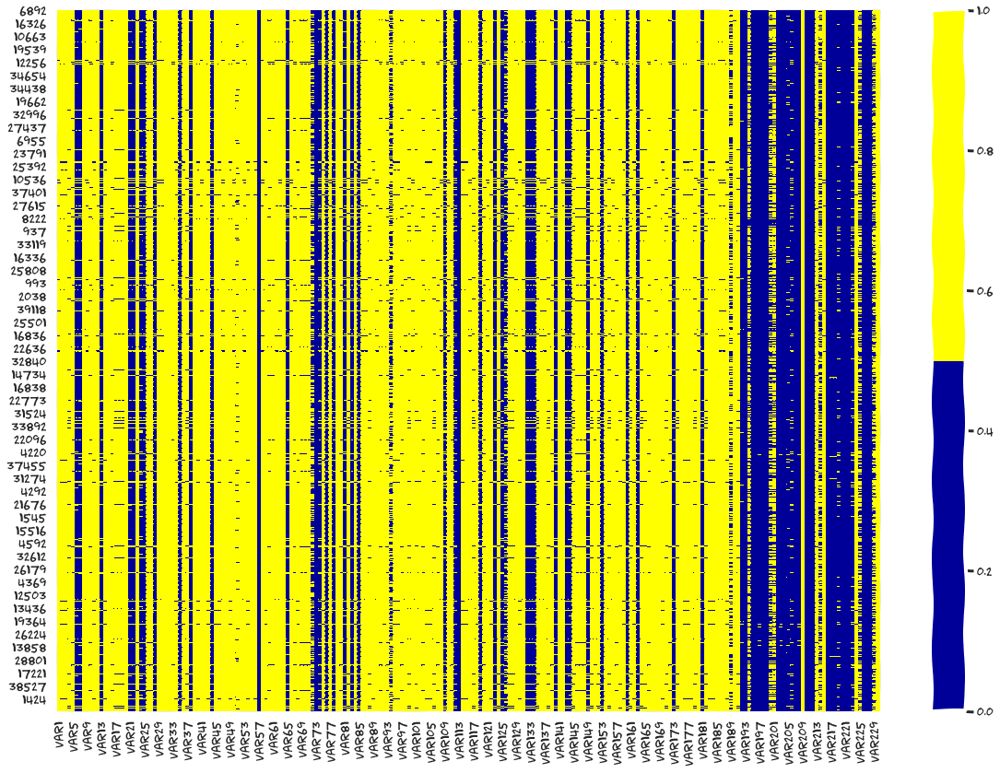

In [9]:
def null_map(data):
    data_to_heat = data.isnull()
    data_to_heat.head()
    with plt.xkcd():
        plt.figure(figsize=(20,14))
        colors = ['#000099', '#ffff00'] 
        sns.heatmap(data_to_heat,cmap = sns.color_palette(colors));
null_map(feats_train)

In [9]:
def feat_classif_clean_nan(data,prop_nan=0.3,len_uniq_num_min=20,len_uniq_min=2):
    
    #Функция первичного отбора (по NaN) и классификации признаков (категориальные или числовые),
    #можем менять допустимую долю NaN - prop_nan, а также пороговые количества уникальных значений
    #Возвращает списки с названиями столбцов
    
    #Обработка числовых признаков
    data_float = data.select_dtypes(include = ['float64'],).copy()
    
    cols_float_cat = []
    cols_float_num = []
    for col in data_float.columns:
        # Удаляем рассмотрения признаки,где доля nan больше prop_nan
        if data[col].dropna().shape[0]/data[col].shape[0] > 1-prop_nan:
            len_unique = np.unique(data[col].dropna()).shape[0]    
            if len_unique <= len_uniq_num_min:#порог для отнесения числового признака к категориальным                
                if len_unique >= len_uniq_min:
                    cols_float_cat.append(col)                            
            else:
                cols_float_num.append(col) 
        
            
    #Обработка нечисловых признаков
    data_not_num = data.select_dtypes(include=['object']).copy()

    cols_cat=[]
    for col in data_not_num.columns.tolist():
        # Удаляем из рассмотрения признаки,где доля nan  больше prop_nan
        if data[col].dropna().shape[0]/data[col].shape[0] > 1-prop_nan:
            len_unique = np.unique(data[col].dropna()).shape[0]
            if len_unique >= len_uniq_min:
                cols_cat.append(col)         
                
    num_columns = cols_float_num+['Var73'] #числовые признаки
    cat_columns = cols_cat+cols_float_cat #категориальные признаки
    
    return num_columns,cat_columns

In [10]:
def fe_cat_clean_too_high_cardinality(data,cat_columns,max_prop_unique=1):    
    #Удаляем неинформативные признаки (слишком много категорий, 
    # доля уникальных из заполненных приближается к max_prop_unique)
    #Возвращает список с названиями столбцов    
    cat_features = data[cat_columns].copy()
    cat_columns_new = []  
    
    for col in cat_columns:        
        level_counts = cat_features[col].value_counts()        
        #Проверяем условие не слишком большого числа категорий (доля от количества объектов - max_prop_unique)
        if level_counts.shape[0]/level_counts.sum() < max_prop_unique:
            cat_columns_new.append(col)#добавляем признак         
    
    return cat_columns_new

In [11]:
def fe_cat_cardinality_classification(data,cat_columns,N_lim=10):
    #Классифицируем категориальные признаки по количеству категорий
     #Возвращает списки с названиями столбцов
    cat_features = data[cat_columns].copy()
    
    low_cardinality_columns = []
    high_cardinality_columns = []
    for col in cat_columns:
        if cat_features[col].unique().shape[0] < N_lim:
            low_cardinality_columns.append(col)
        else:
            high_cardinality_columns.append(col)
            
    return low_cardinality_columns, high_cardinality_columns

In [12]:
def data_preprocessor(data,params):
    #return indices fo each category
    
    data=data.copy()
    [prop_nan,max_prop_unique,N_lim] = params
    
    
    numeric_data_columns,categorical_data_columns0 = feat_classif_clean_nan(data,prop_nan=prop_nan)
    numeric_data_indices = np.array([(column in numeric_data_columns) for column in data.columns], dtype = bool)


    categorical_data_columns = fe_cat_clean_too_high_cardinality(data,categorical_data_columns0,max_prop_unique=max_prop_unique)
    
    low_cardinality_cat_columns ,high_cardinality_cat_columns = fe_cat_cardinality_classification(data,\
                                                                                              categorical_data_columns,N_lim=N_lim)
    low_card_cat_data_indices = np.array([(column in low_cardinality_cat_columns) for column in data.columns], dtype = bool)
    high_card_cat_data_indices = np.array([(column in high_cardinality_cat_columns) for column in data.columns], dtype = bool)
    
    
    indices_lists = [numeric_data_indices,low_card_cat_data_indices,high_card_cat_data_indices]
    return indices_lists

In [13]:
class MyCatMergerNaInputer(BaseEstimator, TransformerMixin):
    
    
    def __init__(self,occurrence_med_prop = 0.2,fill_value='NaN'):
        self.fill_value = fill_value
        self.var_cat_dict = {}
        self.occurrence_med_prop = occurrence_med_prop
        
        
    def fit(self,X,y=None):
        
        df = pd.DataFrame(X)
        df = df.fillna(self.fill_value)
        df = pd.DataFrame(df,dtype=str)
        
        for col in df.columns:
            level_counts = df[col].value_counts()
            lvl_c_median_norm = level_counts/level_counts.median()
            small_cat_list = lvl_c_median_norm[lvl_c_median_norm < self.occurrence_med_prop].index
            self.var_cat_dict[col] = small_cat_list   
       
        return self
    
    
    def transform(self,X,y=None):
        
        df = pd.DataFrame(X)
        df = df.fillna(self.fill_value)
        df = pd.DataFrame(df,dtype=str)
        
        for col in df.columns:
            df[col] = df[col].apply(lambda x: f'{col}_other_cat' if x in self.var_cat_dict[col] else x)
            
        return df.values

In [14]:
def transformation(low_level_transformers,indices_lists):
    [numeric_imputer,numeric_scaler,cat_imputer1,cat_imputer2,\
                low_cardinality_cat_transformer,high_cardinality_cat_transformer] = low_level_transformers
    [numeric_data_indices,low_card_cat_data_indices,high_card_cat_data_indices] = indices_lists
    return pipeline.FeatureUnion(transformer_list =[
    #numeric
    ('numeric_features_processing', pipeline.Pipeline(steps = [
    ('selecting', preprocessing.FunctionTransformer(lambda data: data[:, numeric_data_indices])),
    ('fill_nan',numeric_imputer),
    ('scaling', numeric_scaler)            
                        ])),
    #categorical
    ('cat_features_processing', pipeline.FeatureUnion(transformer_list =[
        #number of categories < N_lim
        ('low_cardinality_transformation', pipeline.Pipeline(steps = [
                ('selecting', preprocessing.FunctionTransformer(lambda data: data[:, low_card_cat_data_indices])),
                ('fill_nan',cat_imputer1 ),
                ('low_cardinality_cat_transformer', low_cardinality_cat_transformer)            
                        ])),
        #number of categories >= N_lim
        ('high_cardinality_transformation', pipeline.Pipeline(steps = [
                ('selecting', preprocessing.FunctionTransformer(lambda data: data[:, high_card_cat_data_indices])),
                ('fill_nan',cat_imputer2 ),
                ('high_cardinality_cat_transformer', high_cardinality_cat_transformer)            
                        ]))
    ]))        
       
])

In [15]:
class Estimator(BaseEstimator, TransformerMixin):
    
    def __init__(self, transformer,classifier):
        self.transformer = transformer
        self.classifier = classifier

    def fit(self, X, y):
        self.transformer.fit(X,y)
        X_tr = self.transformer.transform(X)         
        self.classifier.fit(X_tr,y)
        return self.classifier

    def predict(self, X):
        X_tr = self.transformer.transform(X)        
        return self.classifier.predict(X_tr)
    
    def predict_proba(self,X):
        X_tr = self.transformer.transform(X)        
        return self.classifier.predict_proba(X_tr)

In [16]:
def pr_plot(y_true,probs, thrshs):
    #Функция для визуализации результатов
    
    precisions=[]
    recalls=[]
    thrshs=thrshs
    for threshold in thrshs:
        y_pred = [1 if prob > threshold else -1 for prob in probs[:,1]]
        precisions.append(precision_score(y_true,y_pred))
        recalls.append(recall_score(y_true,y_pred))

    
    plt.plot(thrshs, precisions,label='precision');    
    plt.plot(thrshs, recalls,label='recall');   
    plt.xlabel('threshold')
    plt.legend()
    plt.title('Зависимость значений метрик от порога')
    plt.grid(True)
    plt.ylabel('metric');

In [17]:
def write_to_submission_file(predicted_labels, out_file,
                             target='result', index_label="Id"):
    # turn predictions into data frame and save as csv file
    predicted_df = pd.DataFrame(predicted_labels,
                                index = np.arange(0, predicted_labels.shape[0]),
                                columns=[target])
    predicted_df.to_csv(out_file, index_label=index_label)

In [18]:
def cat_prep(data,cat_columns):
  data = data.copy()  
  for col in cat_columns:
    data[col] = data[col].astype(str)
  return data  

In [ ]:
#Индексы значемых признаков полсле предобработки
indices_lists = data_preprocessor(feats_train,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]


#Заполнение пропущенных значений
#Числовые признаки
numeric_imputer = impute.SimpleImputer()#по умолчанию заполняется средними значениями
numeric_scaler = None

#Категориальные признаки
occurrence_med_prop = 0.1#доля размера категории от медианного значения для признака для дальнейшего объединения таких категорий в одну
cat_imputer1 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')
cat_imputer2 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')

#Методы обработки категориальных признаков
(low_cardinality_cat_transformer1,high_cardinality_cat_transformer1) = (preprocessing.OneHotEncoder(handle_unknown = 'ignore'),
                                                                        preprocessing.OneHotEncoder(handle_unknown = 'ignore'))
                                                                        
#Список трансформеров низкого уровня                                                                      
low_level_transformers = [numeric_imputer,numeric_scaler,cat_imputer1,cat_imputer2,\
                low_cardinality_cat_transformer1,high_cardinality_cat_transformer1]
#Итоговый трансформер
transformer = transformation(low_level_transformers,indices_lists)

In [ ]:
#Классификатор и итоговый алгоритм
clf = xgb.XGBClassifier(random_state=42,n_estimators=100,gamma=0.1,max_depth=3,reg_alpha=1,min_child_weight=1)
    
estimator = Estimator(transformer,clf)

ROC AUC: 0.7378596430063221
PRC AUC: 0.2077076585475081
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     11107
           1       0.55      0.01      0.02       893

    accuracy                           0.93     12000
   macro avg       0.74      0.51      0.49     12000
weighted avg       0.90      0.93      0.89     12000

------------------
------------------


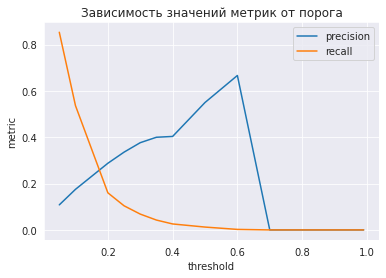

In [ ]:
warnings.filterwarnings('ignore')

estimator.fit(feats_train.values,labels_train.values)

prb = estimator.predict_proba(feats_val.values)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator.predict(feats_val.values)
print(classification_report(labels_val.values,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [20]:
#Индексы значимых признаков полсле предобработки
[num_inds, cat_indices1,cat_indices2]= data_preprocessor(feats_train,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]

In [21]:
cat_columns = list(np.array(features.columns)[cat_indices1]) + list(np.array(features.columns)[cat_indices2])
print(cat_columns)

['Var7', 'Var35', 'Var44', 'Var65', 'Var72', 'Var78', 'Var132', 'Var143', 'Var144', 'Var173', 'Var181', 'Var195', 'Var196', 'Var203', 'Var205', 'Var206', 'Var207', 'Var208', 'Var210', 'Var211', 'Var218', 'Var219', 'Var221', 'Var223', 'Var225', 'Var226', 'Var227', 'Var229', 'Var192', 'Var193', 'Var197', 'Var198', 'Var199', 'Var202', 'Var204', 'Var212', 'Var216', 'Var217', 'Var220', 'Var222', 'Var228']


In [22]:
num_columns = list(np.array(features.columns)[num_inds])
print(num_columns)

['Var6', 'Var13', 'Var21', 'Var22', 'Var24', 'Var25', 'Var28', 'Var38', 'Var57', 'Var73', 'Var74', 'Var76', 'Var81', 'Var83', 'Var85', 'Var94', 'Var109', 'Var112', 'Var113', 'Var119', 'Var123', 'Var125', 'Var126', 'Var133', 'Var134', 'Var140', 'Var149', 'Var153', 'Var160', 'Var163', 'Var189']


In [23]:
good_columns = num_columns + cat_columns

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=500,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

In [ ]:
estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 136ms	remaining: 1m 7s
10:	learn: 0.5710723	test: 0.5727358	best: 0.5727358 (10)	total: 899ms	remaining: 40s
20:	learn: 0.5846300	test: 0.5855039	best: 0.5855039 (20)	total: 1.65s	remaining: 37.6s
30:	learn: 0.6770678	test: 0.6701294	best: 0.6701294 (30)	total: 2.45s	remaining: 37s
40:	learn: 0.7173511	test: 0.7078972	best: 0.7078972 (40)	total: 3.29s	remaining: 36.9s
50:	learn: 0.7262440	test: 0.7148843	best: 0.7148843 (50)	total: 4.15s	remaining: 36.5s
60:	learn: 0.7315806	test: 0.7184889	best: 0.7185946 (57)	total: 5.03s	remaining: 36.2s
70:	learn: 0.7366703	test: 0.7222066	best: 0.7223936 (67)	total: 5.9s	remaining: 35.7s
80:	learn: 0.7419034	test: 0.7254476	best: 0.7257717 (79)	total: 6.76s	remaining: 35s
90:	learn: 0.7466782	test: 0.7281565	best: 0.7283261 (89)	total: 7.57s	remaining: 34s
100:	learn: 0.7488860	test: 0.7292999	best: 0.7293321 (99)	total: 8.47s	remaining: 33.5s
110:	learn: 0.7522508	test: 0.7307438	best

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

In [ ]:
estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb1.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5824234	total: 56.3ms	remaining: 21.3s
10:	learn: 0.5792802	total: 556ms	remaining: 18.7s
20:	learn: 0.6006237	total: 998ms	remaining: 17.1s
30:	learn: 0.6604410	total: 1.42s	remaining: 16s
40:	learn: 0.7027496	total: 1.88s	remaining: 15.5s
50:	learn: 0.7147275	total: 2.31s	remaining: 14.9s
60:	learn: 0.7282001	total: 2.8s	remaining: 14.6s
70:	learn: 0.7408890	total: 3.26s	remaining: 14.2s
80:	learn: 0.7498578	total: 3.73s	remaining: 13.8s
90:	learn: 0.7558098	total: 4.21s	remaining: 13.4s
100:	learn: 0.7601608	total: 4.67s	remaining: 12.9s
110:	learn: 0.7626576	total: 5.16s	remaining: 12.5s
120:	learn: 0.7670048	total: 5.62s	remaining: 12s
130:	learn: 0.7694613	total: 6.08s	remaining: 11.6s
140:	learn: 0.7733936	total: 6.54s	remaining: 11.1s
150:	learn: 0.7751738	total: 7.01s	remaining: 10.6s
160:	learn: 0.7777317	total: 7.46s	remaining: 10.1s
170:	learn: 0.7794589	total: 7.92s	remaining: 9.68s
180:	learn: 0.7819069	total: 8.39s	remaining: 9.22s
190:	learn: 0.7843453	total

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 134ms	remaining: 51s
10:	learn: 0.5710723	test: 0.5727358	best: 0.5727358 (10)	total: 880ms	remaining: 29.5s
20:	learn: 0.5846300	test: 0.5855039	best: 0.5855039 (20)	total: 1.62s	remaining: 27.7s
30:	learn: 0.6770678	test: 0.6701294	best: 0.6701294 (30)	total: 2.42s	remaining: 27.2s
40:	learn: 0.7173511	test: 0.7078972	best: 0.7078972 (40)	total: 3.26s	remaining: 27s
50:	learn: 0.7262440	test: 0.7148843	best: 0.7148843 (50)	total: 4.09s	remaining: 26.4s
60:	learn: 0.7315806	test: 0.7184889	best: 0.7185946 (57)	total: 4.98s	remaining: 26.1s
70:	learn: 0.7366703	test: 0.7222066	best: 0.7223936 (67)	total: 5.87s	remaining: 25.5s
80:	learn: 0.7419034	test: 0.7254476	best: 0.7257717 (79)	total: 6.71s	remaining: 24.8s
90:	learn: 0.7466782	test: 0.7281565	best: 0.7283261 (89)	total: 7.51s	remaining: 23.9s
100:	learn: 0.7488860	test: 0.7292999	best: 0.7293321 (99)	total: 8.39s	remaining: 23.2s
110:	learn: 0.7522508	test: 0.7307438

In [ ]:
estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb2.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 106ms	remaining: 40.2s
10:	learn: 0.5781668	total: 977ms	remaining: 32.8s
20:	learn: 0.5862285	total: 1.75s	remaining: 29.9s
30:	learn: 0.6401380	total: 2.52s	remaining: 28.4s
40:	learn: 0.6948748	total: 3.31s	remaining: 27.4s
50:	learn: 0.7169213	total: 4.13s	remaining: 26.7s
60:	learn: 0.7254314	total: 4.89s	remaining: 25.6s
70:	learn: 0.7303921	total: 5.65s	remaining: 24.6s
80:	learn: 0.7370947	total: 6.46s	remaining: 23.9s
90:	learn: 0.7401665	total: 7.27s	remaining: 23.1s
100:	learn: 0.7447180	total: 8.07s	remaining: 22.3s
110:	learn: 0.7480026	total: 8.89s	remaining: 21.6s
120:	learn: 0.7501602	total: 9.68s	remaining: 20.7s
130:	learn: 0.7515897	total: 10.5s	remaining: 19.9s
140:	learn: 0.7535840	total: 11.3s	remaining: 19.1s
150:	learn: 0.7543607	total: 12.1s	remaining: 18.3s
160:	learn: 0.7553576	total: 12.9s	remaining: 17.5s
170:	learn: 0.7567571	total: 13.7s	remaining: 16.7s
180:	learn: 0.7576030	total: 14.4s	remaining: 15.9s
190:	learn: 0.7584188	t

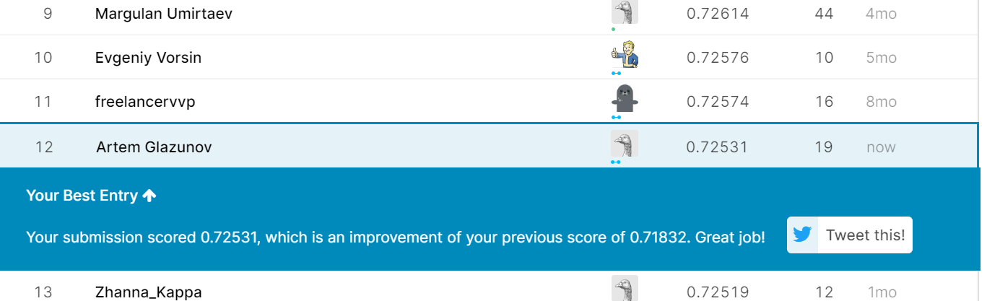

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bayesian',
                                  bagging_temperature=1,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5152289	test: 0.5102524	best: 0.5102524 (0)	total: 140ms	remaining: 53.2s
10:	learn: 0.5707900	test: 0.5767617	best: 0.5782275 (4)	total: 893ms	remaining: 30s
20:	learn: 0.5797552	test: 0.5831602	best: 0.5831602 (20)	total: 1.62s	remaining: 27.7s
30:	learn: 0.6400428	test: 0.6383710	best: 0.6383710 (30)	total: 2.38s	remaining: 26.8s
40:	learn: 0.7061993	test: 0.6974573	best: 0.6974573 (40)	total: 3.21s	remaining: 26.5s
50:	learn: 0.7128442	test: 0.7033105	best: 0.7033105 (50)	total: 3.98s	remaining: 25.7s
60:	learn: 0.7233586	test: 0.7124535	best: 0.7124535 (60)	total: 4.83s	remaining: 25.2s
70:	learn: 0.7312139	test: 0.7175669	best: 0.7175669 (70)	total: 5.64s	remaining: 24.5s
80:	learn: 0.7337432	test: 0.7182906	best: 0.7182906 (80)	total: 6.47s	remaining: 23.9s
90:	learn: 0.7364989	test: 0.7190194	best: 0.7190194 (90)	total: 7.27s	remaining: 23.1s
100:	learn: 0.7438051	test: 0.7246304	best: 0.7246304 (100)	total: 8.11s	remaining: 22.4s
110:	learn: 0.7456093	test: 0.72627

In [ ]:
estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb4.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5674290	total: 108ms	remaining: 41s
10:	learn: 0.5739045	total: 891ms	remaining: 29.9s
20:	learn: 0.5783136	total: 1.61s	remaining: 27.5s
30:	learn: 0.6362925	total: 2.35s	remaining: 26.5s
40:	learn: 0.6933148	total: 3.07s	remaining: 25.4s
50:	learn: 0.7102132	total: 3.88s	remaining: 25s
60:	learn: 0.7222548	total: 4.72s	remaining: 24.7s
70:	learn: 0.7263156	total: 5.54s	remaining: 24.1s
80:	learn: 0.7320451	total: 6.32s	remaining: 23.3s
90:	learn: 0.7333564	total: 7.12s	remaining: 22.6s
100:	learn: 0.7374036	total: 7.93s	remaining: 21.9s
110:	learn: 0.7411875	total: 8.77s	remaining: 21.2s
120:	learn: 0.7431314	total: 9.55s	remaining: 20.4s
130:	learn: 0.7448965	total: 10.3s	remaining: 19.6s
140:	learn: 0.7473896	total: 11.1s	remaining: 18.8s
150:	learn: 0.7481652	total: 11.9s	remaining: 18s
160:	learn: 0.7486160	total: 12.6s	remaining: 17.2s
170:	learn: 0.7495404	total: 13.5s	remaining: 16.4s
180:	learn: 0.7505172	total: 14.2s	remaining: 15.6s
190:	learn: 0.7511965	total: 

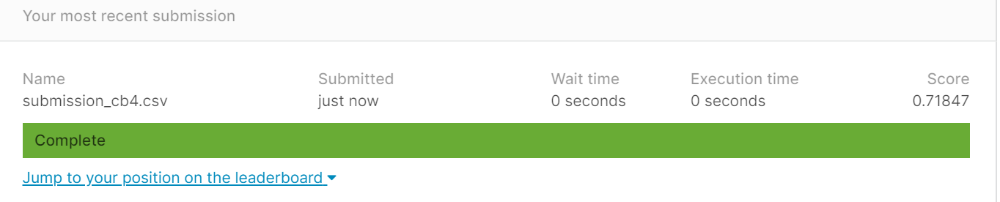

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=504,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.04,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 142ms	remaining: 1m 11s
10:	learn: 0.5708398	test: 0.5721746	best: 0.5762741 (4)	total: 873ms	remaining: 39.1s
20:	learn: 0.5729061	test: 0.5793588	best: 0.5793588 (20)	total: 1.6s	remaining: 36.8s
30:	learn: 0.5752570	test: 0.5782732	best: 0.5793588 (20)	total: 2.34s	remaining: 35.6s
40:	learn: 0.5784188	test: 0.5819761	best: 0.5819761 (40)	total: 3.13s	remaining: 35.3s
50:	learn: 0.5976739	test: 0.5986293	best: 0.5986293 (50)	total: 3.89s	remaining: 34.6s
60:	learn: 0.6605894	test: 0.6573376	best: 0.6573376 (60)	total: 4.64s	remaining: 33.7s
70:	learn: 0.6971366	test: 0.6925094	best: 0.6925094 (70)	total: 5.49s	remaining: 33.5s
80:	learn: 0.7124468	test: 0.7041591	best: 0.7041591 (80)	total: 6.3s	remaining: 32.9s
90:	learn: 0.7182024	test: 0.7084746	best: 0.7084746 (90)	total: 7.14s	remaining: 32.4s
100:	learn: 0.7230836	test: 0.7121795	best: 0.7121795 (100)	total: 7.93s	remaining: 31.6s
110:	learn: 0.7272401	test: 0.7151

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=446,random_state=0,
                                  eval_metric = 'AUC',
                                  depth=7,
                                  learning_rate=0.04,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 154ms	remaining: 1m 8s
10:	learn: 0.5704298	test: 0.5709307	best: 0.5710093 (9)	total: 1.16s	remaining: 45.7s
20:	learn: 0.5699875	test: 0.5744098	best: 0.5759337 (16)	total: 2.02s	remaining: 40.9s
30:	learn: 0.5742719	test: 0.5760092	best: 0.5763202 (29)	total: 2.93s	remaining: 39.2s
40:	learn: 0.5761983	test: 0.5776572	best: 0.5787051 (38)	total: 3.82s	remaining: 37.7s
50:	learn: 0.5934804	test: 0.5895339	best: 0.5895339 (50)	total: 4.66s	remaining: 36.1s
60:	learn: 0.6559763	test: 0.6537890	best: 0.6537890 (60)	total: 5.75s	remaining: 36.3s
70:	learn: 0.6972478	test: 0.6934958	best: 0.6934958 (70)	total: 6.88s	remaining: 36.3s
80:	learn: 0.7119675	test: 0.7052441	best: 0.7052441 (80)	total: 7.92s	remaining: 35.7s
90:	learn: 0.7193804	test: 0.7101532	best: 0.7101532 (90)	total: 9.02s	remaining: 35.2s
100:	learn: 0.7298220	test: 0.7177342	best: 0.7177342 (100)	total: 10.2s	remaining: 34.9s
110:	learn: 0.7331260	test: 0.720

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=446,random_state=0,
                                  eval_metric = 'AUC',
                                  depth=10,
                                  learning_rate=0.04,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 92.5ms	remaining: 41.2s
10:	learn: 0.5706185	test: 0.5556193	best: 0.5671717 (4)	total: 1.27s	remaining: 50.3s
20:	learn: 0.5697958	test: 0.5757648	best: 0.5757648 (20)	total: 2.67s	remaining: 54.1s
30:	learn: 0.5744148	test: 0.5768476	best: 0.5768476 (30)	total: 4.8s	remaining: 1m 4s
40:	learn: 0.5790444	test: 0.5782141	best: 0.5782141 (40)	total: 6.27s	remaining: 1m 1s
50:	learn: 0.5921847	test: 0.5888987	best: 0.5888987 (50)	total: 8.02s	remaining: 1m 2s
60:	learn: 0.6445189	test: 0.6380194	best: 0.6380194 (60)	total: 10.7s	remaining: 1m 7s
70:	learn: 0.6835760	test: 0.6749506	best: 0.6749506 (70)	total: 14.2s	remaining: 1m 15s
80:	learn: 0.7089992	test: 0.6980618	best: 0.6981046 (79)	total: 17.8s	remaining: 1m 20s
90:	learn: 0.7251012	test: 0.7106932	best: 0.7106932 (90)	total: 22.1s	remaining: 1m 26s
100:	learn: 0.7306885	test: 0.7155408	best: 0.7155408 (100)	total: 25s	remaining: 1m 25s
110:	learn: 0.7335423	test: 0.7

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=400,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.04,
                                  depth=10,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb5.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 92.2ms	remaining: 36.8s
10:	learn: 0.5734318	total: 1.94s	remaining: 1m 8s
20:	learn: 0.5742779	total: 3.47s	remaining: 1m 2s
30:	learn: 0.5801413	total: 5.71s	remaining: 1m 8s
40:	learn: 0.5850573	total: 6.8s	remaining: 59.5s
50:	learn: 0.5888993	total: 9.06s	remaining: 1m 1s
60:	learn: 0.6495255	total: 11.2s	remaining: 1m 2s
70:	learn: 0.6734518	total: 13.1s	remaining: 1m
80:	learn: 0.6966035	total: 16.6s	remaining: 1m 5s
90:	learn: 0.7040054	total: 19.7s	remaining: 1m 6s
100:	learn: 0.7144088	total: 23.3s	remaining: 1m 8s
110:	learn: 0.7202201	total: 25.6s	remaining: 1m 6s
120:	learn: 0.7253250	total: 28.1s	remaining: 1m 4s
130:	learn: 0.7300747	total: 31.1s	remaining: 1m 3s
140:	learn: 0.7323713	total: 34s	remaining: 1m 2s
150:	learn: 0.7352472	total: 36.4s	remaining: 1m
160:	learn: 0.7395209	total: 38.6s	remaining: 57.3s
170:	learn: 0.7423800	total: 42.3s	remaining: 56.7s
180:	learn: 0.7437104	total: 45s	remaining: 54.4s
190:	learn: 0.7452051	total: 48.1

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=446,random_state=0,
                                  eval_metric = 'AUC',
                                  depth=7,
                                  auto_class_weights = 'Balanced',
                                  learning_rate=0.04,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6007290	test: 0.5852576	best: 0.5852576 (0)	total: 220ms	remaining: 1m 37s
10:	learn: 0.7103574	test: 0.6983496	best: 0.6983496 (10)	total: 1.37s	remaining: 54.2s
20:	learn: 0.7174943	test: 0.7081704	best: 0.7081704 (20)	total: 2.44s	remaining: 49.5s
30:	learn: 0.7247680	test: 0.7146030	best: 0.7146030 (30)	total: 3.43s	remaining: 45.9s
40:	learn: 0.7292818	test: 0.7185826	best: 0.7187523 (39)	total: 4.46s	remaining: 44.1s
50:	learn: 0.7329651	test: 0.7211073	best: 0.7211073 (50)	total: 5.49s	remaining: 42.6s
60:	learn: 0.7357433	test: 0.7215050	best: 0.7215050 (60)	total: 6.49s	remaining: 40.9s
70:	learn: 0.7399853	test: 0.7242538	best: 0.7242538 (70)	total: 7.53s	remaining: 39.8s
80:	learn: 0.7411895	test: 0.7249576	best: 0.7251056 (79)	total: 8.4s	remaining: 37.8s
90:	learn: 0.7428066	test: 0.7255858	best: 0.7255858 (90)	total: 9.46s	remaining: 36.9s
100:	learn: 0.7434371	test: 0.7259392	best: 0.7259687 (93)	total: 10.5s	remaining: 35.8s
110:	learn: 0.7446579	test: 0.726

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=446,random_state=0,
                                  eval_metric = 'AUC',
                                  depth=7,
                                  auto_class_weights = 'SqrtBalanced',
                                  learning_rate=0.04,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 155ms	remaining: 1m 8s
10:	learn: 0.5725548	test: 0.5789314	best: 0.5793024 (6)	total: 1.14s	remaining: 45.1s
20:	learn: 0.5818743	test: 0.5860016	best: 0.5862949 (19)	total: 2.02s	remaining: 41s
30:	learn: 0.5890361	test: 0.5899971	best: 0.5905760 (28)	total: 2.97s	remaining: 39.7s
40:	learn: 0.6471462	test: 0.6413738	best: 0.6413738 (40)	total: 3.92s	remaining: 38.8s
50:	learn: 0.6854489	test: 0.6788197	best: 0.6788197 (50)	total: 4.9s	remaining: 37.9s
60:	learn: 0.7048196	test: 0.6968263	best: 0.6968263 (60)	total: 5.88s	remaining: 37.1s
70:	learn: 0.7193882	test: 0.7082835	best: 0.7082835 (70)	total: 6.95s	remaining: 36.7s
80:	learn: 0.7227406	test: 0.7109630	best: 0.7109630 (80)	total: 7.73s	remaining: 34.8s
90:	learn: 0.7269660	test: 0.7135507	best: 0.7135507 (90)	total: 8.87s	remaining: 34.6s
100:	learn: 0.7327666	test: 0.7177502	best: 0.7177502 (100)	total: 9.98s	remaining: 34.1s
110:	learn: 0.7358003	test: 0.718957

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=446,random_state=0,
                                  eval_metric = 'AUC',
                                  depth=7,
                                  auto_class_weights = 'SqrtBalanced',
                                  learning_rate=0.06,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb6.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5775378	total: 107ms	remaining: 47.6s
10:	learn: 0.5792089	total: 1.14s	remaining: 45.2s
20:	learn: 0.5915175	total: 2.23s	remaining: 45.2s
30:	learn: 0.6646564	total: 3.14s	remaining: 42.1s
40:	learn: 0.6993670	total: 4.12s	remaining: 40.7s
50:	learn: 0.7130793	total: 5.2s	remaining: 40.3s
60:	learn: 0.7231656	total: 6.34s	remaining: 40s
70:	learn: 0.7303654	total: 7.33s	remaining: 38.7s
80:	learn: 0.7357491	total: 8.29s	remaining: 37.4s
90:	learn: 0.7399889	total: 9.45s	remaining: 36.9s
100:	learn: 0.7420878	total: 10.4s	remaining: 35.6s
110:	learn: 0.7444582	total: 11.4s	remaining: 34.4s
120:	learn: 0.7465216	total: 12.5s	remaining: 33.6s
130:	learn: 0.7483014	total: 13.6s	remaining: 32.8s
140:	learn: 0.7489046	total: 14.7s	remaining: 31.7s
150:	learn: 0.7498923	total: 15.7s	remaining: 30.6s
160:	learn: 0.7506512	total: 16.7s	remaining: 29.5s
170:	learn: 0.7518513	total: 17.7s	remaining: 28.5s
180:	learn: 0.7526207	total: 18.6s	remaining: 27.2s
190:	learn: 0.7527296	tota

In [ ]:
train_pool = Pool(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns)

In [ ]:
np.array(estimator_cb.get_feature_importance(prettified=True))

array([['Var126', 47.530504467969386],
       ['Var217', 10.307294571038822],
       ['Var199', 5.557447795485032],
       ['Var73', 4.561552195885621],
       ['Var202', 3.923420518352015],
       ['Var189', 3.6619198990014374],
       ['Var81', 3.2504747506335407],
       ['Var113', 3.121904815347451],
       ['Var74', 2.58657178757639],
       ['Var206', 2.5194717010854264],
       ['Var7', 1.9520657501141139],
       ['Var205', 1.9346772124471632],
       ['Var192', 1.4923331173833794],
       ['Var212', 1.2267756887671426],
       ['Var193', 0.9522770799252476],
       ['Var228', 0.7798236130054602],
       ['Var197', 0.7722518135341467],
       ['Var216', 0.6653547074413615],
       ['Var229', 0.40226857454124365],
       ['Var210', 0.3136759715762227],
       ['Var227', 0.2823840627090325],
       ['Var153', 0.2636498198344613],
       ['Var221', 0.234910294787656],
       ['Var22', 0.19751909181550611],
       ['Var207', 0.19052139035107957],
       ['Var65', 0.1668262206131948

In [ ]:
np.array(estimator_cb.get_feature_importance(train_pool,'LossFunctionChange', prettified=True))

array([['Var126', 0.02744540897295049],
       ['Var81', 0.002384751623316861],
       ['Var113', 0.0023596435340573763],
       ['Var189', 0.001938884958334281],
       ['Var205', 0.00173296711814791],
       ['Var73', 0.0017154149975616485],
       ['Var65', 0.0005392523596149612],
       ['Var218', 0.00036017676911848096],
       ['Var210', 0.000278318955126422],
       ['Var227', 0.00024352358423262999],
       ['Var229', 0.00023956504157052194],
       ['Var132', 0.0002166787858081387],
       ['Var22', 0.00017967528131224153],
       ['Var221', 0.0001343242280869017],
       ['Var163', 8.318380877647691e-05],
       ['Var38', 1.2323626652488429e-05],
       ['Var24', 4.40187845018869e-06],
       ['Var83', 3.894085077504883e-06],
       ['Var143', 1.0266975488115726e-06],
       ['Var123', 9.415905340981467e-07],
       ['Var85', 2.4033252654653836e-07],
       ['Var6', 0.0],
       ['Var13', 0.0],
       ['Var21', 0.0],
       ['Var25', 0.0],
       ['Var57', 0.0],
       ['Var7

In [ ]:
cat_columns2 = cat_columns.copy()
for var in ['Var212','Var202','Var206','Var217','Var199']:
  cat_columns2.remove(var)
len(cat_columns2),len(cat_columns)

(36, 41)

In [ ]:
good_columns2 = num_columns + cat_columns2

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns2],cat_columns2),labels_train, cat_features = cat_columns2,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns2],cat_columns2), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5153817	test: 0.5109755	best: 0.5109755 (0)	total: 87.7ms	remaining: 33.2s
10:	learn: 0.5562226	test: 0.5601440	best: 0.5601440 (10)	total: 806ms	remaining: 27s
20:	learn: 0.5577632	test: 0.5623659	best: 0.5624653 (19)	total: 1.51s	remaining: 25.8s
30:	learn: 0.6542436	test: 0.6420541	best: 0.6420541 (30)	total: 2.29s	remaining: 25.8s
40:	learn: 0.7024047	test: 0.6920700	best: 0.6920700 (40)	total: 3.06s	remaining: 25.3s
50:	learn: 0.7169058	test: 0.7050055	best: 0.7050055 (50)	total: 3.91s	remaining: 25.2s
60:	learn: 0.7241767	test: 0.7119759	best: 0.7119759 (60)	total: 4.72s	remaining: 24.7s
70:	learn: 0.7284560	test: 0.7148308	best: 0.7148308 (70)	total: 5.53s	remaining: 24s
80:	learn: 0.7359103	test: 0.7206493	best: 0.7206493 (80)	total: 6.3s	remaining: 23.3s
90:	learn: 0.7409043	test: 0.7229093	best: 0.7229093 (90)	total: 7.12s	remaining: 22.6s
100:	learn: 0.7437638	test: 0.7251222	best: 0.7251824 (98)	total: 7.96s	remaining: 22s
110:	learn: 0.7470413	test: 0.7262711	b

In [ ]:
estimator_cb.fit(cat_prep(features[good_columns2],cat_columns2), labels, cat_features = cat_columns2,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns2],cat_columns2))
write_to_submission_file(probs[:,1],out_file='submission_cb7.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5412246	total: 82.4ms	remaining: 31.2s
10:	learn: 0.5531063	total: 797ms	remaining: 26.7s
20:	learn: 0.5589820	total: 1.51s	remaining: 25.8s
30:	learn: 0.6301104	total: 2.21s	remaining: 24.8s
40:	learn: 0.6961288	total: 2.99s	remaining: 24.7s
50:	learn: 0.7127787	total: 3.74s	remaining: 24.2s
60:	learn: 0.7224343	total: 4.54s	remaining: 23.7s
70:	learn: 0.7275994	total: 5.37s	remaining: 23.4s
80:	learn: 0.7310714	total: 6.12s	remaining: 22.6s
90:	learn: 0.7351380	total: 6.9s	remaining: 21.9s
100:	learn: 0.7384093	total: 7.68s	remaining: 21.2s
110:	learn: 0.7414550	total: 8.49s	remaining: 20.6s
120:	learn: 0.7431847	total: 9.27s	remaining: 19.8s
130:	learn: 0.7458488	total: 10.1s	remaining: 19.1s
140:	learn: 0.7479162	total: 10.8s	remaining: 18.3s
150:	learn: 0.7493381	total: 11.6s	remaining: 17.6s
160:	learn: 0.7501817	total: 12.3s	remaining: 16.8s
170:	learn: 0.7508208	total: 13.1s	remaining: 16s
180:	learn: 0.7518307	total: 13.8s	remaining: 15.2s
190:	learn: 0.7525224	tot

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 96.5ms	remaining: 36.6s
10:	learn: 0.5710723	test: 0.5727358	best: 0.5727358 (10)	total: 857ms	remaining: 28.7s
20:	learn: 0.5846300	test: 0.5855039	best: 0.5855039 (20)	total: 1.65s	remaining: 28.3s
30:	learn: 0.6770678	test: 0.6701294	best: 0.6701294 (30)	total: 2.47s	remaining: 27.8s
40:	learn: 0.7173511	test: 0.7078972	best: 0.7078972 (40)	total: 3.37s	remaining: 27.8s
50:	learn: 0.7262440	test: 0.7148843	best: 0.7148843 (50)	total: 4.24s	remaining: 27.4s
60:	learn: 0.7315806	test: 0.7184889	best: 0.7185946 (57)	total: 5.12s	remaining: 26.8s
70:	learn: 0.7366703	test: 0.7222066	best: 0.7223936 (67)	total: 5.99s	remaining: 26.1s
80:	learn: 0.7419034	test: 0.7254476	best: 0.7257717 (79)	total: 6.89s	remaining: 25.4s
90:	learn: 0.7466782	test: 0.7281565	best: 0.7283261 (89)	total: 7.72s	remaining: 24.5s
100:	learn: 0.7488860	test: 0.7292999	best: 0.7293321 (99)	total: 8.63s	remaining: 23.8s
110:	learn: 0.7522508	test: 0.73

In [ ]:

train_pool = Pool(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns)
np.array(estimator_cb.get_feature_importance(train_pool,'LossFunctionChange', prettified=True))

array([['Var126', 0.010024201668431524],
       ['Var189', 0.0013942264248186557],
       ['Var113', 0.0010710856048719852],
       ['Var205', 0.0010180821630570343],
       ['Var218', 0.0009153584653482372],
       ['Var73', 0.0007406078610784165],
       ['Var81', 0.0006467163946333732],
       ['Var7', 0.00043778510848130336],
       ['Var74', 0.0004341491266758637],
       ['Var210', 0.000412991734865531],
       ['Var229', 0.00040290717966234846],
       ['Var228', 0.00036472501119487005],
       ['Var227', 0.000263829562905595],
       ['Var226', 0.00015396149885077887],
       ['Var28', 7.070645847293926e-05],
       ['Var6', 4.118281413373337e-05],
       ['Var195', 3.351086565972494e-05],
       ['Var57', 3.3187765988651474e-05],
       ['Var22', 2.9433429972525182e-05],
       ['Var13', 1.0434922235347255e-05],
       ['Var153', 1.005580138302431e-05],
       ['Var132', 9.405601493928106e-06],
       ['Var223', 8.770249852574352e-06],
       ['Var85', 5.538518083159083e-06],


In [ ]:
cat_columns2 = cat_columns.copy()
for var in ['Var199','Var217']:
  cat_columns2.remove(var)
good_columns2 = num_columns + cat_columns2 

estimator_cb = CatBoostClassifier(task_type='GPU',iterations=200,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(cat_prep(features[good_columns2],cat_columns2), labels, cat_features = cat_columns2,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns2],cat_columns2))
write_to_submission_file(probs[:,1],out_file='submission_cb8.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5080304	total: 74ms	remaining: 14.7s
10:	learn: 0.5556120	total: 838ms	remaining: 14.4s
20:	learn: 0.5598488	total: 1.59s	remaining: 13.6s
30:	learn: 0.6327914	total: 2.34s	remaining: 12.7s
40:	learn: 0.6817296	total: 3.13s	remaining: 12.1s
50:	learn: 0.7132914	total: 3.98s	remaining: 11.6s
60:	learn: 0.7185804	total: 4.84s	remaining: 11s
70:	learn: 0.7271850	total: 5.65s	remaining: 10.3s
80:	learn: 0.7320981	total: 6.47s	remaining: 9.51s
90:	learn: 0.7356150	total: 7.36s	remaining: 8.82s
100:	learn: 0.7396625	total: 8.17s	remaining: 8.01s
110:	learn: 0.7440588	total: 9.02s	remaining: 7.23s
120:	learn: 0.7458944	total: 9.84s	remaining: 6.43s
130:	learn: 0.7482274	total: 10.6s	remaining: 5.6s
140:	learn: 0.7504014	total: 11.4s	remaining: 4.78s
150:	learn: 0.7512612	total: 12.2s	remaining: 3.94s
160:	learn: 0.7520340	total: 12.9s	remaining: 3.13s
170:	learn: 0.7528192	total: 13.7s	remaining: 2.33s
180:	learn: 0.7535923	total: 14.5s	remaining: 1.52s
190:	learn: 0.7550347	total

In [ ]:
sub_names = ['submission_cb1','submission_cb2','submission_cb3','submission_cb4','submission_cb5','submission_cb6','submission_cb7',
             'submission_cb8','submission3','submission4','submission5','submission6','submission7','submission8','submission9','submission_final']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df.head()

,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result
Id,,,,,,,,,,,,,,,,
0,0.092013,0.080946,0.081988,0.081819,0.082297,0.245850,0.063512,0.067114,0.064954,0.033749,0.466653,0.263725,0.106894,0.063221,0.060926,0.060926
1,0.108802,0.112910,0.111290,0.096106,0.098092,0.282603,0.112622,0.093682,0.117818,0.056393,0.594583,0.411401,0.098931,0.105554,0.108696,0.108696
2,0.019675,0.020165,0.020478,0.021503,0.020924,0.070057,0.024609,0.026490,0.028061,0.012662,0.240480,0.142153,0.033888,0.023810,0.025996,0.025996
3,0.060231,0.066768,0.060720,0.053580,0.068739,0.212873,0.077320,0.082234,0.078644,0.044644,0.510958,0.326529,0.126811,0.083559,0.082151,0.082151
4,0.027637,0.022772,0.023751,0.024252,0.026784,0.092238,0.029508,0.034319,0.021621,0.012318,0.152059,0.101077,0.032756,0.021486,0.023285,0.023285


In [ ]:
sub_df['mean'] = sub_df.mean(axis=1)
sub_df.head()

,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,mean
Id,,,,,,,,,,,,,,,,,
0,0.092013,0.080946,0.081988,0.081819,0.082297,0.245850,0.063512,0.067114,0.064954,0.033749,0.466653,0.263725,0.106894,0.063221,0.060926,0.060926,0.119787
1,0.108802,0.112910,0.111290,0.096106,0.098092,0.282603,0.112622,0.093682,0.117818,0.056393,0.594583,0.411401,0.098931,0.105554,0.108696,0.108696,0.163636
2,0.019675,0.020165,0.020478,0.021503,0.020924,0.070057,0.024609,0.026490,0.028061,0.012662,0.240480,0.142153,0.033888,0.023810,0.025996,0.025996,0.047309
3,0.060231,0.066768,0.060720,0.053580,0.068739,0.212873,0.077320,0.082234,0.078644,0.044644,0.510958,0.326529,0.126811,0.083559,0.082151,0.082151,0.126120
4,0.027637,0.022772,0.023751,0.024252,0.026784,0.092238,0.029508,0.034319,0.021621,0.012318,0.152059,0.101077,0.032756,0.021486,0.023285,0.023285,0.041822


In [ ]:
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean1.csv')

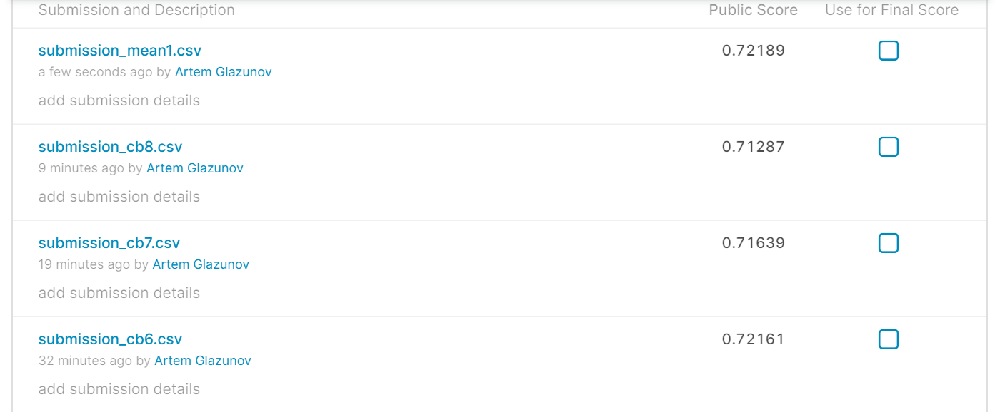

In [ ]:
#Индексы значемых признаков полсле предобработки
indices_lists = data_preprocessor(feats_train,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]


#Заполнение пропущенных значений
#Числовые признаки
numeric_imputer = impute.SimpleImputer()#по умолчанию заполняется средними значениями
numeric_scaler = None

#Категориальные признаки
occurrence_med_prop = 0.1#доля размера категории от медианного значения для признака для дальнейшего объединения таких категорий в одну
cat_imputer1 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')
cat_imputer2 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')

#Методы обработки категориальных признаков
(low_cardinality_cat_transformer1,high_cardinality_cat_transformer1) = (preprocessing.OneHotEncoder(handle_unknown = 'ignore'),
                                                                        preprocessing.OneHotEncoder(handle_unknown = 'ignore'))
                                                                        
#Список трансформеров низкого уровня                                                                      
low_level_transformers = [numeric_imputer,numeric_scaler,cat_imputer1,cat_imputer2,\
                low_cardinality_cat_transformer1,high_cardinality_cat_transformer1]
#Итоговый трансформер
transformer = transformation(low_level_transformers,indices_lists)

In [ ]:
clf = lgb.LGBMClassifier(random_state=42,n_estimators=100,max_depth=3)
    
estimator = Estimator(transformer,clf)

ROC AUC: 0.7402992130604562
PRC AUC: 0.2129460031700871
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     11107
           1       0.53      0.01      0.02       893

    accuracy                           0.93     12000
   macro avg       0.73      0.50      0.49     12000
weighted avg       0.90      0.93      0.89     12000

------------------
------------------


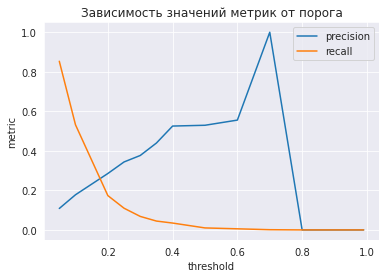

In [ ]:
warnings.filterwarnings('ignore')

estimator.fit(feats_train.values,labels_train.values)

prb = estimator.predict_proba(feats_val.values)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator.predict(feats_val.values)
print(classification_report(labels_val.values,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
clf = lgb.LGBMClassifier(random_state=42,n_estimators=100,max_depth=3)
    
estimator = Estimator(transformer,clf)

estimator.fit(features.values, labels.values)                 
probs = estimator.predict_proba(test_data.values)
write_to_submission_file(probs[:,1],out_file='submission_lgb1.csv')

ROC AUC: 0.7304670309201413
PRC AUC: 0.2164439617993148
              precision    recall  f1-score   support

          -1       0.93      1.00      0.96     11107
           1       0.60      0.04      0.07       893

    accuracy                           0.93     12000
   macro avg       0.77      0.52      0.51     12000
weighted avg       0.90      0.93      0.90     12000

------------------
------------------


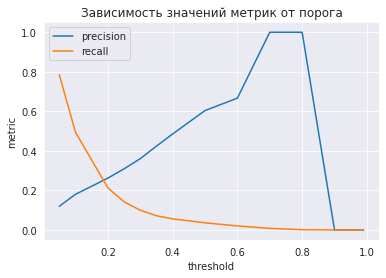

In [ ]:
clf = lgb.LGBMClassifier(random_state=42,n_estimators=200,max_depth=-1, learning_rate=0.05,reg_alpha=0.05,reg_lambda=0.05)
    
estimator = Estimator(transformer,clf)

warnings.filterwarnings('ignore')

estimator.fit(feats_train.values,labels_train.values)

prb = estimator.predict_proba(feats_val.values)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator.predict(feats_val.values)
print(classification_report(labels_val.values,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
clf = lgb.LGBMClassifier(random_state=42,n_estimators=200,max_depth=-1, learning_rate=0.05,reg_alpha=0.05,reg_lambda=0.05)
    
estimator = Estimator(transformer,clf)

estimator.fit(features.values, labels.values)                 
probs = estimator.predict_proba(test_data.values)
write_to_submission_file(probs[:,1],out_file='submission_lgb2.csv')

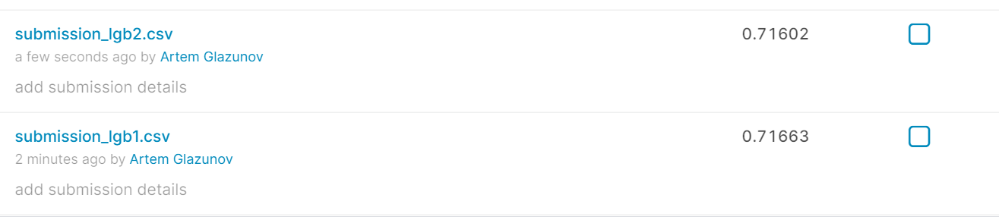

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 167ms	remaining: 1m 3s
10:	learn: 0.5710723	test: 0.5727358	best: 0.5727358 (10)	total: 1.37s	remaining: 46s
20:	learn: 0.5846300	test: 0.5855039	best: 0.5855039 (20)	total: 2.54s	remaining: 43.4s
30:	learn: 0.6770678	test: 0.6701294	best: 0.6701294 (30)	total: 3.76s	remaining: 42.4s
40:	learn: 0.7173510	test: 0.7078972	best: 0.7078972 (40)	total: 5.14s	remaining: 42.5s
50:	learn: 0.7262440	test: 0.7148843	best: 0.7148843 (50)	total: 6.48s	remaining: 41.8s
60:	learn: 0.7315806	test: 0.7184889	best: 0.7185946 (57)	total: 7.83s	remaining: 41s
70:	learn: 0.7366703	test: 0.7222066	best: 0.7223936 (67)	total: 9.18s	remaining: 39.9s
80:	learn: 0.7419034	test: 0.7254476	best: 0.7257717 (79)	total: 10.5s	remaining: 38.8s
90:	learn: 0.7466774	test: 0.7281559	best: 0.7283258 (89)	total: 11.8s	remaining: 37.4s
100:	learn: 0.7488852	test: 0.7292996	best: 0.7293316 (99)	total: 13.2s	remaining: 36.3s
110:	learn: 0.7522504	test: 0.7307437

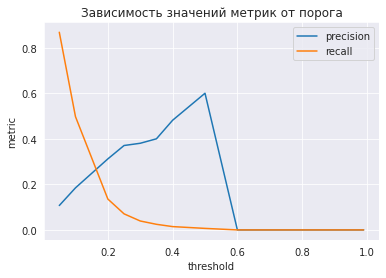

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4,
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))
prb = estimator_cb.predict_proba(cat_prep(feats_val[good_columns],cat_columns))                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(cat_prep(feats_val[good_columns],cat_columns))
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 129ms	remaining: 15.3s
10:	learn: 0.5692714	test: 0.5710864	best: 0.5710864 (10)	total: 1.26s	remaining: 12.5s
20:	learn: 0.5857139	test: 0.5863981	best: 0.5863981 (20)	total: 2.43s	remaining: 11.5s
30:	learn: 0.6447096	test: 0.6439496	best: 0.6439496 (30)	total: 3.63s	remaining: 10.4s
40:	learn: 0.7052917	test: 0.7006139	best: 0.7006139 (40)	total: 4.93s	remaining: 9.51s
50:	learn: 0.7185763	test: 0.7098187	best: 0.7098187 (50)	total: 6.29s	remaining: 8.51s
60:	learn: 0.7354473	test: 0.7220390	best: 0.7220390 (60)	total: 7.64s	remaining: 7.39s
70:	learn: 0.7427671	test: 0.7266952	best: 0.7266952 (70)	total: 8.95s	remaining: 6.17s
80:	learn: 0.7450238	test: 0.7274090	best: 0.7277957 (74)	total: 10.2s	remaining: 4.93s
90:	learn: 0.7472610	test: 0.7272773	best: 0.7278890 (85)	total: 11.5s	remaining: 3.66s
100:	learn: 0.7496955	test: 0.7279947	best: 0.7279947 (100)	total: 12.8s	remaining: 2.4s
110:	learn: 0.7510720	test: 0.728

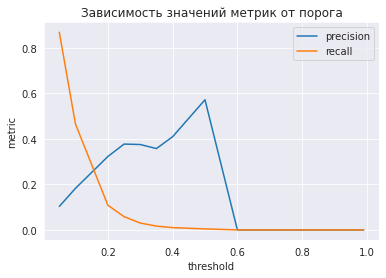

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=120,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4,
                                  l2_leaf_reg=0.1
                                  )

estimator_cb.fit(cat_prep(feats_train[good_columns],cat_columns), labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (cat_prep(feats_val[good_columns],cat_columns), labels_val))
prb = estimator_cb.predict_proba(cat_prep(feats_val[good_columns],cat_columns))                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(cat_prep(feats_val[good_columns],cat_columns))
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=120,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4,
                                  l2_leaf_reg=0.1
                                  )

estimator_cb.fit(cat_prep(features[good_columns],cat_columns), labels, cat_features = cat_columns,verbose=10, plot=True)                 
probs = estimator_cb.predict_proba(cat_prep(test_data[good_columns],cat_columns))
write_to_submission_file(probs[:,1],out_file='submission_cb9.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 136ms	remaining: 16.2s
10:	learn: 0.5751854	total: 1.37s	remaining: 13.6s
20:	learn: 0.5822270	total: 2.49s	remaining: 11.7s
30:	learn: 0.6431841	total: 3.66s	remaining: 10.5s
40:	learn: 0.6941811	total: 4.9s	remaining: 9.45s
50:	learn: 0.7052810	total: 6.19s	remaining: 8.38s
60:	learn: 0.7162427	total: 7.38s	remaining: 7.14s
70:	learn: 0.7279038	total: 8.63s	remaining: 5.96s
80:	learn: 0.7326342	total: 9.87s	remaining: 4.75s
90:	learn: 0.7359138	total: 11.1s	remaining: 3.54s
100:	learn: 0.7392089	total: 12.4s	remaining: 2.32s
110:	learn: 0.7429389	total: 13.7s	remaining: 1.11s
119:	learn: 0.7445455	total: 14.8s	remaining: 0us


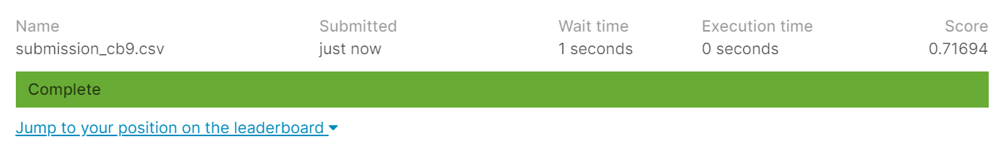

In [19]:
def normed_fe_interaction(dataset,level=3, max_feats = 10,num_columns=[]):
  #Создает признаки на основе комбинаций существующих
  dataset = dataset.copy()
  data = dataset[num_columns]
  
  fe_list = []
 
  for comb in list(itertools.combinations(data.columns,level))[:max_feats]:
  
    if level==2:
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()      
      feature = a*b
      feature.name = f'{comb[0]},{comb[1]}_mix'
      
    elif level==3:
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      feature = a*b + a*c + b*c
      feature.name = f'{comb[0]},{comb[1]},{comb[2]}_mix'

    elif level==4:
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      d = (data[comb[3]] - data[comb[3]].mean())/data[comb[3]].std()
      feature = a*b + a*c + a*d + b*d + b*c + c*d       
      feature.name = f'{comb[0]},{comb[1]},{comb[2]},{comb[3]}_mix'

    elif level==5:
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      d = (data[comb[3]] - data[comb[3]].mean())/data[comb[3]].std()
      e = (data[comb[4]] - data[comb[4]].mean())/data[comb[4]].std()
      feature = a*b + a*c + a*d +a*e + b*c + b*d + b*e + c*d + c*e + d*e
      feature.name = f'{comb[0]},{comb[1]},{comb[2]},{comb[3]},{comb[4]}_mix'      

    fe_list.append(pd.DataFrame(feature))
  if fe_list==[]:
    features = pd.DataFrame()
  else:
    features = pd.concat(fe_list,axis=1) 
  res_dataframe = pd.concat([dataset,features],axis=1)

  return res_dataframe


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5447010	test: 0.5331667	best: 0.5331667 (0)	total: 175ms	remaining: 1m 6s
10:	learn: 0.5713693	test: 0.5665722	best: 0.5665722 (10)	total: 1.49s	remaining: 49.9s
20:	learn: 0.5779825	test: 0.5791406	best: 0.5791406 (20)	total: 2.73s	remaining: 46.7s
30:	learn: 0.6769742	test: 0.6673879	best: 0.6673879 (30)	total: 4.08s	remaining: 45.9s
40:	learn: 0.7180405	test: 0.7080745	best: 0.7080745 (40)	total: 5.45s	remaining: 45.1s
50:	learn: 0.7260944	test: 0.7136649	best: 0.7136649 (50)	total: 6.91s	remaining: 44.6s
60:	learn: 0.7337799	test: 0.7186048	best: 0.7187096 (57)	total: 8.34s	remaining: 43.6s
70:	learn: 0.7401711	test: 0.7226151	best: 0.7226151 (70)	total: 9.74s	remaining: 42.4s
80:	learn: 0.7428436	test: 0.7232714	best: 0.7232714 (80)	total: 11.2s	remaining: 41.3s
90:	learn: 0.7447283	test: 0.7236127	best: 0.7240006 (88)	total: 12.6s	remaining: 40.1s
100:	learn: 0.7474149	test: 0.7255445	best: 0.7255445 (100)	total: 14s	remaining: 38.8s
110:	learn: 0.7494779	test: 0.7268

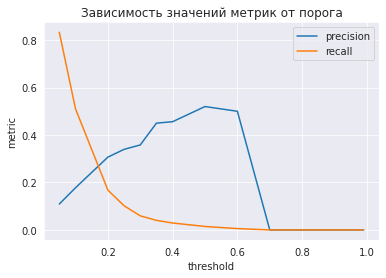

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction(feats_train[good_columns],level=3, max_feats = 100,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction(feats_val[good_columns],level=3, max_feats = 100,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=2, max_feats = 100,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=2, max_feats = 100,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe1.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 162ms	remaining: 1m 1s
10:	learn: 0.5745089	total: 1.45s	remaining: 48.7s
20:	learn: 0.5799120	total: 2.68s	remaining: 45.8s
30:	learn: 0.6539477	total: 3.96s	remaining: 44.6s
40:	learn: 0.7038001	total: 5.4s	remaining: 44.6s
50:	learn: 0.7191750	total: 6.86s	remaining: 44.2s
60:	learn: 0.7268145	total: 8.26s	remaining: 43.2s
70:	learn: 0.7331904	total: 9.61s	remaining: 41.8s
80:	learn: 0.7376558	total: 11s	remaining: 40.6s
90:	learn: 0.7395579	total: 12.3s	remaining: 39.1s
100:	learn: 0.7415998	total: 13.7s	remaining: 37.9s
110:	learn: 0.7445791	total: 15.1s	remaining: 36.7s
120:	learn: 0.7454122	total: 16.5s	remaining: 35.3s
130:	learn: 0.7485990	total: 17.9s	remaining: 34s
140:	learn: 0.7501873	total: 19.2s	remaining: 32.6s
150:	learn: 0.7514794	total: 20.6s	remaining: 31.2s
160:	learn: 0.7535968	total: 21.9s	remaining: 29.8s
170:	learn: 0.7547266	total: 23.2s	remaining: 28.4s
180:	learn: 0.7555001	total: 24.6s	remaining: 27s
190:	learn: 0.7571546	total: 2

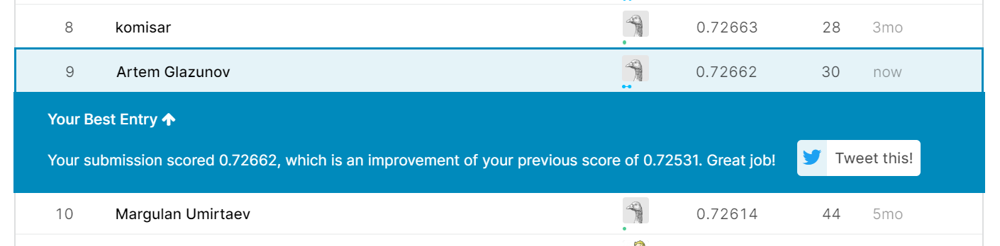

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=3, max_feats = 100,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=3, max_feats = 100,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe2.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 152ms	remaining: 57.7s
10:	learn: 0.5745089	total: 1.53s	remaining: 51.5s
20:	learn: 0.5799120	total: 2.76s	remaining: 47.2s
30:	learn: 0.6505364	total: 4.03s	remaining: 45.4s
40:	learn: 0.6949507	total: 5.38s	remaining: 44.5s
50:	learn: 0.7112531	total: 6.8s	remaining: 43.9s
60:	learn: 0.7240741	total: 8.24s	remaining: 43.1s
70:	learn: 0.7330008	total: 9.66s	remaining: 42s
80:	learn: 0.7378567	total: 11s	remaining: 40.6s
90:	learn: 0.7446229	total: 12.4s	remaining: 39.5s
100:	learn: 0.7470711	total: 13.8s	remaining: 38.1s
110:	learn: 0.7487881	total: 15.2s	remaining: 36.9s
120:	learn: 0.7512021	total: 16.6s	remaining: 35.6s
130:	learn: 0.7531900	total: 17.9s	remaining: 34.1s
140:	learn: 0.7548328	total: 19.3s	remaining: 32.7s
150:	learn: 0.7558930	total: 20.6s	remaining: 31.3s
160:	learn: 0.7572969	total: 22s	remaining: 29.9s
170:	learn: 0.7581705	total: 23.3s	remaining: 28.5s
180:	learn: 0.7590770	total: 24.6s	remaining: 27.1s
190:	learn: 0.7596712	total: 2

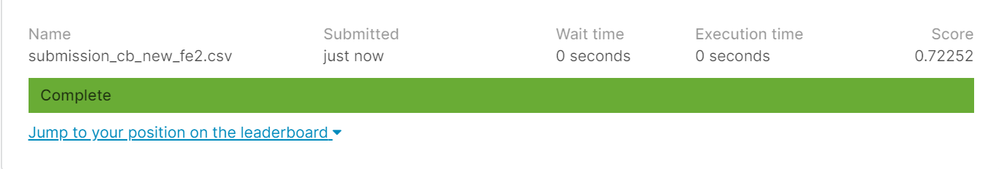

In [ ]:
class OverSamplerEstimator2(BaseEstimator, TransformerMixin):
    def __init__(self, transformer,oversampler,classifier):
        self.transformer = transformer
        self.oversampler = oversampler
        self.classifier = classifier

    def fit(self, X, y):
        self.transformer.fit(X,y)
        X_tr = self.transformer.transform(X)  
        X_resampled, y_resampled = self.oversampler.fit_resample(X_tr,y)     
        self.classifier.fit(X_resampled, y_resampled)
        return self.classifier

    def predict(self, X):
        X_tr = self.transformer.transform(X)        
        return self.classifier.predict(X_tr)
    
    def predict_proba(self,X):
        X_tr = self.transformer.transform(X)        
        return self.classifier.predict_proba(X_tr)

In [ ]:
oversampler_1 = over_sampling.SMOTE()

clf_res = xgb.XGBClassifier(random_state=42,n_estimators=100,gamma=0.1,max_depth=3,reg_alpha=1,min_child_weight=1)
estimator = OverSamplerEstimator2(transformer,oversampler_1,clf_res)

estimator.fit(features.values, labels.values)
probs = estimator.predict_proba(test_data.values)
write_to_submission_file(probs[:,1],out_file='submission_overs1.csv')

In [ ]:
oversampler_2 = over_sampling.RandomOverSampler(sampling_strategy=0.5,random_state=0)

clf_res = xgb.XGBClassifier(random_state=42,n_estimators=100,gamma=0.1,max_depth=3,reg_alpha=1,min_child_weight=1)
estimator = OverSamplerEstimator2(transformer,oversampler_2,clf_res)

estimator.fit(features.values, labels.values)
probs = estimator.predict_proba(test_data.values)
write_to_submission_file(probs[:,1],out_file='submission_overs2.csv')

In [ ]:
%%time
data_train = normed_fe_interaction(features,level=2, max_feats = 100,num_columns=num_columns)
data_test = normed_fe_interaction(test_data,level=2, max_feats = 100,num_columns=num_columns)

indices_lists = data_preprocessor(data_train ,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]


numeric_imputer = impute.SimpleImputer()#по умолчанию заполняется средними значениями
numeric_scaler = None

occurrence_med_prop = 0.1#доля размера категории от медианного значения для признака для дальнейшего объединения таких категорий в одну
cat_imputer1 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')
cat_imputer2 =  MyCatMergerNaInputer(occurrence_med_prop = occurrence_med_prop,fill_value='Hi')

(low_cardinality_cat_transformer1,high_cardinality_cat_transformer1) = (preprocessing.OneHotEncoder(handle_unknown = 'ignore'),
                                                                        preprocessing.OneHotEncoder(handle_unknown = 'ignore'))
                                                                    
low_level_transformers = [numeric_imputer,numeric_scaler,cat_imputer1,cat_imputer2,\
                low_cardinality_cat_transformer1,high_cardinality_cat_transformer1]

transformer = transformation(low_level_transformers,indices_lists)



oversampler_3 = over_sampling.SMOTE(sampling_strategy=0.2,random_state=0)


clf_res = lgb.LGBMClassifier(random_state=42,n_estimators=100,max_depth=3)
estimator = OverSamplerEstimator2(transformer,oversampler_3,clf_res)

estimator.fit(data_train.values, labels.values)
probs = estimator.predict_proba(data_test.values)
write_to_submission_file(probs[:,1],out_file='submission_overs3_lgb.csv')

CPU times: user 18.9 s, sys: 288 ms, total: 19.2 s
Wall time: 19.3 s


In [ ]:
oversampler_4 = over_sampling.RandomOverSampler(sampling_strategy=0.2,random_state=0)


clf_res = lgb.LGBMClassifier(random_state=42,n_estimators=100,max_depth=3)
estimator = OverSamplerEstimator2(transformer,oversampler_4,clf_res)

estimator.fit(data_train.values, labels.values)
probs = estimator.predict_proba(data_test.values)
write_to_submission_file(probs[:,1],out_file='submission_overs4_lgb.csv')

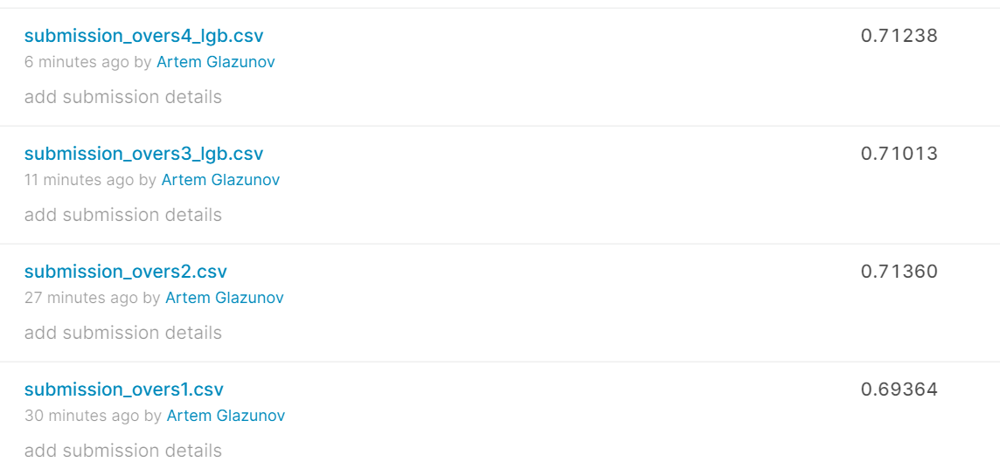

In [ ]:
sub_names = ['submission_cb1','submission_cb2','submission_cb3','submission_cb4','submission_cb5','submission_cb6','submission_cb7',
             'submission_cb8','submission3','submission4','submission5','submission6','submission7','submission8','submission9','submission_final',
             'submission_cb9','submission_cb_new_fe1','submission_cb_new_fe2','submission_lgb1','submission_lgb2','submission_mean1',
             'submission_overs1','submission_overs2','submission_overs3_lgb','submission_overs4_lgb']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df.head()

,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result
Id,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.092013,0.080946,0.081988,0.081819,0.082297,0.245850,0.063512,0.067114,0.064954,0.033749,0.466653,0.263725,0.106894,0.063221,0.060926,0.060926,0.079809,0.090643,0.089395,0.060676,0.070488,0.119787,0.072265,0.273081,0.123748,0.132329
1,0.108802,0.112910,0.111290,0.096106,0.098092,0.282603,0.112622,0.093682,0.117818,0.056393,0.594583,0.411401,0.098931,0.105554,0.108696,0.108696,0.098490,0.098212,0.099714,0.114274,0.219322,0.163636,0.121741,0.453040,0.112047,0.265237
2,0.019675,0.020165,0.020478,0.021503,0.020924,0.070057,0.024609,0.026490,0.028061,0.012662,0.240480,0.142153,0.033888,0.023810,0.025996,0.025996,0.028087,0.030480,0.020855,0.025860,0.020843,0.047309,0.029609,0.144720,0.023697,0.069271
3,0.060231,0.066768,0.060720,0.053580,0.068739,0.212873,0.077320,0.082234,0.078644,0.044644,0.510958,0.326529,0.126811,0.083559,0.082151,0.082151,0.066261,0.030072,0.041639,0.084941,0.082500,0.126120,0.090625,0.355757,0.070562,0.126819
4,0.027637,0.022772,0.023751,0.024252,0.026784,0.092238,0.029508,0.034319,0.021621,0.012318,0.152059,0.101077,0.032756,0.021486,0.023285,0.023285,0.037520,0.030243,0.027730,0.021737,0.012308,0.041822,0.033255,0.125286,0.028443,0.056662


In [ ]:
sub_df['mean'] = sub_df.mean(axis=1)
sub_df.head()

,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,result,mean
Id,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.092013,0.080946,0.081988,0.081819,0.082297,0.245850,0.063512,0.067114,0.064954,0.033749,0.466653,0.263725,0.106894,0.063221,0.060926,0.060926,0.079809,0.090643,0.089395,0.060676,0.070488,0.119787,0.072265,0.273081,0.123748,0.132329,0.116493
1,0.108802,0.112910,0.111290,0.096106,0.098092,0.282603,0.112622,0.093682,0.117818,0.056393,0.594583,0.411401,0.098931,0.105554,0.108696,0.108696,0.098490,0.098212,0.099714,0.114274,0.219322,0.163636,0.121741,0.453040,0.112047,0.265237,0.167842
2,0.019675,0.020165,0.020478,0.021503,0.020924,0.070057,0.024609,0.026490,0.028061,0.012662,0.240480,0.142153,0.033888,0.023810,0.025996,0.025996,0.028087,0.030480,0.020855,0.025860,0.020843,0.047309,0.029609,0.144720,0.023697,0.069271,0.046064
3,0.060231,0.066768,0.060720,0.053580,0.068739,0.212873,0.077320,0.082234,0.078644,0.044644,0.510958,0.326529,0.126811,0.083559,0.082151,0.082151,0.066261,0.030072,0.041639,0.084941,0.082500,0.126120,0.090625,0.355757,0.070562,0.126819,0.118970
4,0.027637,0.022772,0.023751,0.024252,0.026784,0.092238,0.029508,0.034319,0.021621,0.012318,0.152059,0.101077,0.032756,0.021486,0.023285,0.023285,0.037520,0.030243,0.027730,0.021737,0.012308,0.041822,0.033255,0.125286,0.028443,0.056662,0.041698


In [ ]:
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean2.csv')

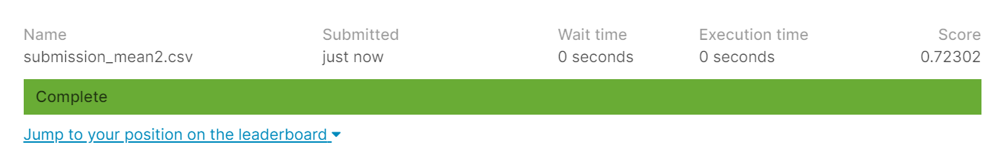

In [ ]:
sub_names = ['submission_cb1','submission_cb2','submission_cb3','submission_cb4','submission_cb5','submission_cb6','submission_cb7',
             'submission3','submission4','submission9','submission_final',
             'submission_cb9','submission_cb_new_fe1','submission_cb_new_fe2','submission_lgb1','submission_lgb2','submission_mean1',
            'submission_overs2','submission_mean2']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean3.csv')

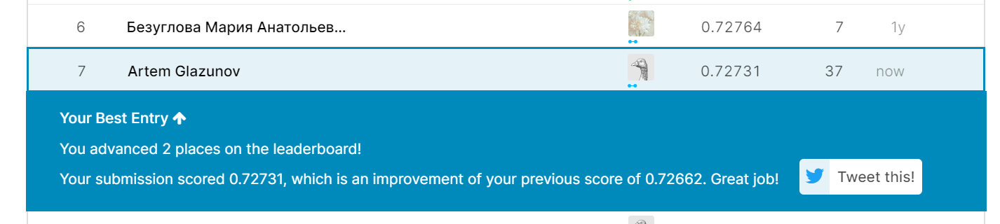

In [ ]:
sub_names = ['submission_cb2','submission_cb3','submission_cb5','submission_cb6','submission_cb_new_fe1','submission_cb_new_fe2','submission_mean1',
            'submission_mean2','submission_mean3']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean4.csv')

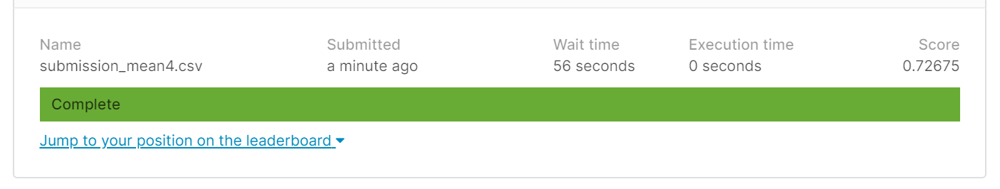

In [ ]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean6.csv')

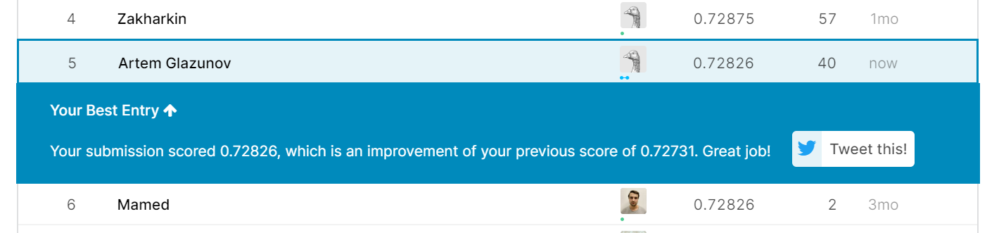

In [ ]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_mean6','submission_mean7']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean8.csv')

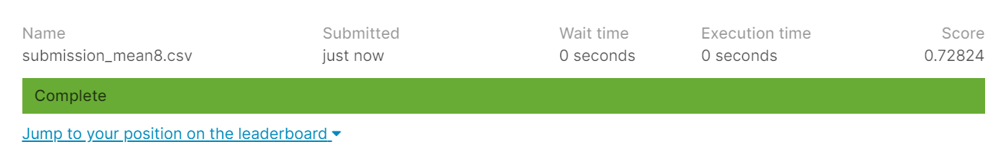

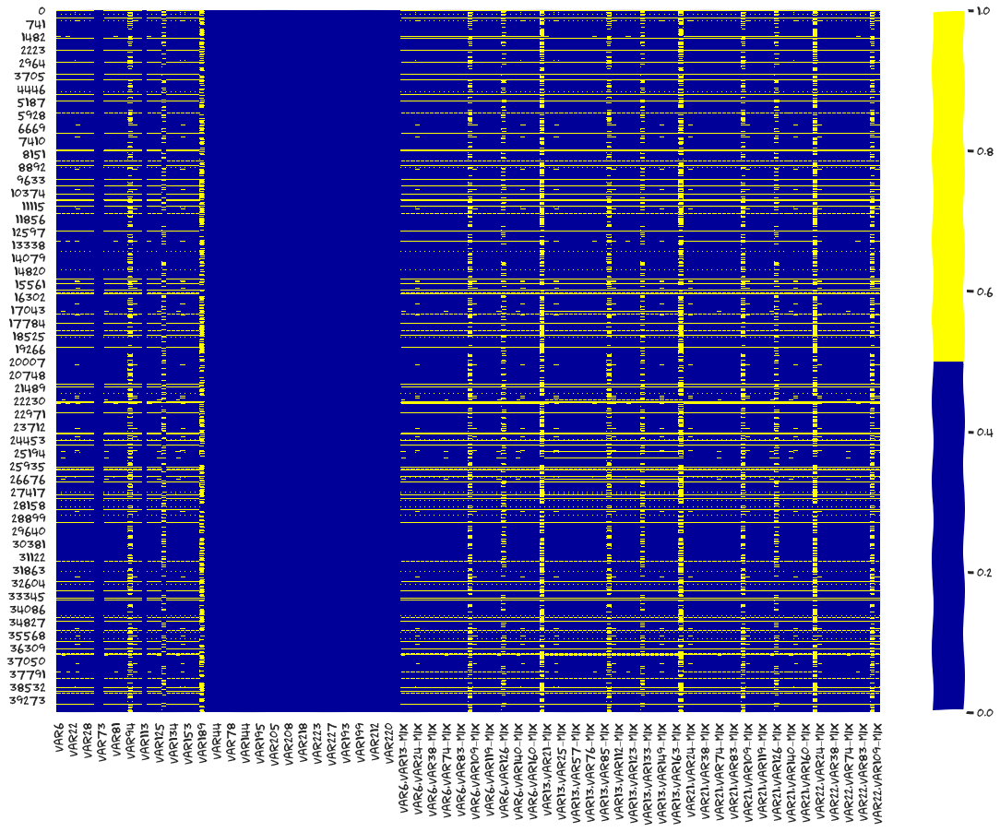

In [ ]:
data0 = cat_prep(normed_fe_interaction(features[good_columns],level=2, max_feats = 100,num_columns=num_columns),cat_columns)
null_map(data0)

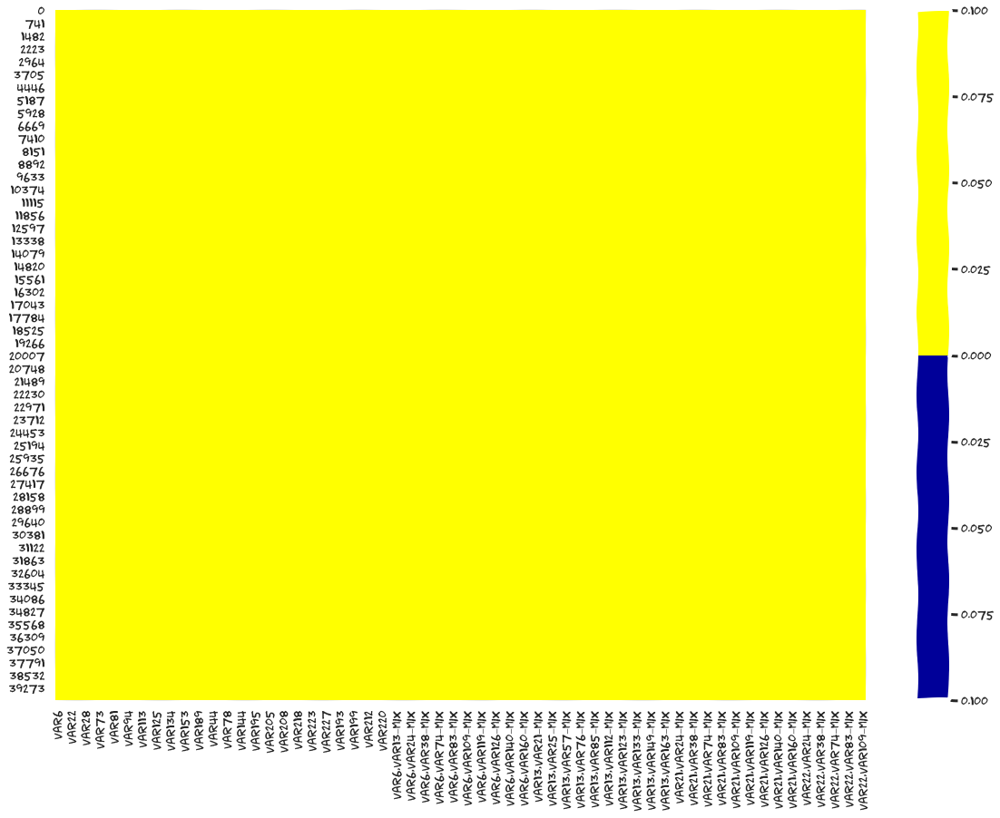

In [ ]:
data0_nafilled = data0.fillna('NANANA')
null_map(data0_nafilled)

In [ ]:
oversampler_5 = over_sampling.RandomOverSampler(sampling_strategy=0.15,random_state=0)
data10,labels1 = oversampler_5.fit_resample(data0_nafilled,labels)

In [ ]:
data11 = pd.DataFrame(data10,columns = data0.columns)
data12 = data11.copy()
data12.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var21,Var24_mix","Var21,Var25_mix","Var21,Var28_mix","Var21,Var38_mix","Var21,Var57_mix","Var21,Var73_mix","Var21,Var74_mix","Var21,Var76_mix","Var21,Var81_mix","Var21,Var83_mix","Var21,Var85_mix","Var21,Var94_mix","Var21,Var109_mix","Var21,Var112_mix","Var21,Var113_mix","Var21,Var119_mix","Var21,Var123_mix","Var21,Var125_mix","Var21,Var126_mix","Var21,Var133_mix","Var21,Var134_mix","Var21,Var140_mix","Var21,Var149_mix","Var21,Var153_mix","Var21,Var160_mix","Var21,Var163_mix","Var21,Var189_mix","Var22,Var24_mix","Var22,Var25_mix","Var22,Var28_mix","Var22,Var38_mix","Var22,Var57_mix","Var22,Var73_mix","Var22,Var74_mix","Var22,Var76_mix","Var22,Var81_mix","Var22,Var83_mix","Var22,Var85_mix","Var22,Var94_mix","Var22,Var109_mix"
0,3052,NANANA,480,600,20,480,200,82752,2.90793,34,NANANA,716008,14599.9,5,32,NANANA,144,144,-1.20996e+06,1660,66,NANANA,4,326915,604276,NANANA,389396,2.31389e+06,28,599532,NANANA,nan,0.0,0.0,nan,nan,0.0,0.0,0.0,9.0,...,0.685776,0.796489,-0.109136,-0.364475,-0.129663,-0.270649,NANANA,-0.184657,-0.363179,-0.0760304,0.498122,NANANA,0.257064,0.215867,-0.609794,0.158686,0.012613,NANANA,0.0893385,-0.352355,0.120705,NANANA,0.059532,-0.391855,-0.0483159,0.0592706,NANANA,0.696173,0.808564,-0.110791,-0.370001,-0.131629,-0.274752,NANANA,-0.187457,-0.368685,-0.0771831,0.505674,NANANA,0.260961
1,1813,636,212,265,2,128,166.56,2.70612e+06,5.87033,128,0,1.66113e+06,67529.1,25,10,32289,80,72,417932,1025,66,24912,40,1.93446e+06,349568,205,735,6.50268e+06,14,364182,276,7.0,0.0,0.0,27.0,3.0,0.0,0.0,0.0,18.0,...,0.00987057,-0.00586096,0.0230473,-0.00170797,-0.0455638,-0.0454131,0.0101156,-0.00365552,0.0130161,-0.00234647,-0.0029006,0.0148894,-0.00526304,-0.00142605,-0.0293758,-0.002169,-0.00112108,0.00131983,-0.0704942,0.00561291,0.00570884,0.0110264,0.0172522,-0.00284025,0.00988391,0.00564729,-0.00244105,0.00878584,-0.00521686,0.0205145,-0.00152027,-0.0405565,-0.0404224,0.00900392,-0.00325379,0.0115857,-0.0020886,-0.00258184,0.0132531,-0.00468466
2,1953,448,176,220,0,72,311.76,4.69878e+06,5.98163,166,245,3.02515e+06,85266,35,0,53388,40,48,-124655,590,78,7218,36,3.14841e+06,1.08621e+06,400,0,1.0569e+07,18,0,NANANA,7.0,0.0,0.0,18.0,3.0,0.0,0.0,0.0,27.0,...,0.0469332,0.0118242,-0.0923496,-0.073052,-0.126219,-0.194444,-0.0379445,-0.0862971,0.0173566,-0.0182511,0.0420806,0.0267564,0.015154,0.0118901,-0.00401953,0.015893,-0.00868095,0.0231717,-0.168113,-0.0365064,-0.110666,0.0243275,0.0457555,-0.104261,0.0219241,0.0596268,NANANA,0.0451282,0.0113695,-0.088798,-0.0702426,-0.121365,-0.186966,-0.0364852,-0.0829783,0.0166891,-0.0175492,0.0404623,0.0257274,0.0145712
3,1533,4,332,415,0,144,220.08,864384,5.1081,30,0,2.64224e+06,74107.2,10,2,NANANA,32,32,378474,1435,24,693,NANANA,7.0667e+06,650390,5,0,9.6762e+06,108,253284,NANANA,7.0,5.0,0.0,9.0,nan,0.0,8.0,0.0,0.0,...,-0.0795709,0.0395275,-0.00756144,-0.0997307,0.138486,-0.121161,-0.0453725,0.10984,-0.0476436,-0.0201024,-0.054473,NANANA,-0.0355521,-0.0378618,0.122676,0.0442952,-0.0288838,-0.0515896,NANANA,0.342929,0.0614706,-0.0578811,-0.0775743,0.14075,0.124,-0.0484006,NANANA,-0.0820024,0.0407354,-0.0077925,-0.102778,0.142718,-0.124863,-0.0467589,0.113196,-0.0490995,-0.0207167,-0.0561375,NANANA,-0.0366385
4,686,0,160,200,2,48,278,4.36488e+06,0.650716,32,0,1440,171073,25,12,106455,32,8,142602,490,60,468,-28,3.79446e+06,642816,225,554414,1.05352e+07,24,2.85128e+06,NANANA,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,9.0,...,0.033333,0.030044,-0.0723757,-0.0785889,0.185816,0.0862291,0.0341604,0.106666,-0.0833115,-0.00792406,-0.0224972,-0.00641186,0.0267667,0.0484986,-0.0514668,0.0266341,-0.000138462,0.0391606,0.160957,-0.0814855,-0.0446298,0.036602,-0.0501923,-0.132056,0.0198955,-0.37047,NANANA,0.0323645,0.029171,-0.0702727,-0.0763054,0.180416,0.08

In [ ]:
for col in data12.columns:
  data12.at[data12[col]=='NANANA',col] = np.nan
data12.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var21,Var24_mix","Var21,Var25_mix","Var21,Var28_mix","Var21,Var38_mix","Var21,Var57_mix","Var21,Var73_mix","Var21,Var74_mix","Var21,Var76_mix","Var21,Var81_mix","Var21,Var83_mix","Var21,Var85_mix","Var21,Var94_mix","Var21,Var109_mix","Var21,Var112_mix","Var21,Var113_mix","Var21,Var119_mix","Var21,Var123_mix","Var21,Var125_mix","Var21,Var126_mix","Var21,Var133_mix","Var21,Var134_mix","Var21,Var140_mix","Var21,Var149_mix","Var21,Var153_mix","Var21,Var160_mix","Var21,Var163_mix","Var21,Var189_mix","Var22,Var24_mix","Var22,Var25_mix","Var22,Var28_mix","Var22,Var38_mix","Var22,Var57_mix","Var22,Var73_mix","Var22,Var74_mix","Var22,Var76_mix","Var22,Var81_mix","Var22,Var83_mix","Var22,Var85_mix","Var22,Var94_mix","Var22,Var109_mix"
0,3052,NaN,480,600,20,480,200,82752,2.90793,34,NaN,716008,14599.9,5,32,NaN,144,144,-1.20996e+06,1660,66,NaN,4,326915,604276,NaN,389396,2.31389e+06,28,599532,NaN,nan,0.0,0.0,nan,nan,0.0,0.0,0.0,9.0,...,0.685776,0.796489,-0.109136,-0.364475,-0.129663,-0.270649,NaN,-0.184657,-0.363179,-0.0760304,0.498122,NaN,0.257064,0.215867,-0.609794,0.158686,0.012613,NaN,0.0893385,-0.352355,0.120705,NaN,0.059532,-0.391855,-0.0483159,0.0592706,NaN,0.696173,0.808564,-0.110791,-0.370001,-0.131629,-0.274752,NaN,-0.187457,-0.368685,-0.0771831,0.505674,NaN,0.260961
1,1813,636,212,265,2,128,166.56,2.70612e+06,5.87033,128,0,1.66113e+06,67529.1,25,10,32289,80,72,417932,1025,66,24912,40,1.93446e+06,349568,205,735,6.50268e+06,14,364182,276,7.0,0.0,0.0,27.0,3.0,0.0,0.0,0.0,18.0,...,0.00987057,-0.00586096,0.0230473,-0.00170797,-0.0455638,-0.0454131,0.0101156,-0.00365552,0.0130161,-0.00234647,-0.0029006,0.0148894,-0.00526304,-0.00142605,-0.0293758,-0.002169,-0.00112108,0.00131983,-0.0704942,0.00561291,0.00570884,0.0110264,0.0172522,-0.00284025,0.00988391,0.00564729,-0.00244105,0.00878584,-0.00521686,0.0205145,-0.00152027,-0.0405565,-0.0404224,0.00900392,-0.00325379,0.0115857,-0.0020886,-0.00258184,0.0132531,-0.00468466
2,1953,448,176,220,0,72,311.76,4.69878e+06,5.98163,166,245,3.02515e+06,85266,35,0,53388,40,48,-124655,590,78,7218,36,3.14841e+06,1.08621e+06,400,0,1.0569e+07,18,0,NaN,7.0,0.0,0.0,18.0,3.0,0.0,0.0,0.0,27.0,...,0.0469332,0.0118242,-0.0923496,-0.073052,-0.126219,-0.194444,-0.0379445,-0.0862971,0.0173566,-0.0182511,0.0420806,0.0267564,0.015154,0.0118901,-0.00401953,0.015893,-0.00868095,0.0231717,-0.168113,-0.0365064,-0.110666,0.0243275,0.0457555,-0.104261,0.0219241,0.0596268,NaN,0.0451282,0.0113695,-0.088798,-0.0702426,-0.121365,-0.186966,-0.0364852,-0.0829783,0.0166891,-0.0175492,0.0404623,0.0257274,0.0145712
3,1533,4,332,415,0,144,220.08,864384,5.1081,30,0,2.64224e+06,74107.2,10,2,NaN,32,32,378474,1435,24,693,NaN,7.0667e+06,650390,5,0,9.6762e+06,108,253284,NaN,7.0,5.0,0.0,9.0,nan,0.0,8.0,0.0,0.0,...,-0.0795709,0.0395275,-0.00756144,-0.0997307,0.138486,-0.121161,-0.0453725,0.10984,-0.0476436,-0.0201024,-0.054473,NaN,-0.0355521,-0.0378618,0.122676,0.0442952,-0.0288838,-0.0515896,NaN,0.342929,0.0614706,-0.0578811,-0.0775743,0.14075,0.124,-0.0484006,NaN,-0.0820024,0.0407354,-0.0077925,-0.102778,0.142718,-0.124863,-0.0467589,0.113196,-0.0490995,-0.0207167,-0.0561375,NaN,-0.0366385
4,686,0,160,200,2,48,278,4.36488e+06,0.650716,32,0,1440,171073,25,12,106455,32,8,142602,490,60,468,-28,3.79446e+06,642816,225,554414,1.05352e+07,24,2.85128e+06,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,9.0,...,0.033333,0.030044,-0.0723757,-0.0785889,0.185816,0.0862291,0.0341604,0.106666,-0.0833115,-0.00792406,-0.0224972,-0.00641186,0.0267667,0.0484986,-0.0514668,0.0266341,-0.000138462,0.0391606,0.160957,-0.0814855,-0.0446298,0.036602,-0.0501923,-0.132056,0.0198955,-0.37047,NaN,0.0323645,0.029171,-0.0702727,-0.0763054,0.180416,0.0837235,0.0331678,0.103566,-0.0808907,-0.00769381,-0.0218435,-0.00622556,0

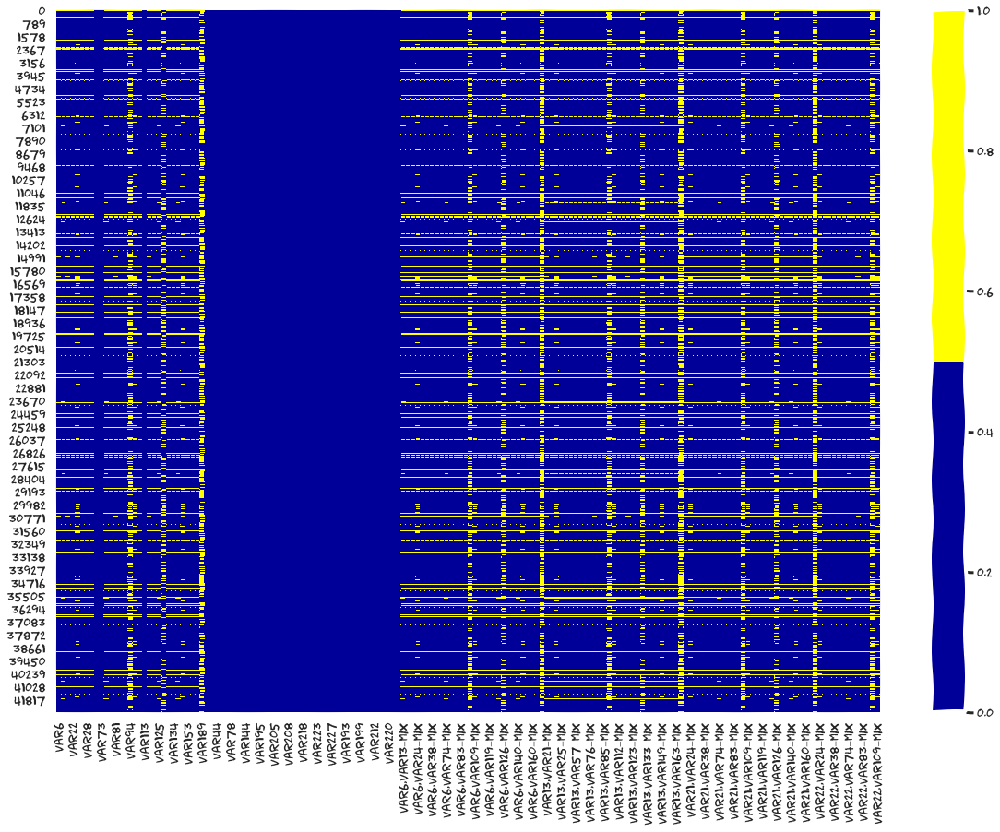

In [ ]:
null_map(data12)

In [ ]:
data12.shape

(42577, 172)

In [ ]:
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=2, max_feats = 100,num_columns=num_columns),cat_columns)

In [ ]:
data1 = data12.copy()
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )


estimator_cb.fit(data1, labels1, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe1_resampled.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.8960906	total: 104ms	remaining: 39.3s
10:	learn: 0.9041462	total: 1.04s	remaining: 34.8s
20:	learn: 0.9050800	total: 1.98s	remaining: 33.8s
30:	learn: 0.9151685	total: 2.9s	remaining: 32.7s
40:	learn: 0.9262251	total: 3.87s	remaining: 32s
50:	learn: 0.9350544	total: 4.87s	remaining: 31.4s
60:	learn: 0.9382568	total: 5.88s	remaining: 30.8s
70:	learn: 0.9401846	total: 6.86s	remaining: 29.8s
80:	learn: 0.9415807	total: 7.83s	remaining: 28.9s
90:	learn: 0.9431829	total: 8.81s	remaining: 28s
100:	learn: 0.9446268	total: 9.84s	remaining: 27.2s
110:	learn: 0.9454206	total: 10.8s	remaining: 26.3s
120:	learn: 0.9466122	total: 11.9s	remaining: 25.4s
130:	learn: 0.9470798	total: 12.8s	remaining: 24.4s
140:	learn: 0.9477571	total: 13.8s	remaining: 23.4s
150:	learn: 0.9480209	total: 14.7s	remaining: 22.3s
160:	learn: 0.9485584	total: 15.7s	remaining: 21.4s
170:	learn: 0.9487638	total: 16.7s	remaining: 20.4s
180:	learn: 0.9490836	total: 17.6s	remaining: 19.3s
190:	learn: 0.9497980	total:

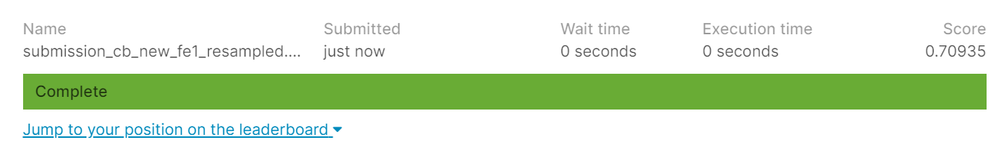

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5555654	test: 0.5696517	best: 0.5696517 (0)	total: 186ms	remaining: 1m 10s
10:	learn: 0.5727133	test: 0.5781094	best: 0.5785838 (6)	total: 1.56s	remaining: 52.3s
20:	learn: 0.5800446	test: 0.5817079	best: 0.5817079 (20)	total: 2.91s	remaining: 49.8s
30:	learn: 0.6760883	test: 0.6724941	best: 0.6724941 (30)	total: 4.32s	remaining: 48.7s
40:	learn: 0.7155201	test: 0.7094522	best: 0.7094522 (40)	total: 5.88s	remaining: 48.6s
50:	learn: 0.7256931	test: 0.7167892	best: 0.7167892 (50)	total: 7.38s	remaining: 47.6s
60:	learn: 0.7329670	test: 0.7207855	best: 0.7207855 (60)	total: 8.92s	remaining: 46.6s
70:	learn: 0.7387173	test: 0.7247927	best: 0.7247927 (70)	total: 10.4s	remaining: 45.3s
80:	learn: 0.7409686	test: 0.7265265	best: 0.7267736 (77)	total: 11.9s	remaining: 43.8s
90:	learn: 0.7451937	test: 0.7274980	best: 0.7277259 (87)	total: 13.5s	remaining: 42.8s
100:	learn: 0.7472952	test: 0.7282162	best: 0.7282162 (100)	total: 15s	remaining: 41.4s
110:	learn: 0.7494383	test: 0.7292

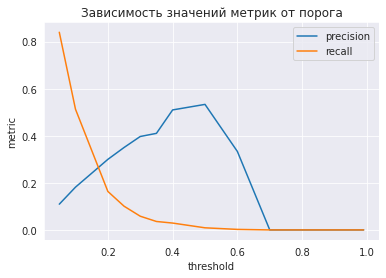

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction(feats_train[good_columns],level=2, max_feats = 200,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction(feats_val[good_columns],level=2, max_feats = 200,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=300,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=2, max_feats = 200,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=2, max_feats = 200,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe3.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 166ms	remaining: 49.5s
10:	learn: 0.5737682	total: 1.56s	remaining: 41.1s
20:	learn: 0.5810381	total: 2.86s	remaining: 37.9s
30:	learn: 0.6478194	total: 4.2s	remaining: 36.5s
40:	learn: 0.7043435	total: 5.69s	remaining: 36s
50:	learn: 0.7178824	total: 7.12s	remaining: 34.8s
60:	learn: 0.7259090	total: 8.68s	remaining: 34s
70:	learn: 0.7326476	total: 10.1s	remaining: 32.6s
80:	learn: 0.7371109	total: 11.6s	remaining: 31.3s
90:	learn: 0.7412733	total: 13.1s	remaining: 30s
100:	learn: 0.7456017	total: 14.6s	remaining: 28.7s
110:	learn: 0.7492314	total: 16.1s	remaining: 27.4s
120:	learn: 0.7502860	total: 17.6s	remaining: 26s
130:	learn: 0.7518562	total: 19s	remaining: 24.5s
140:	learn: 0.7543744	total: 20.4s	remaining: 23s
150:	learn: 0.7561948	total: 21.9s	remaining: 21.6s
160:	learn: 0.7571706	total: 23.3s	remaining: 20.1s
170:	learn: 0.7586733	total: 24.7s	remaining: 18.6s
180:	learn: 0.7594815	total: 26.1s	remaining: 17.1s
190:	learn: 0.7600362	total: 27.4s	r

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5555654	test: 0.5696517	best: 0.5696517 (0)	total: 229ms	remaining: 1m 26s
10:	learn: 0.5709300	test: 0.5785761	best: 0.5785761 (10)	total: 1.66s	remaining: 55.6s
20:	learn: 0.5779587	test: 0.5830868	best: 0.5830868 (20)	total: 3.07s	remaining: 52.5s
30:	learn: 0.6677980	test: 0.6607206	best: 0.6607206 (30)	total: 4.64s	remaining: 52.3s
40:	learn: 0.7176700	test: 0.7086438	best: 0.7086438 (40)	total: 6.3s	remaining: 52.1s
50:	learn: 0.7245792	test: 0.7141760	best: 0.7141760 (50)	total: 7.95s	remaining: 51.3s
60:	learn: 0.7313309	test: 0.7192411	best: 0.7196368 (54)	total: 9.59s	remaining: 50.2s
70:	learn: 0.7381613	test: 0.7231347	best: 0.7231347 (70)	total: 11.2s	remaining: 48.8s
80:	learn: 0.7439606	test: 0.7258459	best: 0.7258459 (80)	total: 12.8s	remaining: 47.3s
90:	learn: 0.7489358	test: 0.7280552	best: 0.7281509 (88)	total: 14.4s	remaining: 45.9s
100:	learn: 0.7516595	test: 0.7294889	best: 0.7294889 (100)	total: 16.1s	remaining: 44.4s
110:	learn: 0.7533149	test: 0.72

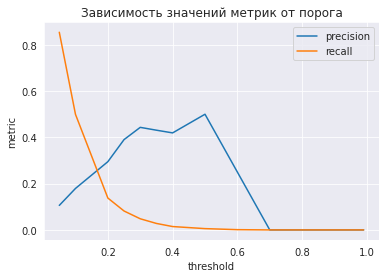

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction(feats_train[good_columns],level=3, max_feats = 300,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction(feats_val[good_columns],level=3, max_feats = 300,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=180,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=3, max_feats = 300,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=3, max_feats = 300,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe4.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5765340	total: 214ms	remaining: 38.3s
10:	learn: 0.5799161	total: 1.69s	remaining: 26s
20:	learn: 0.5870620	total: 3.11s	remaining: 23.6s
30:	learn: 0.6518445	total: 4.58s	remaining: 22s
40:	learn: 0.7031722	total: 6.19s	remaining: 21s
50:	learn: 0.7182985	total: 7.71s	remaining: 19.5s
60:	learn: 0.7273776	total: 9.42s	remaining: 18.4s
70:	learn: 0.7312863	total: 10.9s	remaining: 16.7s
80:	learn: 0.7365586	total: 12.5s	remaining: 15.3s
90:	learn: 0.7394513	total: 14s	remaining: 13.7s
100:	learn: 0.7420845	total: 15.7s	remaining: 12.3s
110:	learn: 0.7443395	total: 17.3s	remaining: 10.8s
120:	learn: 0.7468562	total: 18.9s	remaining: 9.22s
130:	learn: 0.7501698	total: 20.5s	remaining: 7.65s
140:	learn: 0.7526821	total: 21.9s	remaining: 6.07s
150:	learn: 0.7537583	total: 23.4s	remaining: 4.5s
160:	learn: 0.7554334	total: 24.9s	remaining: 2.94s
170:	learn: 0.7564258	total: 26.4s	remaining: 1.39s
179:	learn: 0.7574179	total: 27.7s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5555654	test: 0.5696517	best: 0.5696517 (0)	total: 210ms	remaining: 1m 19s
10:	learn: 0.5709300	test: 0.5785761	best: 0.5785761 (10)	total: 1.67s	remaining: 56.1s
20:	learn: 0.5779587	test: 0.5830868	best: 0.5830868 (20)	total: 3.05s	remaining: 52.1s
30:	learn: 0.6677980	test: 0.6607206	best: 0.6607206 (30)	total: 4.61s	remaining: 51.9s
40:	learn: 0.7124102	test: 0.7036034	best: 0.7036034 (40)	total: 6.25s	remaining: 51.6s
50:	learn: 0.7223031	test: 0.7120764	best: 0.7120764 (50)	total: 7.87s	remaining: 50.8s
60:	learn: 0.7315007	test: 0.7200186	best: 0.7200186 (60)	total: 9.49s	remaining: 49.6s
70:	learn: 0.7366947	test: 0.7230960	best: 0.7230960 (70)	total: 11.1s	remaining: 48.4s
80:	learn: 0.7452885	test: 0.7279401	best: 0.7279401 (80)	total: 12.8s	remaining: 47.1s
90:	learn: 0.7498814	test: 0.7305478	best: 0.7305478 (90)	total: 14.4s	remaining: 45.8s
100:	learn: 0.7536936	test: 0.7324928	best: 0.7324928 (100)	total: 16.1s	remaining: 44.4s
110:	learn: 0.7561547	test: 0.7

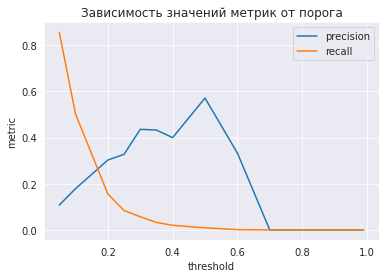

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction(feats_train[good_columns],level=4, max_feats = 300,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction(feats_val[good_columns],level=4, max_feats = 300,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=250,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=4, max_feats = 300,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=4, max_feats = 300,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe5.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5765340	total: 200ms	remaining: 49.7s
10:	learn: 0.5799161	total: 1.67s	remaining: 36.2s
20:	learn: 0.5870620	total: 3.06s	remaining: 33.3s
30:	learn: 0.6518445	total: 4.54s	remaining: 32s
40:	learn: 0.7019444	total: 6.16s	remaining: 31.4s
50:	learn: 0.7162397	total: 7.72s	remaining: 30.1s
60:	learn: 0.7286017	total: 9.42s	remaining: 29.2s
70:	learn: 0.7319286	total: 11s	remaining: 27.7s
80:	learn: 0.7376823	total: 12.6s	remaining: 26.3s
90:	learn: 0.7398947	total: 14.3s	remaining: 24.9s
100:	learn: 0.7423709	total: 15.9s	remaining: 23.4s
110:	learn: 0.7449867	total: 17.5s	remaining: 21.9s
120:	learn: 0.7463365	total: 19.1s	remaining: 20.4s
130:	learn: 0.7498860	total: 20.7s	remaining: 18.8s
140:	learn: 0.7529285	total: 22.3s	remaining: 17.2s
150:	learn: 0.7542704	total: 23.8s	remaining: 15.6s
160:	learn: 0.7565077	total: 25.4s	remaining: 14s
170:	learn: 0.7571968	total: 26.9s	remaining: 12.4s
180:	learn: 0.7578454	total: 28.4s	remaining: 10.8s
190:	learn: 0.7588466	total: 

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5555654	test: 0.5696517	best: 0.5696517 (0)	total: 211ms	remaining: 1m 19s
10:	learn: 0.5709300	test: 0.5785761	best: 0.5785761 (10)	total: 1.69s	remaining: 56.6s
20:	learn: 0.5779587	test: 0.5830868	best: 0.5830868 (20)	total: 3.08s	remaining: 52.8s
30:	learn: 0.6677980	test: 0.6607206	best: 0.6607206 (30)	total: 4.64s	remaining: 52.2s
40:	learn: 0.7124102	test: 0.7036034	best: 0.7036034 (40)	total: 6.28s	remaining: 52s
50:	learn: 0.7207803	test: 0.7090081	best: 0.7090081 (50)	total: 7.92s	remaining: 51.1s
60:	learn: 0.7300992	test: 0.7172233	best: 0.7174205 (54)	total: 9.51s	remaining: 49.7s
70:	learn: 0.7371882	test: 0.7223321	best: 0.7223321 (70)	total: 11.2s	remaining: 48.8s
80:	learn: 0.7405784	test: 0.7244780	best: 0.7244780 (80)	total: 12.8s	remaining: 47.2s
90:	learn: 0.7462393	test: 0.7270537	best: 0.7274523 (89)	total: 14.4s	remaining: 45.7s
100:	learn: 0.7488309	test: 0.7290478	best: 0.7290478 (100)	total: 16s	remaining: 44.1s
110:	learn: 0.7509729	test: 0.72959

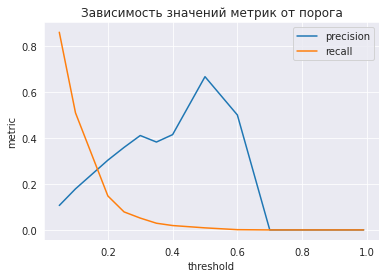

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction(feats_train[good_columns],level=5, max_feats = 300,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction(feats_val[good_columns],level=5, max_feats = 300,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [ ]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=250,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction(features[good_columns],level=5, max_feats = 400,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction(test_data[good_columns],level=5, max_feats = 400,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe6.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5765340	total: 212ms	remaining: 52.9s
10:	learn: 0.5768688	total: 1.77s	remaining: 38.6s
20:	learn: 0.5865380	total: 3.25s	remaining: 35.5s
30:	learn: 0.6364463	total: 4.77s	remaining: 33.7s
40:	learn: 0.6955057	total: 6.38s	remaining: 32.5s
50:	learn: 0.7145198	total: 8.09s	remaining: 31.6s
60:	learn: 0.7219178	total: 9.77s	remaining: 30.3s
70:	learn: 0.7286468	total: 11.3s	remaining: 28.4s
80:	learn: 0.7331868	total: 12.9s	remaining: 27s
90:	learn: 0.7365956	total: 14.6s	remaining: 25.5s
100:	learn: 0.7423750	total: 16.3s	remaining: 24.1s
110:	learn: 0.7454753	total: 18s	remaining: 22.6s
120:	learn: 0.7475723	total: 19.6s	remaining: 20.9s
130:	learn: 0.7508287	total: 21.4s	remaining: 19.4s
140:	learn: 0.7526286	total: 22.9s	remaining: 17.7s
150:	learn: 0.7540284	total: 24.5s	remaining: 16.1s
160:	learn: 0.7560124	total: 26.2s	remaining: 14.5s
170:	learn: 0.7575312	total: 27.7s	remaining: 12.8s
180:	learn: 0.7582612	total: 29.3s	remaining: 11.2s
190:	learn: 0.7595958	total

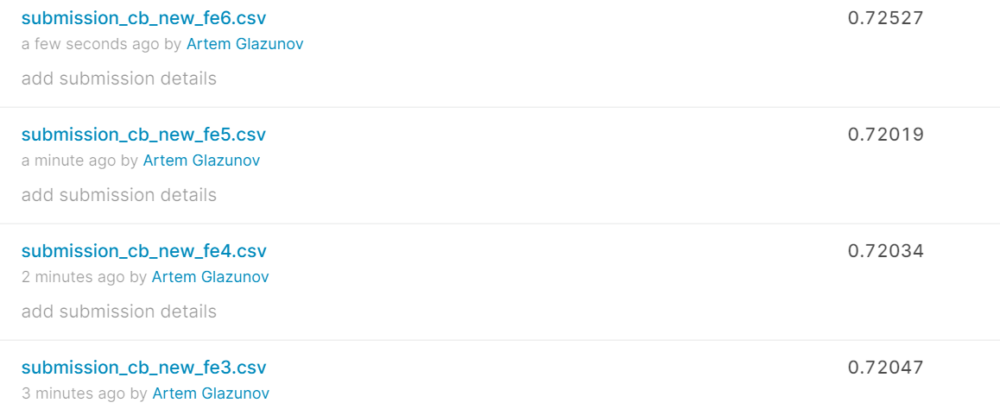

In [ ]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean9.csv')

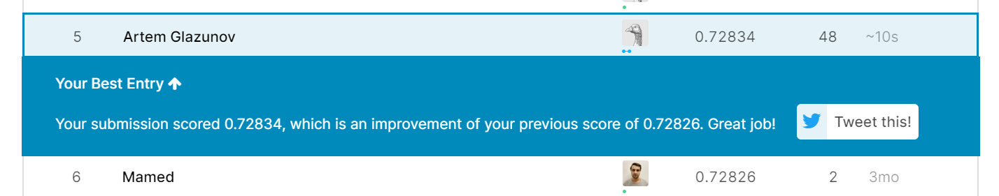

In [21]:
[num_inds, cat_indices1,cat_indices2]= data_preprocessor(feats_train,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]
cat_columns0 = list(np.array(features.columns)[cat_indices1]) + list(np.array(features.columns)[cat_indices2])
num_columns0 = list(np.array(features.columns)[num_inds])
good_columns0 = num_columns0 + cat_columns0

print(num_columns0)

data_train0 = cat_prep(normed_fe_interaction(feats_train[good_columns0],level=2, max_feats = 60,num_columns=num_columns0),cat_columns0)

data_val0 = cat_prep(normed_fe_interaction(feats_val[good_columns0],level=2, max_feats = 60,num_columns=num_columns0),cat_columns0)


[num_inds, cat_indices1,cat_indices2]= data_preprocessor(data_train0,params=[0.7, 0.5, 30])# params = [prop_nan,max_prop_unique,N_lim]
cat_columns1 = list(np.array(data_train0.columns)[cat_indices1]) + list(np.array(data_train0.columns)[cat_indices2])
num_columns1 = list(np.array(data_train0.columns)[num_inds])
good_columns1 = num_columns1 + cat_columns1

print(num_columns1)

data_train1 = cat_prep(normed_fe_interaction(data_train0[good_columns1],level=5, max_feats = 150,num_columns=num_columns1),cat_columns1)

data_val1 = cat_prep(normed_fe_interaction(data_val0[good_columns1],level=5, max_feats = 150,num_columns=num_columns1),cat_columns1)



['Var6', 'Var13', 'Var21', 'Var22', 'Var24', 'Var25', 'Var28', 'Var38', 'Var57', 'Var73', 'Var74', 'Var76', 'Var81', 'Var83', 'Var85', 'Var94', 'Var109', 'Var112', 'Var113', 'Var119', 'Var123', 'Var125', 'Var126', 'Var133', 'Var134', 'Var140', 'Var149', 'Var153', 'Var160', 'Var163', 'Var189']
['Var6', 'Var13', 'Var21', 'Var22', 'Var24', 'Var25', 'Var28', 'Var38', 'Var57', 'Var73', 'Var74', 'Var76', 'Var81', 'Var83', 'Var85', 'Var94', 'Var109', 'Var112', 'Var113', 'Var119', 'Var123', 'Var125', 'Var126', 'Var133', 'Var134', 'Var140', 'Var149', 'Var153', 'Var160', 'Var163', 'Var189', 'Var6,Var13_mix', 'Var6,Var21_mix', 'Var6,Var22_mix', 'Var6,Var24_mix', 'Var6,Var25_mix', 'Var6,Var28_mix', 'Var6,Var38_mix', 'Var6,Var57_mix', 'Var6,Var73_mix', 'Var6,Var74_mix', 'Var6,Var76_mix', 'Var6,Var81_mix', 'Var6,Var83_mix', 'Var6,Var85_mix', 'Var6,Var94_mix', 'Var6,Var109_mix', 'Var6,Var112_mix', 'Var6,Var113_mix', 'Var6,Var119_mix', 'Var6,Var123_mix', 'Var6,Var125_mix', 'Var6,Var126_mix', 'Var6,Var

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5506279	test: 0.5668173	best: 0.5668173 (0)	total: 191ms	remaining: 1m 12s
10:	learn: 0.5695241	test: 0.5773915	best: 0.5774430 (9)	total: 1.62s	remaining: 54.3s
20:	learn: 0.5836996	test: 0.5883385	best: 0.5883385 (20)	total: 3.06s	remaining: 52.3s
30:	learn: 0.6523662	test: 0.6526531	best: 0.6526531 (30)	total: 4.56s	remaining: 51.4s
40:	learn: 0.7082621	test: 0.7031222	best: 0.7031222 (40)	total: 6.11s	remaining: 50.5s
50:	learn: 0.7261671	test: 0.7169313	best: 0.7169313 (50)	total: 7.67s	remaining: 49.5s
60:	learn: 0.7348006	test: 0.7235273	best: 0.7235273 (60)	total: 9.19s	remaining: 48s
70:	learn: 0.7382246	test: 0.7241529	best: 0.7243347 (66)	total: 10.7s	remaining: 46.6s
80:	learn: 0.7432836	test: 0.7278105	best: 0.7278105 (80)	total: 12.2s	remaining: 45.1s
90:	learn: 0.7464185	test: 0.7294106	best: 0.7296453 (85)	total: 13.7s	remaining: 43.5s
100:	learn: 0.7478922	test: 0.7304128	best: 0.7304863 (98)	total: 15.2s	remaining: 42.1s
110:	learn: 0.7510823	test: 0.73050

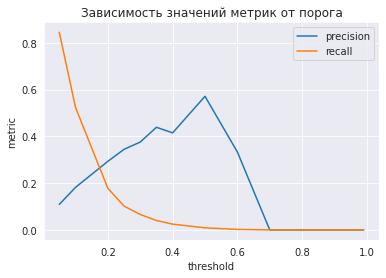

In [22]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )

estimator_cb.fit(data_train1, labels_train, cat_features = cat_columns1,verbose=10, plot=True,
                 eval_set = (data_val1, labels_val))
prb = estimator_cb.predict_proba(data_val1)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val1)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [24]:
data0 = cat_prep(normed_fe_interaction(features[good_columns0],level=2, max_feats = 70,num_columns=num_columns0),cat_columns0)

data_test0 = cat_prep(normed_fe_interaction(test_data[good_columns0],level=2, max_feats = 70,num_columns=num_columns0),cat_columns0)

data1 = cat_prep(normed_fe_interaction(data0[good_columns1],level=5, max_feats = 150,num_columns=num_columns1),cat_columns1)
data_test1 = cat_prep(normed_fe_interaction(data_test0[good_columns1],level=5, max_feats = 150,num_columns=num_columns1),cat_columns1)


data1.columns

Index(['Var6', 'Var13', 'Var21', 'Var22', 'Var24', 'Var25', 'Var28', 'Var38',
       'Var57', 'Var73',
       ...
       'Var6,Var13,Var21,Var24,Var6,Var160_mix_mix',
       'Var6,Var13,Var21,Var24,Var6,Var163_mix_mix',
       'Var6,Var13,Var21,Var24,Var6,Var189_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var21_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var22_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var24_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var25_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var28_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var38_mix_mix',
       'Var6,Var13,Var21,Var24,Var13,Var57_mix_mix'],
      dtype='object', length=282)

In [26]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )


estimator_cb.fit(data1, labels, cat_features = cat_columns1,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test1)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe7.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5451564	total: 184ms	remaining: 1m 9s
10:	learn: 0.5725576	total: 1.58s	remaining: 53.1s
20:	learn: 0.5805818	total: 2.85s	remaining: 48.6s
30:	learn: 0.6456250	total: 4.25s	remaining: 47.8s
40:	learn: 0.6933237	total: 5.72s	remaining: 47.3s
50:	learn: 0.7176251	total: 7.26s	remaining: 46.8s
60:	learn: 0.7294395	total: 8.76s	remaining: 45.8s
70:	learn: 0.7340938	total: 10.2s	remaining: 44.5s
80:	learn: 0.7382719	total: 11.7s	remaining: 43s
90:	learn: 0.7408038	total: 13.1s	remaining: 41.6s
100:	learn: 0.7453128	total: 14.6s	remaining: 40.3s
110:	learn: 0.7475374	total: 16.1s	remaining: 39s
120:	learn: 0.7486774	total: 17.6s	remaining: 37.7s
130:	learn: 0.7511468	total: 19s	remaining: 36.1s
140:	learn: 0.7526319	total: 20.4s	remaining: 34.6s
150:	learn: 0.7539047	total: 21.8s	remaining: 33.1s
160:	learn: 0.7547536	total: 23.3s	remaining: 31.7s
170:	learn: 0.7556646	total: 24.7s	remaining: 30.2s
180:	learn: 0.7577817	total: 26.1s	remaining: 28.7s
190:	learn: 0.7582746	total: 

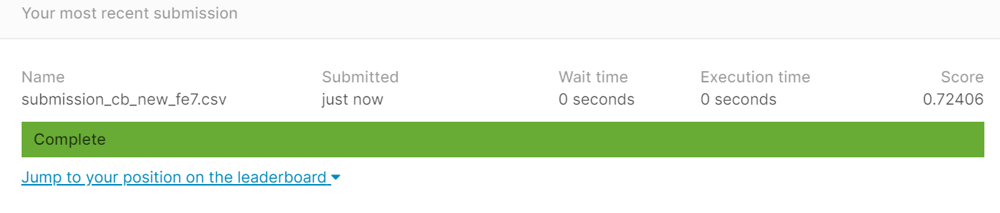

In [19]:
def normed_fe_interaction_2_3_4_5(dataset, max_feats = 10,num_columns=[]):
  #Создает признаки на основе комбинаций существующих
  dataset = dataset.copy()
  data = dataset[num_columns]
  
  fe_list = []
 
  for comb in list(itertools.combinations(data.columns,2))[:max_feats]:
  
    
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()      
      feature = a*b
      feature.name = f'{comb[0]},{comb[1]}_mix'

      fe_list.append(pd.DataFrame(feature))
      
  for comb in list(itertools.combinations(data.columns,3))[:max_feats]:
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      feature = a*b + a*c + b*c
      feature.name = f'{comb[0]},{comb[1]},{comb[2]}_mix'
      fe_list.append(pd.DataFrame(feature))

  for comb in list(itertools.combinations(data.columns,4))[:max_feats]:  
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      d = (data[comb[3]] - data[comb[3]].mean())/data[comb[3]].std()
      feature = a*b + a*c + a*d + b*d + b*c + c*d       
      feature.name = f'{comb[0]},{comb[1]},{comb[2]},{comb[3]}_mix'
      fe_list.append(pd.DataFrame(feature))

  for comb in list(itertools.combinations(data.columns,5))[:max_feats]:  
      a = (data[comb[0]] - data[comb[0]].mean())/data[comb[0]].std()
      b = (data[comb[1]] - data[comb[1]].mean())/data[comb[1]].std()
      c = (data[comb[2]] - data[comb[2]].mean())/data[comb[2]].std()
      d = (data[comb[3]] - data[comb[3]].mean())/data[comb[3]].std()
      e = (data[comb[4]] - data[comb[4]].mean())/data[comb[4]].std()
      feature = a*b + a*c + a*d +a*e + b*c + b*d + b*e + c*d + c*e + d*e
      feature.name = f'{comb[0]},{comb[1]},{comb[2]},{comb[3]},{comb[4]}_mix'      
      fe_list.append(pd.DataFrame(feature))
    
  if fe_list==[]:
    features = pd.DataFrame()
  else:
    features = pd.concat(fe_list,axis=1) 
  res_dataframe = pd.concat([dataset,features],axis=1)

  return res_dataframe

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5555654	test: 0.5696517	best: 0.5696517 (0)	total: 215ms	remaining: 1m 21s
10:	learn: 0.5713860	test: 0.5765586	best: 0.5794135 (8)	total: 1.72s	remaining: 57.7s
20:	learn: 0.5861074	test: 0.5806159	best: 0.5806159 (20)	total: 3.35s	remaining: 57.3s
30:	learn: 0.6734353	test: 0.6672239	best: 0.6672239 (30)	total: 4.99s	remaining: 56.2s
40:	learn: 0.7155750	test: 0.7025345	best: 0.7028905 (39)	total: 6.73s	remaining: 55.7s
50:	learn: 0.7241156	test: 0.7102279	best: 0.7103319 (49)	total: 8.45s	remaining: 54.5s
60:	learn: 0.7336637	test: 0.7190003	best: 0.7190003 (60)	total: 10.3s	remaining: 53.9s
70:	learn: 0.7421160	test: 0.7243975	best: 0.7243975 (70)	total: 12s	remaining: 52.3s
80:	learn: 0.7472532	test: 0.7267382	best: 0.7267382 (80)	total: 13.8s	remaining: 50.9s
90:	learn: 0.7514526	test: 0.7300600	best: 0.7300600 (90)	total: 15.5s	remaining: 49.3s
100:	learn: 0.7528829	test: 0.7305117	best: 0.7305117 (100)	total: 17.3s	remaining: 47.7s
110:	learn: 0.7558333	test: 0.7301

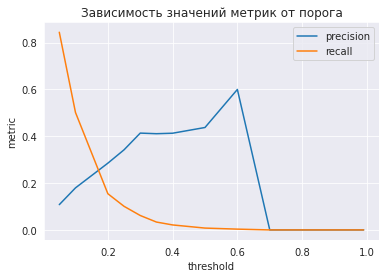

In [34]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data_train = cat_prep(normed_fe_interaction_2_3_4_5(feats_train[good_columns], max_feats = 100,num_columns=num_columns),cat_columns)
data_val = cat_prep(normed_fe_interaction_2_3_4_5(feats_val[good_columns], max_feats = 100,num_columns=num_columns),cat_columns)

estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [35]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction_2_3_4_5(features[good_columns], max_feats = 100,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction_2_3_4_5(test_data[good_columns], max_feats = 100,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe8.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5765340	total: 221ms	remaining: 1m 23s
10:	learn: 0.5768688	total: 1.81s	remaining: 1m
20:	learn: 0.5865380	total: 3.3s	remaining: 56.5s
30:	learn: 0.6394052	total: 4.8s	remaining: 54.1s
40:	learn: 0.6967446	total: 6.49s	remaining: 53.7s
50:	learn: 0.7134748	total: 8.16s	remaining: 52.6s
60:	learn: 0.7281194	total: 9.95s	remaining: 52.1s
70:	learn: 0.7341011	total: 11.6s	remaining: 50.6s
80:	learn: 0.7391862	total: 13.3s	remaining: 49.1s
90:	learn: 0.7425467	total: 15s	remaining: 47.6s
100:	learn: 0.7461727	total: 16.6s	remaining: 45.9s
110:	learn: 0.7490683	total: 18.4s	remaining: 44.5s
120:	learn: 0.7504365	total: 20s	remaining: 42.9s
130:	learn: 0.7521587	total: 21.7s	remaining: 41.2s
140:	learn: 0.7532998	total: 23.4s	remaining: 39.6s
150:	learn: 0.7543221	total: 25.1s	remaining: 38.1s
160:	learn: 0.7553627	total: 26.7s	remaining: 36.3s
170:	learn: 0.7563469	total: 28.3s	remaining: 34.6s
180:	learn: 0.7572771	total: 29.9s	remaining: 32.9s
190:	learn: 0.7581932	total: 31

In [36]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=350,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction_2_3_4_5(features[good_columns], max_feats = 50,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction_2_3_4_5(test_data[good_columns], max_feats = 50,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe9.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5667429	total: 177ms	remaining: 1m 1s
10:	learn: 0.5737682	total: 1.59s	remaining: 49.2s
20:	learn: 0.5810381	total: 2.9s	remaining: 45.5s
30:	learn: 0.6431125	total: 4.29s	remaining: 44.1s
40:	learn: 0.7041263	total: 5.81s	remaining: 43.8s
50:	learn: 0.7161064	total: 7.28s	remaining: 42.7s
60:	learn: 0.7247359	total: 8.78s	remaining: 41.6s
70:	learn: 0.7323563	total: 10.3s	remaining: 40.3s
80:	learn: 0.7385996	total: 11.8s	remaining: 39.1s
90:	learn: 0.7431650	total: 13.3s	remaining: 37.8s
100:	learn: 0.7470099	total: 14.8s	remaining: 36.4s
110:	learn: 0.7488531	total: 16.3s	remaining: 35.1s
120:	learn: 0.7507526	total: 17.8s	remaining: 33.6s
130:	learn: 0.7536470	total: 19.3s	remaining: 32.3s
140:	learn: 0.7545087	total: 20.8s	remaining: 30.8s
150:	learn: 0.7558425	total: 22.2s	remaining: 29.2s
160:	learn: 0.7575546	total: 23.5s	remaining: 27.6s
170:	learn: 0.7581857	total: 25s	remaining: 26.2s
180:	learn: 0.7587169	total: 26.4s	remaining: 24.6s
190:	learn: 0.7599850	tota

In [37]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=450,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
data = cat_prep(normed_fe_interaction_2_3_4_5(features[good_columns], max_feats = 200,num_columns=num_columns),cat_columns)
data_test = cat_prep(normed_fe_interaction_2_3_4_5(test_data[good_columns], max_feats = 200,num_columns=num_columns),cat_columns)

estimator_cb.fit(data, labels, cat_features = cat_columns,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe10.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5737893	total: 277ms	remaining: 2m 4s
10:	learn: 0.5749083	total: 2.23s	remaining: 1m 29s
20:	learn: 0.5837294	total: 4.12s	remaining: 1m 24s
30:	learn: 0.6687396	total: 6.08s	remaining: 1m 22s
40:	learn: 0.6992503	total: 8.18s	remaining: 1m 21s
50:	learn: 0.7118391	total: 10.2s	remaining: 1m 19s
60:	learn: 0.7230413	total: 12.3s	remaining: 1m 18s
70:	learn: 0.7301466	total: 14.4s	remaining: 1m 16s
80:	learn: 0.7353533	total: 16.4s	remaining: 1m 14s
90:	learn: 0.7388830	total: 18.5s	remaining: 1m 12s
100:	learn: 0.7424933	total: 20.6s	remaining: 1m 11s
110:	learn: 0.7446024	total: 22.8s	remaining: 1m 9s
120:	learn: 0.7474078	total: 24.9s	remaining: 1m 7s
130:	learn: 0.7506405	total: 27.1s	remaining: 1m 6s
140:	learn: 0.7527396	total: 29.3s	remaining: 1m 4s
150:	learn: 0.7547552	total: 31.3s	remaining: 1m 2s
160:	learn: 0.7556532	total: 33.3s	remaining: 59.7s
170:	learn: 0.7568748	total: 35.2s	remaining: 57.4s
180:	learn: 0.7577535	total: 37s	remaining: 55s
190:	learn: 0.759

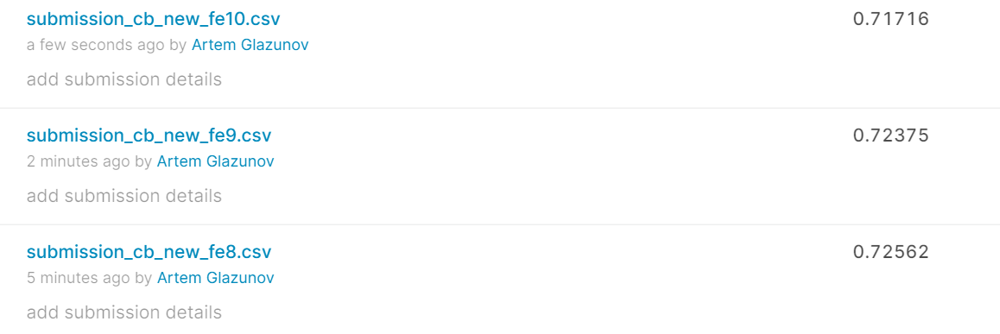

In [38]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8','submission_mean9',
             'submission_cb_new_fe8','submission_cb_new_fe9']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean10.csv')

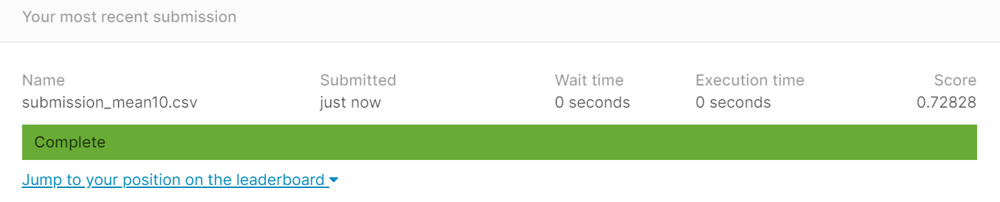

In [20]:
def categ_fe_interaction(dataset, max_feats = 10,cat_columns=[]):
  #Создает признаки на основе парных комбинаций существующих
  dataset = dataset.copy()
  data = dataset[cat_columns]
  
  fe_list = []
 
  for comb in list(itertools.combinations(data.columns,2))[:max_feats]:
  
  
      feature = data[comb[0]].astype(str) + data[comb[1]].astype(str)
      feature.name = f'{comb[0]},{comb[1]}_mix'

      fe_list.append(pd.DataFrame(feature))
   
    
  if fe_list==[]:
    features = pd.DataFrame()
  else:
    features = pd.concat(fe_list,axis=1) 
  res_dataframe = pd.concat([dataset,features],axis=1)

  cat_columns_new = cat_columns + list(features.columns)


  return res_dataframe,cat_columns_new 

In [21]:
def metric_estimate_prediction(model,data_val,labels_val,cat_columns):
    
  prb = model.predict_proba(data_val)                                                                          
                                                                
  metric = roc_auc_score(labels_val.values,prb[:,1])

  return metric   




def feature_selection_loop_prediction(model,data_val,labels_val,cat_columns,threshold=1e-4):

  data_val = data_val.copy()

  metric_start = metric_estimate_prediction(model,data_val,labels_val,cat_columns)
  good_cat_columns = []
  good_num_columns = []
  diff_metric_without_fe = {}
  for col in tqdm_notebook(data_val.columns):

    data_permuted = data_val.copy()
    data_permuted[col] =  np.random.permutation(data_permuted[col].values)

    metric_fe_out = metric_estimate_prediction(model,data_permuted,labels_val,cat_columns)

    diff_metric = metric_fe_out - metric_start 
    diff_metric_without_fe[col] = diff_metric
    
    print('----------')   
    print(f'{col} diff_metric: {diff_metric}')
    print('----------')

    if diff_metric < -threshold*metric_start:

      if col in cat_columns:
        good_cat_columns.append(col)
        print('----------')
        print(f'good_cat_columns: {good_cat_columns}')

      else:
        good_num_columns.append(col)
        print('----------')
        print(f'good_num_columns: {good_num_columns}')

    gc.collect()

  return good_num_columns,good_cat_columns,diff_metric_without_fe

In [40]:
data_plus_new_num_train = normed_fe_interaction(feats_train[good_columns],level=2, max_feats = 100,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction(feats_val[good_columns],level=2, max_feats = 100,num_columns=num_columns)

data_plus_num_cat_train,cat_columns_new = categ_fe_interaction(data_plus_new_num_train, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_val = categ_fe_interaction(data_plus_new_num_val, max_feats = 100,cat_columns=cat_columns)[0]

data_train = cat_prep(data_plus_num_cat_train,cat_columns_new)
data_val = cat_prep(data_plus_num_cat_val,cat_columns_new)

data_train.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
6892,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.657125,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1395772.00,NaN,NaN,NaN,-18.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nanLM8l689qOp,nannan,nanQu4f,nanRAYp,nannan,nanDHeTmBftjz,nanRO12,nan7gSz,nan8ij6Lg8,nanLJF4fPp,nanBcur,nanZ5OU,nanNhsEn4L,nan7WwCtIM,nan1GbF,nan7OmVzos,nan76DJixu,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nanVpdQ,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanMtgm,nancJvF,nanAU8pNoi,nanoslk,nanLM8l689qOp
34821,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.117069,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,390151.60,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nannan,nannan,nanw_Ub,nanRAYp,nannan,nan2jigUH7ejg,nanRO12,nandm89,nanLG0vbUP,nann1zVHpT8NN,nan5FzM,nanDmlN,nanNhsEn4L,nanmAja5EA,nanFJ56cYO,nansE0uLpj,nanG9maF5M,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nan09_Q,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanL84s,nancJvF,nannan,nanoslk,nannan
34190,98.0,0.0,152.0,190.0,0.0,64.0,86.96,4107204.0,2.271523,14,0.0,691200.0,147468.60,25.0,10.0,252417.0,24.0,8.0,-150260.80,315.0,66.0,0.0,-26.0,1585040.0,728196.0,0.0,0.0,8437160.0,16.0,1426026.0,NaN,0.0,5.0,0.0,18.0,6.0,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0Qu4f,5.0RAYp,5.0nan,5.0zcRZptzip9,5.0RO12,5.0USOt,5.0pro8v8X,5.0CsjH_hi,5.0rUBc,5.0t_4G,5.0NhsEn4L,5.0mAjDcoz,5.0xYrN,5.0meWVy8V,5.0DQ3u3MC,5.0F2FyR07IdsN7I,0.018.0,0.06.0,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0sBgB,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
24541,938.0,520.0,148.0,185.0,2.0,96.0,186.64,749586.0,0.714591,160,77.0,2013720.0,100805.70,5.0,10.0,168123.0,48.0,32.0,32282.84,600.0,30.0,68571.0,NaN,3873950.0,2044820.0,4160.0,604800.0,10517440.0,20.0,2592000.0,NaN,7.0,0.0,0.0,18.0,6.0,0.0,0.0,0.0,18.0,...,0.0zCkv,0.0jySVZNlOJy,0.0ELof,0.0WqMG,0.0ZI9m,0.0mj86,0.0mzKvyx8zhV,0.02Knk1KF,0.0vSNn,0.0fhk21Ss,0.0Hz673939hSRjL,0.0W9XQ,0.0QMes,0.0Ie_5MZs,0.0XTbjhEX,0.0F6F0,0.04UxGlow,0.0catzS2D,0.0TCU50_Yjmm6GIBZ0lL_,0.018.0,0.06.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0wMei,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0zCkv,0.0jySVZNlOJy
31483,602.0,88.0,0.0,0.0,NaN,0.0,166.56,0.0,3.250160,30,0.0,0.0,6388.71,0.0,0.0,1194.0,NaN,0.0,81176.80,100.0,0.0,9657.0,4.0,0.0,0.0,385.0,NaN,0.0,0.0,0.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,0.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0RAYp,0.0nan,0.0639qrQK2Mx,0.0RO12,0.0AHgj,0.0creg0bq,0.05q1hF23,0.06Yf9,0.015m3,0.0NhsEn4L,0.0mAjbk_S,0.0oLcf,0.0VgKv48t,0.0nRgz4Af,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0sJzTlal,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5430850	test: 0.5344066	best: 0.5344066 (0)	total: 350ms	remaining: 2m 12s
10:	learn: 0.5712767	test: 0.5797211	best: 0.5805307 (6)	total: 3.25s	remaining: 1m 48s
20:	learn: 0.5772293	test: 0.5859278	best: 0.5866229 (17)	total: 6.15s	remaining: 1m 45s
30:	learn: 0.6685320	test: 0.6664833	best: 0.6664833 (30)	total: 8.99s	remaining: 1m 41s
40:	learn: 0.7082075	test: 0.7016789	best: 0.7016789 (40)	total: 12.3s	remaining: 1m 41s
50:	learn: 0.7215861	test: 0.7131334	best: 0.7131334 (50)	total: 15.7s	remaining: 1m 41s
60:	learn: 0.7276231	test: 0.7164901	best: 0.7169411 (58)	total: 19.1s	remaining: 1m 39s
70:	learn: 0.7357169	test: 0.7223550	best: 0.7223550 (70)	total: 22.4s	remaining: 1m 37s
80:	learn: 0.7402230	test: 0.7237323	best: 0.7237323 (80)	total: 25.8s	remaining: 1m 35s
90:	learn: 0.7438513	test: 0.7261963	best: 0.7261963 (90)	total: 28.9s	remaining: 1m 31s
100:	learn: 0.7475068	test: 0.7266419	best: 0.7266419 (100)	total: 32.2s	remaining: 1m 28s
110:	learn: 0.7502545	

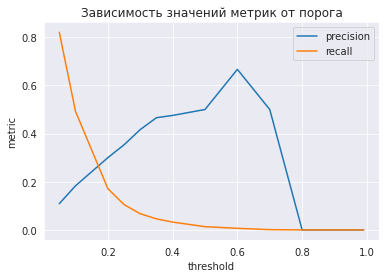

In [42]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )


estimator_cb.fit(data_train, labels_train, cat_features = cat_columns_new,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))
prb = estimator_cb.predict_proba(data_val)                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val)
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [43]:
data_plus_new_num = normed_fe_interaction(features[good_columns],level=2, max_feats = 100,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction(test_data[good_columns],level=2, max_feats = 100,num_columns=num_columns)

data_plus_num_cat,cat_columns_new = categ_fe_interaction(data_plus_new_num, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_test = categ_fe_interaction(data_plus_new_num_test, max_feats = 100,cat_columns=cat_columns)[0]

data = cat_prep(data_plus_num_cat,cat_columns_new)
data_test = cat_prep(data_plus_num_cat_test,cat_columns_new)

data.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
0,3052.0,NaN,480.0,600.0,20.0,480.0,200.00,82752.0,2.907926,34,NaN,716008.0,14599.92,5.0,32.0,NaN,144.0,144.0,-1209960.0,1660.0,66.0,NaN,4.0,326915.0,604276.0,NaN,389396.0,2313888.0,28.0,599532.0,NaN,nan,0.0,0.0,nan,nan,0.0,0.0,0.0,9.0,...,0.0Al6ZaUT,0.0LM8l689qOp,0.0nan,0.0fKCe,0.002N6s8f,0.0nan,0.0NESt0G8EIb,0.0AERks4l,0.00LaQ,0.0UaKK0yW,0.0I1sFbv_0IT,0.0EkHG,0.0k13i,0.0JBfYVit4g8,0.0TDctq2l,0.0KmRo,0.0hLKtJ9p,0.0vr93T2a,0.0xwM2aC7IdeMC0,0.0nan,0.0nan,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.009_Q,0.0IYzP,0.0GjJ35utlTa_GNSvxxpb9ju,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0Al6ZaUT,0.0LM8l689qOp
1,1813.0,636.0,212.0,265.0,2.0,128.0,166.56,2706120.0,5.870327,128,0.0,1661128.0,67529.09,25.0,10.0,32289.0,80.0,72.0,417932.0,1025.0,66.0,24912.0,40.0,1934460.0,349568.0,205.0,735.0,6502680.0,14.0,364182.0,276.0,7.0,0.0,0.0,27.0,3.0,0.0,0.0,0.0,18.0,...,0.0oslk,0.0LM8l689qOp,0.0ELof,0.0xb3V,0.0RAYp,0.0mj86,0.0P1WvyxLp3Z,0.02Knk1KF,0.0YFAj,0.0Bnunsla,0.0o64y9zI,0.0JDd6,0.0FbIm,0.0XfqtO3UdzaXh_,0.0XTbqizz,0.0qMoY,0.0hN8KpA1,0.06hQ9lNX,0.055YFVY9,0.027.0,0.03.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0haYg,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
2,1953.0,448.0,176.0,220.0,0.0,72.0,311.76,4698780.0,5.981628,166,245.0,3025152.0,85266.00,35.0,0.0,53388.0,40.0,48.0,-124655.2,590.0,78.0,7218.0,36.0,3148410.0,1086210.0,400.0,0.0,10569040.0,18.0,0.0,NaN,7.0,0.0,0.0,18.0,3.0,0.0,0.0,0.0,27.0,...,0.0zCkv,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0ZI9m,0.0mj86,0.0FoxgUHSK8h,0.0LrdZy8QqgUfkVShG,0.0TyGl,0.0fhk21Ss,0.0nQUveAzAF7,0.0dnwD,0.0mTeA,0.04kVnq_T26xq1p,0.0pMWBUmQ,0.0qLXr,0.04UxGlow,0.0catzS2D,0.0ib5G6X1eUxUn6,0.018.0,0.03.0,0.00.0,0.00.0,0.00.0,0.027.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0hAFG,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0UYBR,0.0FzaX,0.0zCkv,0.0LM8l689qOp
3,1533.0,4.0,332.0,415.0,0.0,144.0,220.08,864384.0,5.108097,30,0.0,2642240.0,74107.20,10.0,2.0,NaN,32.0,32.0,378473.6,1435.0,24.0,693.0,NaN,7066700.0,650390.0,5.0,0.0,9676200.0,108.0,253284.0,NaN,7.0,5.0,0.0,9.0,nan,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0xb3V,5.0RAYp,5.0nan,5.0vNEvyxLp3Z,5.0RO12,5.00Xwj,5.0uoZk2Zj,5.0LWyxgtXeJL,5.0CwmB,5.0vzJD,5.0NhsEn4L,5.0kZJtVhC,5.0JC0e,5.0ylCK5YS,5.0e4lqvY0,5.0F2FyR07IdsN7I,0.09.0,0.0nan,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.0F3hy,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
4,686.0,0.0,160.0,200.0,2.0,48.0,278.00,4364880.0,0.650716,32,0.0,1440.0,171072.90,25.0,12.0,106455.0,32.0,8.0,142602.4,490.0,60.0,468.0,-28.0,3794460.0,642816.0,225.0,554414.0,10535200.0,24.0,2851284.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,9.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0WqMG,0.0RAYp,0.0nan,0.04e7gUH7IEC,0.0RO12,0.0vSNn,0.0kugYdIL,0.0ZIXKpoNpqq,0.0625Z,0.0m_h1,0.0NhsEn4L,0.0NGZXfGp,0.0064o,0.0PYpzAu9,0.0MAz3HNj,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0

In [45]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data, labels, cat_features = cat_columns_new,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test)
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final1.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5663509	total: 295ms	remaining: 1m 51s
10:	learn: 0.5834329	total: 3.1s	remaining: 1m 43s
20:	learn: 0.5870177	total: 5.97s	remaining: 1m 42s
30:	learn: 0.6619694	total: 9.03s	remaining: 1m 41s
40:	learn: 0.6969404	total: 12.2s	remaining: 1m 41s
50:	learn: 0.7083168	total: 15.5s	remaining: 1m 40s
60:	learn: 0.7177288	total: 18.8s	remaining: 1m 38s
70:	learn: 0.7245206	total: 21.9s	remaining: 1m 35s
80:	learn: 0.7308877	total: 25.2s	remaining: 1m 33s
90:	learn: 0.7358207	total: 28.6s	remaining: 1m 30s
100:	learn: 0.7391955	total: 31.8s	remaining: 1m 27s
110:	learn: 0.7421244	total: 35.1s	remaining: 1m 24s
120:	learn: 0.7462179	total: 38.3s	remaining: 1m 22s
130:	learn: 0.7485546	total: 41.5s	remaining: 1m 18s
140:	learn: 0.7507052	total: 44.7s	remaining: 1m 15s
150:	learn: 0.7524530	total: 47.7s	remaining: 1m 12s
160:	learn: 0.7532978	total: 50.7s	remaining: 1m 8s
170:	learn: 0.7545121	total: 53.8s	remaining: 1m 5s
180:	learn: 0.7555951	total: 56.7s	remaining: 1m 2s
190:	lea

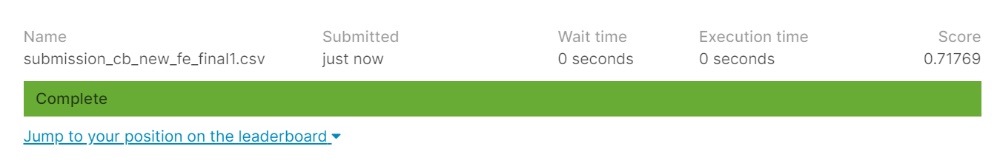

In [47]:
data_plus_new_num_train = normed_fe_interaction_2_3_4_5(feats_train[good_columns],max_feats = 100,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction_2_3_4_5(feats_val[good_columns],max_feats = 100,num_columns=num_columns)

data_plus_num_cat_train,cat_columns_new = categ_fe_interaction(data_plus_new_num_train, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_val = categ_fe_interaction(data_plus_new_num_val, max_feats = 100,cat_columns=cat_columns)[0]

data_train = cat_prep(data_plus_num_cat_train,cat_columns_new)
data_val = cat_prep(data_plus_num_cat_val,cat_columns_new)

data_train.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
6892,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.657125,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1395772.00,NaN,NaN,NaN,-18.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nanLM8l689qOp,nannan,nanQu4f,nanRAYp,nannan,nanDHeTmBftjz,nanRO12,nan7gSz,nan8ij6Lg8,nanLJF4fPp,nanBcur,nanZ5OU,nanNhsEn4L,nan7WwCtIM,nan1GbF,nan7OmVzos,nan76DJixu,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nanVpdQ,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanMtgm,nancJvF,nanAU8pNoi,nanoslk,nanLM8l689qOp
34821,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.117069,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,390151.60,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nannan,nannan,nanw_Ub,nanRAYp,nannan,nan2jigUH7ejg,nanRO12,nandm89,nanLG0vbUP,nann1zVHpT8NN,nan5FzM,nanDmlN,nanNhsEn4L,nanmAja5EA,nanFJ56cYO,nansE0uLpj,nanG9maF5M,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nan09_Q,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanL84s,nancJvF,nannan,nanoslk,nannan
34190,98.0,0.0,152.0,190.0,0.0,64.0,86.96,4107204.0,2.271523,14,0.0,691200.0,147468.60,25.0,10.0,252417.0,24.0,8.0,-150260.80,315.0,66.0,0.0,-26.0,1585040.0,728196.0,0.0,0.0,8437160.0,16.0,1426026.0,NaN,0.0,5.0,0.0,18.0,6.0,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0Qu4f,5.0RAYp,5.0nan,5.0zcRZptzip9,5.0RO12,5.0USOt,5.0pro8v8X,5.0CsjH_hi,5.0rUBc,5.0t_4G,5.0NhsEn4L,5.0mAjDcoz,5.0xYrN,5.0meWVy8V,5.0DQ3u3MC,5.0F2FyR07IdsN7I,0.018.0,0.06.0,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0sBgB,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
24541,938.0,520.0,148.0,185.0,2.0,96.0,186.64,749586.0,0.714591,160,77.0,2013720.0,100805.70,5.0,10.0,168123.0,48.0,32.0,32282.84,600.0,30.0,68571.0,NaN,3873950.0,2044820.0,4160.0,604800.0,10517440.0,20.0,2592000.0,NaN,7.0,0.0,0.0,18.0,6.0,0.0,0.0,0.0,18.0,...,0.0zCkv,0.0jySVZNlOJy,0.0ELof,0.0WqMG,0.0ZI9m,0.0mj86,0.0mzKvyx8zhV,0.02Knk1KF,0.0vSNn,0.0fhk21Ss,0.0Hz673939hSRjL,0.0W9XQ,0.0QMes,0.0Ie_5MZs,0.0XTbjhEX,0.0F6F0,0.04UxGlow,0.0catzS2D,0.0TCU50_Yjmm6GIBZ0lL_,0.018.0,0.06.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0wMei,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0zCkv,0.0jySVZNlOJy
31483,602.0,88.0,0.0,0.0,NaN,0.0,166.56,0.0,3.250160,30,0.0,0.0,6388.71,0.0,0.0,1194.0,NaN,0.0,81176.80,100.0,0.0,9657.0,4.0,0.0,0.0,385.0,NaN,0.0,0.0,0.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,0.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0RAYp,0.0nan,0.0639qrQK2Mx,0.0RO12,0.0AHgj,0.0creg0bq,0.05q1hF23,0.06Yf9,0.015m3,0.0NhsEn4L,0.0mAjbk_S,0.0oLcf,0.0VgKv48t,0.0nRgz4Af,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0sJzTlal,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp


In [50]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train, labels_train, cat_features = cat_columns_new,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5382635	test: 0.5467659	best: 0.5467659 (0)	total: 411ms	remaining: 2m 35s
10:	learn: 0.5693869	test: 0.5804114	best: 0.5804286 (7)	total: 3.45s	remaining: 1m 55s
20:	learn: 0.5804643	test: 0.5828246	best: 0.5833173 (18)	total: 6.7s	remaining: 1m 54s
30:	learn: 0.6618924	test: 0.6572264	best: 0.6572264 (30)	total: 10s	remaining: 1m 52s
40:	learn: 0.7029517	test: 0.6972320	best: 0.6972320 (40)	total: 13.8s	remaining: 1m 53s
50:	learn: 0.7189406	test: 0.7103220	best: 0.7103220 (50)	total: 17.4s	remaining: 1m 52s
60:	learn: 0.7278008	test: 0.7160044	best: 0.7162795 (58)	total: 21.2s	remaining: 1m 50s
70:	learn: 0.7362452	test: 0.7207040	best: 0.7207040 (70)	total: 24.8s	remaining: 1m 47s
80:	learn: 0.7411616	test: 0.7222482	best: 0.7227125 (76)	total: 28.4s	remaining: 1m 44s
90:	learn: 0.7453193	test: 0.7242687	best: 0.7242687 (90)	total: 32s	remaining: 1m 41s
100:	learn: 0.7499150	test: 0.7258942	best: 0.7258942 (100)	total: 35.7s	remaining: 1m 38s
110:	learn: 0.7521745	test:

In [58]:
import gc

In [59]:
feature_selection_loop_prediction(estimator_cb,data_val,labels_val,cat_columns_new,threshold=1e-4)

----------
Var6 diff_metric: 0.0
----------
----------
Var13 diff_metric: -0.0004615593547887542
----------
----------
good_num_columns: ['Var13']
----------
Var21 diff_metric: 0.0
----------
----------
Var22 diff_metric: 0.0
----------
----------
Var24 diff_metric: 0.0
----------
----------
Var25 diff_metric: 0.0
----------
----------
Var28 diff_metric: 0.0
----------
----------
Var38 diff_metric: 0.0
----------
----------
Var57 diff_metric: 0.0
----------
----------
Var73 diff_metric: -0.0016938966185686688
----------
----------
good_num_columns: ['Var13', 'Var73']
----------
Var74 diff_metric: -0.0018407930755208746
----------
----------
good_num_columns: ['Var13', 'Var73', 'Var74']
----------
Var76 diff_metric: 0.0
----------
----------
Var81 diff_metric: -0.001946856955214682
----------
----------
good_num_columns: ['Var13', 'Var73', 'Var74', 'Var81']
----------
Var83 diff_metric: 0.0
----------
----------
Var85 diff_metric: 0.0
----------
----------
Var94 diff_metric: 0.0
-------

(['Var13',
  'Var73',
  'Var74',
  'Var81',
  'Var113',
  'Var126',
  'Var189',
  'Var6,Var126_mix',
  'Var13,Var28_mix',
  'Var13,Var38_mix',
  'Var13,Var109_mix',
  'Var13,Var126_mix',
  'Var13,Var189_mix',
  'Var21,Var126_mix',
  'Var21,Var133_mix',
  'Var6,Var21,Var153_mix',
  'Var6,Var24,Var28_mix',
  'Var6,Var24,Var76_mix',
  'Var6,Var13,Var24,Var126_mix',
  'Var6,Var13,Var25,Var28_mix',
  'Var6,Var13,Var25,Var57_mix',
  'Var6,Var13,Var21,Var24,Var126_mix',
  'Var6,Var13,Var21,Var28,Var126_mix'],
 ['Var132',
  'Var205',
  'Var206',
  'Var210',
  'Var219',
  'Var192',
  'Var199',
  'Var204',
  'Var217',
  'Var7,Var65_mix',
  'Var7,Var218_mix',
  'Var7,Var219_mix',
  'Var7,Var221_mix',
  'Var7,Var192_mix',
  'Var7,Var193_mix',
  'Var7,Var199_mix',
  'Var7,Var202_mix',
  'Var7,Var212_mix',
  'Var7,Var216_mix',
  'Var7,Var217_mix',
  'Var7,Var220_mix',
  'Var35,Var181_mix',
  'Var35,Var205_mix',
  'Var35,Var208_mix',
  'Var35,Var210_mix',
  'Var35,Var218_mix',
  'Var35,Var219_mix',
 

In [63]:
num_cols_selected = ['Var13',
  'Var73',
  'Var74',
  'Var81',
  'Var113',
  'Var126',
  'Var189',
  'Var6,Var126_mix',
  'Var13,Var28_mix',
  'Var13,Var38_mix',
  'Var13,Var109_mix',
  'Var13,Var126_mix',
  'Var13,Var189_mix',
  'Var21,Var126_mix',
  'Var21,Var133_mix',
  'Var6,Var21,Var153_mix',
  'Var6,Var24,Var28_mix',
  'Var6,Var24,Var76_mix',
  'Var6,Var13,Var24,Var126_mix',
  'Var6,Var13,Var25,Var28_mix',
  'Var6,Var13,Var25,Var57_mix',
  'Var6,Var13,Var21,Var24,Var126_mix',
  'Var6,Var13,Var21,Var28,Var126_mix']

In [61]:
 cat_cols_selected = ['Var132',
  'Var205',
  'Var206',
  'Var210',
  'Var219',
  'Var192',
  'Var199',
  'Var204',
  'Var217',
  'Var7,Var65_mix',
  'Var7,Var218_mix',
  'Var7,Var219_mix',
  'Var7,Var221_mix',
  'Var7,Var192_mix',
  'Var7,Var193_mix',
  'Var7,Var199_mix',
  'Var7,Var202_mix',
  'Var7,Var212_mix',
  'Var7,Var216_mix',
  'Var7,Var217_mix',
  'Var7,Var220_mix',
  'Var35,Var181_mix',
  'Var35,Var205_mix',
  'Var35,Var208_mix',
  'Var35,Var210_mix',
  'Var35,Var218_mix',
  'Var35,Var219_mix',
  'Var35,Var225_mix',
  'Var35,Var229_mix',
  'Var35,Var192_mix',
  'Var35,Var193_mix',
  'Var35,Var199_mix',
  'Var35,Var202_mix',
  'Var35,Var222_mix',
  'Var35,Var228_mix',
  'Var44,Var78_mix',
  'Var44,Var203_mix',
  'Var44,Var206_mix',
  'Var44,Var210_mix',
  'Var44,Var218_mix',
  'Var44,Var219_mix',
  'Var44,Var223_mix']

In [64]:
good_columns2 = cat_cols_selected + num_cols_selected

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5519452	test: 0.5560269	best: 0.5560269 (0)	total: 153ms	remaining: 58.2s
10:	learn: 0.5786859	test: 0.5815250	best: 0.5821655 (6)	total: 1.5s	remaining: 50.3s
20:	learn: 0.5794672	test: 0.5814785	best: 0.5823294 (16)	total: 2.83s	remaining: 48.4s
30:	learn: 0.6601694	test: 0.6568312	best: 0.6568312 (30)	total: 4.31s	remaining: 48.6s
40:	learn: 0.7020219	test: 0.6953762	best: 0.6953762 (40)	total: 5.88s	remaining: 48.7s
50:	learn: 0.7229486	test: 0.7110304	best: 0.7110304 (50)	total: 7.56s	remaining: 48.8s
60:	learn: 0.7316695	test: 0.7179956	best: 0.7179956 (60)	total: 9.24s	remaining: 48.3s
70:	learn: 0.7378988	test: 0.7220899	best: 0.7220899 (70)	total: 10.8s	remaining: 47.1s
80:	learn: 0.7418731	test: 0.7236800	best: 0.7242329 (77)	total: 12.4s	remaining: 45.8s
90:	learn: 0.7466585	test: 0.7258348	best: 0.7258348 (90)	total: 14.1s	remaining: 44.8s
100:	learn: 0.7490828	test: 0.7273776	best: 0.7273939 (99)	total: 15.7s	remaining: 43.4s
110:	learn: 0.7507576	test: 0.72814

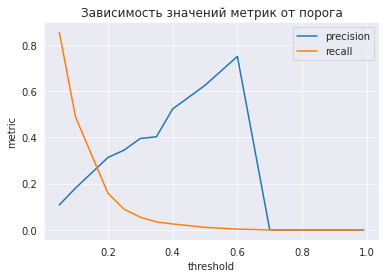

In [65]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train[good_columns2], labels_train, cat_features = cat_cols_selected,verbose=10, plot=True,
                 eval_set = (data_val[good_columns2], labels_val))

prb = estimator_cb.predict_proba(data_val[good_columns2])                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val[good_columns2])
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [66]:
data_plus_new_num = normed_fe_interaction_2_3_4_5(features[good_columns], max_feats = 100,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction_2_3_4_5(test_data[good_columns], max_feats = 100,num_columns=num_columns)

data_plus_num_cat,cat_columns_new = categ_fe_interaction(data_plus_new_num, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_test = categ_fe_interaction(data_plus_new_num_test, max_feats = 100,cat_columns=cat_columns)[0]

data = cat_prep(data_plus_num_cat,cat_columns_new)
data_test = cat_prep(data_plus_num_cat_test,cat_columns_new)

data.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
0,3052.0,NaN,480.0,600.0,20.0,480.0,200.00,82752.0,2.907926,34,NaN,716008.0,14599.92,5.0,32.0,NaN,144.0,144.0,-1209960.0,1660.0,66.0,NaN,4.0,326915.0,604276.0,NaN,389396.0,2313888.0,28.0,599532.0,NaN,nan,0.0,0.0,nan,nan,0.0,0.0,0.0,9.0,...,0.0Al6ZaUT,0.0LM8l689qOp,0.0nan,0.0fKCe,0.002N6s8f,0.0nan,0.0NESt0G8EIb,0.0AERks4l,0.00LaQ,0.0UaKK0yW,0.0I1sFbv_0IT,0.0EkHG,0.0k13i,0.0JBfYVit4g8,0.0TDctq2l,0.0KmRo,0.0hLKtJ9p,0.0vr93T2a,0.0xwM2aC7IdeMC0,0.0nan,0.0nan,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.009_Q,0.0IYzP,0.0GjJ35utlTa_GNSvxxpb9ju,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0Al6ZaUT,0.0LM8l689qOp
1,1813.0,636.0,212.0,265.0,2.0,128.0,166.56,2706120.0,5.870327,128,0.0,1661128.0,67529.09,25.0,10.0,32289.0,80.0,72.0,417932.0,1025.0,66.0,24912.0,40.0,1934460.0,349568.0,205.0,735.0,6502680.0,14.0,364182.0,276.0,7.0,0.0,0.0,27.0,3.0,0.0,0.0,0.0,18.0,...,0.0oslk,0.0LM8l689qOp,0.0ELof,0.0xb3V,0.0RAYp,0.0mj86,0.0P1WvyxLp3Z,0.02Knk1KF,0.0YFAj,0.0Bnunsla,0.0o64y9zI,0.0JDd6,0.0FbIm,0.0XfqtO3UdzaXh_,0.0XTbqizz,0.0qMoY,0.0hN8KpA1,0.06hQ9lNX,0.055YFVY9,0.027.0,0.03.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0haYg,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
2,1953.0,448.0,176.0,220.0,0.0,72.0,311.76,4698780.0,5.981628,166,245.0,3025152.0,85266.00,35.0,0.0,53388.0,40.0,48.0,-124655.2,590.0,78.0,7218.0,36.0,3148410.0,1086210.0,400.0,0.0,10569040.0,18.0,0.0,NaN,7.0,0.0,0.0,18.0,3.0,0.0,0.0,0.0,27.0,...,0.0zCkv,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0ZI9m,0.0mj86,0.0FoxgUHSK8h,0.0LrdZy8QqgUfkVShG,0.0TyGl,0.0fhk21Ss,0.0nQUveAzAF7,0.0dnwD,0.0mTeA,0.04kVnq_T26xq1p,0.0pMWBUmQ,0.0qLXr,0.04UxGlow,0.0catzS2D,0.0ib5G6X1eUxUn6,0.018.0,0.03.0,0.00.0,0.00.0,0.00.0,0.027.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0hAFG,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0UYBR,0.0FzaX,0.0zCkv,0.0LM8l689qOp
3,1533.0,4.0,332.0,415.0,0.0,144.0,220.08,864384.0,5.108097,30,0.0,2642240.0,74107.20,10.0,2.0,NaN,32.0,32.0,378473.6,1435.0,24.0,693.0,NaN,7066700.0,650390.0,5.0,0.0,9676200.0,108.0,253284.0,NaN,7.0,5.0,0.0,9.0,nan,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0xb3V,5.0RAYp,5.0nan,5.0vNEvyxLp3Z,5.0RO12,5.00Xwj,5.0uoZk2Zj,5.0LWyxgtXeJL,5.0CwmB,5.0vzJD,5.0NhsEn4L,5.0kZJtVhC,5.0JC0e,5.0ylCK5YS,5.0e4lqvY0,5.0F2FyR07IdsN7I,0.09.0,0.0nan,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.0F3hy,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
4,686.0,0.0,160.0,200.0,2.0,48.0,278.00,4364880.0,0.650716,32,0.0,1440.0,171072.90,25.0,12.0,106455.0,32.0,8.0,142602.4,490.0,60.0,468.0,-28.0,3794460.0,642816.0,225.0,554414.0,10535200.0,24.0,2851284.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,9.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0WqMG,0.0RAYp,0.0nan,0.04e7gUH7IEC,0.0RO12,0.0vSNn,0.0kugYdIL,0.0ZIXKpoNpqq,0.0625Z,0.0m_h1,0.0NhsEn4L,0.0NGZXfGp,0.0064o,0.0PYpzAu9,0.0MAz3HNj,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0

In [67]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=210,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data[good_columns2], labels, cat_features = cat_cols_selected,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test[good_columns2])
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final2_selected_fe.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5598995	total: 155ms	remaining: 32.3s
10:	learn: 0.5849296	total: 1.52s	remaining: 27.6s
20:	learn: 0.5852466	total: 2.8s	remaining: 25.2s
30:	learn: 0.6562598	total: 4.23s	remaining: 24.4s
40:	learn: 0.6972492	total: 5.78s	remaining: 23.8s
50:	learn: 0.7155094	total: 7.35s	remaining: 22.9s
60:	learn: 0.7216443	total: 8.9s	remaining: 21.7s
70:	learn: 0.7267132	total: 10.4s	remaining: 20.4s
80:	learn: 0.7314711	total: 12s	remaining: 19.1s
90:	learn: 0.7351927	total: 13.5s	remaining: 17.7s
100:	learn: 0.7400613	total: 15.1s	remaining: 16.3s
110:	learn: 0.7445844	total: 16.7s	remaining: 14.9s
120:	learn: 0.7476029	total: 18.3s	remaining: 13.4s
130:	learn: 0.7498043	total: 19.9s	remaining: 12s
140:	learn: 0.7508988	total: 21.4s	remaining: 10.5s
150:	learn: 0.7527474	total: 22.9s	remaining: 8.94s
160:	learn: 0.7544369	total: 24.4s	remaining: 7.42s
170:	learn: 0.7551470	total: 25.9s	remaining: 5.9s
180:	learn: 0.7559664	total: 27.3s	remaining: 4.38s
190:	learn: 0.7565430	total: 2

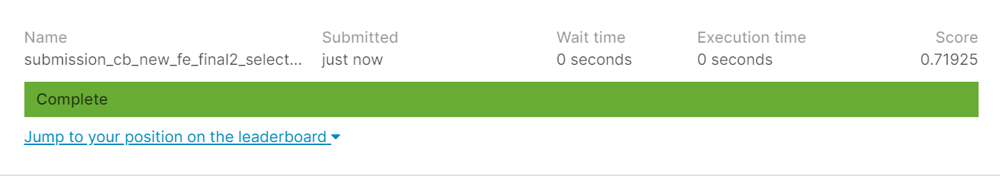

In [68]:
data_plus_new_num_train = normed_fe_interaction_2_3_4_5(feats_train[good_columns],max_feats = 100,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction_2_3_4_5(feats_val[good_columns],max_feats = 100,num_columns=num_columns)

data_plus_num_cat_train,cat_columns_new = categ_fe_interaction(data_plus_new_num_train, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_val = categ_fe_interaction(data_plus_new_num_val, max_feats = 100,cat_columns=cat_columns)[0]

data_train = cat_prep(data_plus_num_cat_train,cat_columns_new)
data_val = cat_prep(data_plus_num_cat_val,cat_columns_new)

data_train.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
6892,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.657125,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-1395772.00,NaN,NaN,NaN,-18.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nanLM8l689qOp,nannan,nanQu4f,nanRAYp,nannan,nanDHeTmBftjz,nanRO12,nan7gSz,nan8ij6Lg8,nanLJF4fPp,nanBcur,nanZ5OU,nanNhsEn4L,nan7WwCtIM,nan1GbF,nan7OmVzos,nan76DJixu,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nanVpdQ,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanMtgm,nancJvF,nanAU8pNoi,nanoslk,nanLM8l689qOp
34821,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.117069,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,390151.60,NaN,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan,nan,nan,...,nanoslk,nannan,nannan,nanw_Ub,nanRAYp,nannan,nan2jigUH7ejg,nanRO12,nandm89,nanLG0vbUP,nann1zVHpT8NN,nan5FzM,nanDmlN,nanNhsEn4L,nanmAja5EA,nanFJ56cYO,nansE0uLpj,nanG9maF5M,nanF2FyR07IdsN7I,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nannan,nantaul,nan1K8T,nan9_Y1,nan09_Q,nannan,nanme75fM6ugJ,nankIsH,nanuKAI,nanL84s,nancJvF,nannan,nanoslk,nannan
34190,98.0,0.0,152.0,190.0,0.0,64.0,86.96,4107204.0,2.271523,14,0.0,691200.0,147468.60,25.0,10.0,252417.0,24.0,8.0,-150260.80,315.0,66.0,0.0,-26.0,1585040.0,728196.0,0.0,0.0,8437160.0,16.0,1426026.0,NaN,0.0,5.0,0.0,18.0,6.0,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0Qu4f,5.0RAYp,5.0nan,5.0zcRZptzip9,5.0RO12,5.0USOt,5.0pro8v8X,5.0CsjH_hi,5.0rUBc,5.0t_4G,5.0NhsEn4L,5.0mAjDcoz,5.0xYrN,5.0meWVy8V,5.0DQ3u3MC,5.0F2FyR07IdsN7I,0.018.0,0.06.0,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0sBgB,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
24541,938.0,520.0,148.0,185.0,2.0,96.0,186.64,749586.0,0.714591,160,77.0,2013720.0,100805.70,5.0,10.0,168123.0,48.0,32.0,32282.84,600.0,30.0,68571.0,NaN,3873950.0,2044820.0,4160.0,604800.0,10517440.0,20.0,2592000.0,NaN,7.0,0.0,0.0,18.0,6.0,0.0,0.0,0.0,18.0,...,0.0zCkv,0.0jySVZNlOJy,0.0ELof,0.0WqMG,0.0ZI9m,0.0mj86,0.0mzKvyx8zhV,0.02Knk1KF,0.0vSNn,0.0fhk21Ss,0.0Hz673939hSRjL,0.0W9XQ,0.0QMes,0.0Ie_5MZs,0.0XTbjhEX,0.0F6F0,0.04UxGlow,0.0catzS2D,0.0TCU50_Yjmm6GIBZ0lL_,0.018.0,0.06.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0wMei,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0zCkv,0.0jySVZNlOJy
31483,602.0,88.0,0.0,0.0,NaN,0.0,166.56,0.0,3.250160,30,0.0,0.0,6388.71,0.0,0.0,1194.0,NaN,0.0,81176.80,100.0,0.0,9657.0,4.0,0.0,0.0,385.0,NaN,0.0,0.0,0.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,0.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0RAYp,0.0nan,0.0639qrQK2Mx,0.0RO12,0.0AHgj,0.0creg0bq,0.05q1hF23,0.06Yf9,0.015m3,0.0NhsEn4L,0.0mAjbk_S,0.0oLcf,0.0VgKv48t,0.0nRgz4Af,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0sJzTlal,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp


In [69]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train, labels_train, cat_features = cat_columns_new,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))



MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5382635	test: 0.5467659	best: 0.5467659 (0)	total: 412ms	remaining: 2m 36s
10:	learn: 0.5693869	test: 0.5804114	best: 0.5804286 (7)	total: 3.42s	remaining: 1m 54s
20:	learn: 0.5804643	test: 0.5828246	best: 0.5833173 (18)	total: 6.62s	remaining: 1m 53s
30:	learn: 0.6618924	test: 0.6572264	best: 0.6572264 (30)	total: 9.88s	remaining: 1m 51s
40:	learn: 0.7029517	test: 0.6972320	best: 0.6972320 (40)	total: 13.6s	remaining: 1m 52s
50:	learn: 0.7189406	test: 0.7103220	best: 0.7103220 (50)	total: 17.3s	remaining: 1m 51s
60:	learn: 0.7278008	test: 0.7160044	best: 0.7162795 (58)	total: 21s	remaining: 1m 49s
70:	learn: 0.7362452	test: 0.7207040	best: 0.7207040 (70)	total: 24.6s	remaining: 1m 47s
80:	learn: 0.7411616	test: 0.7222482	best: 0.7227125 (76)	total: 28.2s	remaining: 1m 44s
90:	learn: 0.7453185	test: 0.7242682	best: 0.7242682 (90)	total: 31.9s	remaining: 1m 41s
100:	learn: 0.7499139	test: 0.7258927	best: 0.7258927 (100)	total: 35.6s	remaining: 1m 38s
110:	learn: 0.7521747	te

In [70]:
num_cols_selected, cat_cols_selected ,importances = feature_selection_loop_prediction(estimator_cb,data_val,labels_val,cat_columns_new,threshold=0)

----------
Var6 diff_metric: 0.0
----------
----------
Var13 diff_metric: -5.1922906884271924e-05
----------
----------
good_num_columns: ['Var13']
----------
Var21 diff_metric: 0.0
----------
----------
Var22 diff_metric: 0.0
----------
----------
Var24 diff_metric: 0.0
----------
----------
Var25 diff_metric: 0.0
----------
----------
Var28 diff_metric: 0.0
----------
----------
Var38 diff_metric: 0.0
----------
----------
Var57 diff_metric: 0.0
----------
----------
Var73 diff_metric: -0.0012246748542201757
----------
----------
good_num_columns: ['Var13', 'Var73']
----------
Var74 diff_metric: -0.0014267204957660873
----------
----------
good_num_columns: ['Var13', 'Var73', 'Var74']
----------
Var76 diff_metric: 0.0
----------
----------
Var81 diff_metric: 0.0012629869020182038
----------
----------
Var83 diff_metric: 0.0
----------
----------
Var85 diff_metric: 0.0
----------
----------
Var94 diff_metric: 0.0
----------
----------
Var109 diff_metric: 0.0
----------
----------
Var1

In [71]:
good_columns2 = cat_cols_selected + num_cols_selected
len(good_columns2)

88

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5717896	test: 0.5725624	best: 0.5725624 (0)	total: 220ms	remaining: 1m 23s
10:	learn: 0.5753030	test: 0.5644728	best: 0.5725624 (0)	total: 2.01s	remaining: 1m 7s
20:	learn: 0.5793207	test: 0.5788289	best: 0.5788961 (19)	total: 3.81s	remaining: 1m 5s
30:	learn: 0.6475625	test: 0.6374274	best: 0.6374274 (30)	total: 5.64s	remaining: 1m 3s
40:	learn: 0.7030683	test: 0.6928180	best: 0.6928180 (40)	total: 7.65s	remaining: 1m 3s
50:	learn: 0.7172652	test: 0.7048878	best: 0.7048878 (50)	total: 9.64s	remaining: 1m 2s
60:	learn: 0.7291780	test: 0.7155506	best: 0.7155506 (60)	total: 11.7s	remaining: 1m 1s
70:	learn: 0.7356503	test: 0.7213190	best: 0.7213190 (70)	total: 13.9s	remaining: 1m
80:	learn: 0.7409525	test: 0.7246421	best: 0.7246421 (80)	total: 15.8s	remaining: 58.4s
90:	learn: 0.7440445	test: 0.7262865	best: 0.7262865 (90)	total: 17.8s	remaining: 56.5s
100:	learn: 0.7464353	test: 0.7266480	best: 0.7267088 (99)	total: 19.8s	remaining: 54.6s
110:	learn: 0.7495614	test: 0.728005

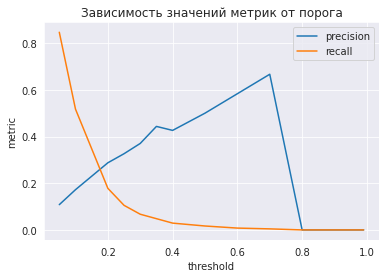

In [72]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train[good_columns2], labels_train, cat_features = cat_cols_selected,verbose=10, plot=True,
                 eval_set = (data_val[good_columns2], labels_val))

prb = estimator_cb.predict_proba(data_val[good_columns2])                                                                          
                                                                
print(f'ROC AUC: {roc_auc_score(labels_val.values,prb[:,1])}')    
print(f'PRC AUC: {average_precision_score(labels_val.values,prb[:,1])}')   
                                                                        
pred = estimator_cb.predict(data_val[good_columns2])
print(classification_report(labels_val,pred))  
print('------------------')
print('------------------')

pr_plot(labels_val.values,prb,[0.05,0.1,0.2,0.25,0.3,0.35,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.96,0.97,0.99])

In [73]:
data_plus_new_num = normed_fe_interaction_2_3_4_5(features[good_columns], max_feats = 100,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction_2_3_4_5(test_data[good_columns], max_feats = 100,num_columns=num_columns)

data_plus_num_cat,cat_columns_new = categ_fe_interaction(data_plus_new_num, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_test = categ_fe_interaction(data_plus_new_num_test, max_feats = 100,cat_columns=cat_columns)[0]

data = cat_prep(data_plus_num_cat,cat_columns_new)
data_test = cat_prep(data_plus_num_cat_test,cat_columns_new)

data.head()

,Var6,Var13,Var21,Var22,Var24,Var25,Var28,Var38,Var57,Var73,Var74,Var76,Var81,Var83,Var85,Var94,Var109,Var112,Var113,Var119,Var123,Var125,Var126,Var133,Var134,Var140,Var149,Var153,Var160,Var163,Var189,Var7,Var35,Var44,Var65,Var72,Var78,Var132,Var143,Var144,...,"Var35,Var221_mix","Var35,Var223_mix","Var35,Var225_mix","Var35,Var226_mix","Var35,Var227_mix","Var35,Var229_mix","Var35,Var192_mix","Var35,Var193_mix","Var35,Var197_mix","Var35,Var198_mix","Var35,Var199_mix","Var35,Var202_mix","Var35,Var204_mix","Var35,Var212_mix","Var35,Var216_mix","Var35,Var217_mix","Var35,Var220_mix","Var35,Var222_mix","Var35,Var228_mix","Var44,Var65_mix","Var44,Var72_mix","Var44,Var78_mix","Var44,Var132_mix","Var44,Var143_mix","Var44,Var144_mix","Var44,Var173_mix","Var44,Var181_mix","Var44,Var195_mix","Var44,Var196_mix","Var44,Var203_mix","Var44,Var205_mix","Var44,Var206_mix","Var44,Var207_mix","Var44,Var208_mix","Var44,Var210_mix","Var44,Var211_mix","Var44,Var218_mix","Var44,Var219_mix","Var44,Var221_mix","Var44,Var223_mix"
0,3052.0,NaN,480.0,600.0,20.0,480.0,200.00,82752.0,2.907926,34,NaN,716008.0,14599.92,5.0,32.0,NaN,144.0,144.0,-1209960.0,1660.0,66.0,NaN,4.0,326915.0,604276.0,NaN,389396.0,2313888.0,28.0,599532.0,NaN,nan,0.0,0.0,nan,nan,0.0,0.0,0.0,9.0,...,0.0Al6ZaUT,0.0LM8l689qOp,0.0nan,0.0fKCe,0.002N6s8f,0.0nan,0.0NESt0G8EIb,0.0AERks4l,0.00LaQ,0.0UaKK0yW,0.0I1sFbv_0IT,0.0EkHG,0.0k13i,0.0JBfYVit4g8,0.0TDctq2l,0.0KmRo,0.0hLKtJ9p,0.0vr93T2a,0.0xwM2aC7IdeMC0,0.0nan,0.0nan,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.009_Q,0.0IYzP,0.0GjJ35utlTa_GNSvxxpb9ju,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0Al6ZaUT,0.0LM8l689qOp
1,1813.0,636.0,212.0,265.0,2.0,128.0,166.56,2706120.0,5.870327,128,0.0,1661128.0,67529.09,25.0,10.0,32289.0,80.0,72.0,417932.0,1025.0,66.0,24912.0,40.0,1934460.0,349568.0,205.0,735.0,6502680.0,14.0,364182.0,276.0,7.0,0.0,0.0,27.0,3.0,0.0,0.0,0.0,18.0,...,0.0oslk,0.0LM8l689qOp,0.0ELof,0.0xb3V,0.0RAYp,0.0mj86,0.0P1WvyxLp3Z,0.02Knk1KF,0.0YFAj,0.0Bnunsla,0.0o64y9zI,0.0JDd6,0.0FbIm,0.0XfqtO3UdzaXh_,0.0XTbqizz,0.0qMoY,0.0hN8KpA1,0.06hQ9lNX,0.055YFVY9,0.027.0,0.03.0,0.00.0,0.00.0,0.00.0,0.018.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0haYg,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
2,1953.0,448.0,176.0,220.0,0.0,72.0,311.76,4698780.0,5.981628,166,245.0,3025152.0,85266.00,35.0,0.0,53388.0,40.0,48.0,-124655.2,590.0,78.0,7218.0,36.0,3148410.0,1086210.0,400.0,0.0,10569040.0,18.0,0.0,NaN,7.0,0.0,0.0,18.0,3.0,0.0,0.0,0.0,27.0,...,0.0zCkv,0.0LM8l689qOp,0.0nan,0.0FSa2,0.0ZI9m,0.0mj86,0.0FoxgUHSK8h,0.0LrdZy8QqgUfkVShG,0.0TyGl,0.0fhk21Ss,0.0nQUveAzAF7,0.0dnwD,0.0mTeA,0.04kVnq_T26xq1p,0.0pMWBUmQ,0.0qLXr,0.04UxGlow,0.0catzS2D,0.0ib5G6X1eUxUn6,0.018.0,0.03.0,0.00.0,0.00.0,0.00.0,0.027.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.09_Y1,0.0VpdQ,0.0hAFG,0.07M47J5GA0pTYIFxg5uy,0.0kIsH,0.0uKAI,0.0L84s,0.0UYBR,0.0FzaX,0.0zCkv,0.0LM8l689qOp
3,1533.0,4.0,332.0,415.0,0.0,144.0,220.08,864384.0,5.108097,30,0.0,2642240.0,74107.20,10.0,2.0,NaN,32.0,32.0,378473.6,1435.0,24.0,693.0,NaN,7066700.0,650390.0,5.0,0.0,9676200.0,108.0,253284.0,NaN,7.0,5.0,0.0,9.0,nan,0.0,8.0,0.0,0.0,...,5.0oslk,5.0LM8l689qOp,5.0nan,5.0xb3V,5.0RAYp,5.0nan,5.0vNEvyxLp3Z,5.0RO12,5.00Xwj,5.0uoZk2Zj,5.0LWyxgtXeJL,5.0CwmB,5.0vzJD,5.0NhsEn4L,5.0kZJtVhC,5.0JC0e,5.0ylCK5YS,5.0e4lqvY0,5.0F2FyR07IdsN7I,0.09.0,0.0nan,0.00.0,0.08.0,0.00.0,0.00.0,0.00.0,0.00.0,0.0taul,0.01K8T,0.0F3hy,0.0VpdQ,0.0IYzP,0.0me75fM6ugJ,0.0kIsH,0.0uKAI,0.0L84s,0.0cJvF,0.0FzaX,0.0oslk,0.0LM8l689qOp
4,686.0,0.0,160.0,200.0,2.0,48.0,278.00,4364880.0,0.650716,32,0.0,1440.0,171072.90,25.0,12.0,106455.0,32.0,8.0,142602.4,490.0,60.0,468.0,-28.0,3794460.0,642816.0,225.0,554414.0,10535200.0,24.0,2851284.0,NaN,7.0,0.0,0.0,9.0,3.0,0.0,0.0,0.0,9.0,...,0.0oslk,0.0LM8l689qOp,0.0nan,0.0WqMG,0.0RAYp,0.0nan,0.04e7gUH7IEC,0.0RO12,0.0vSNn,0.0kugYdIL,0.0ZIXKpoNpqq,0.0625Z,0.0m_h1,0.0NhsEn4L,0.0NGZXfGp,0.0064o,0.0PYpzAu9,0.0MAz3HNj,0.0F2FyR07IdsN7I,0.09.0,0.03.0,0.00.0,0.00.0,0.00.0,0.09.0,0.00.0

In [75]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=400,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data[good_columns2], labels, cat_features = cat_cols_selected,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test[good_columns2])
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final2_selected_fe2.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5737631	total: 174ms	remaining: 1m 9s
10:	learn: 0.5769892	total: 1.9s	remaining: 1m 7s
20:	learn: 0.5810241	total: 3.67s	remaining: 1m 6s
30:	learn: 0.6535859	total: 5.49s	remaining: 1m 5s
40:	learn: 0.6970335	total: 7.35s	remaining: 1m 4s
50:	learn: 0.7127644	total: 9.32s	remaining: 1m 3s
60:	learn: 0.7217209	total: 11.3s	remaining: 1m 2s
70:	learn: 0.7290931	total: 13.3s	remaining: 1m 1s
80:	learn: 0.7342558	total: 15.2s	remaining: 59.7s
90:	learn: 0.7372249	total: 17.1s	remaining: 58s
100:	learn: 0.7408932	total: 19s	remaining: 56.1s
110:	learn: 0.7432154	total: 20.9s	remaining: 54.4s
120:	learn: 0.7468387	total: 22.8s	remaining: 52.6s
130:	learn: 0.7483605	total: 24.7s	remaining: 50.7s
140:	learn: 0.7502678	total: 26.6s	remaining: 48.8s
150:	learn: 0.7525784	total: 28.4s	remaining: 46.9s
160:	learn: 0.7536437	total: 30.3s	remaining: 44.9s
170:	learn: 0.7544737	total: 32.1s	remaining: 43s
180:	learn: 0.7555454	total: 33.9s	remaining: 41s
190:	learn: 0.7563573	total: 35.

In [77]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8','submission_mean10']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean11.csv')

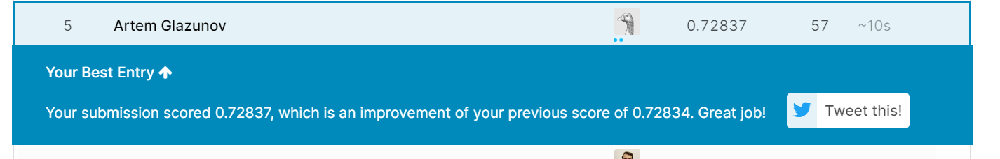

In [78]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8','submission_mean10','submission_mean11','submission_cb_new_fe_final2_selected_fe2']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean12.csv')

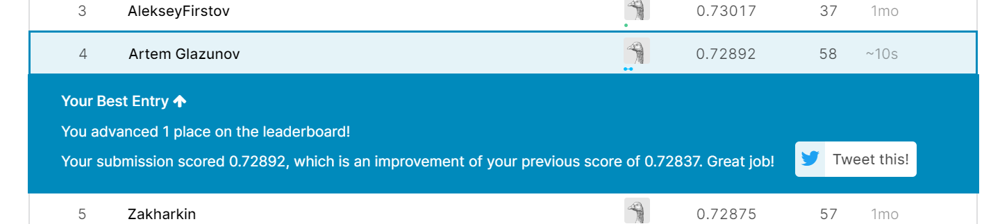

In [22]:
#Индексы значимых признаков полсле предобработки
[num_inds, cat_indices1,cat_indices2]= data_preprocessor(feats_train,params=[0.9, 0.7, 30])# params = [prop_nan,max_prop_unique,N_lim]
cat_columns = list(np.array(features.columns)[cat_indices1]) + list(np.array(features.columns)[cat_indices2])
num_columns = list(np.array(features.columns)[num_inds])
good_columns = num_columns + cat_columns

In [23]:
data_plus_new_num_train = normed_fe_interaction(feats_train[good_columns],level =2 ,max_feats = 100,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction(feats_val[good_columns],level =2, max_feats = 100,num_columns=num_columns)

data_train = cat_prep(data_plus_new_num_train,cat_columns)
data_val = cat_prep(data_plus_new_num_val,cat_columns)

In [24]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))

num_cols_selected, cat_cols_selected ,importances = feature_selection_loop_prediction(estimator_cb,data_val,labels_val,cat_columns,threshold=0)
good_columns2 = num_cols_selected + cat_cols_selected

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5517338	test: 0.5421557	best: 0.5421557 (0)	total: 223ms	remaining: 1m 24s
10:	learn: 0.5748235	test: 0.5826505	best: 0.5827223 (9)	total: 1.58s	remaining: 53s
20:	learn: 0.5733492	test: 0.5832736	best: 0.5843405 (13)	total: 2.88s	remaining: 49.2s
30:	learn: 0.6556641	test: 0.6529666	best: 0.6529666 (30)	total: 4.24s	remaining: 47.8s
40:	learn: 0.7134964	test: 0.7068540	best: 0.7068540 (40)	total: 5.67s	remaining: 46.9s
50:	learn: 0.7279232	test: 0.7166966	best: 0.7166966 (50)	total: 7.06s	remaining: 45.6s
60:	learn: 0.7348147	test: 0.7209927	best: 0.7209927 (60)	total: 8.49s	remaining: 44.4s
70:	learn: 0.7393932	test: 0.7228555	best: 0.7228555 (70)	total: 9.9s	remaining: 43.1s
80:	learn: 0.7427719	test: 0.7245426	best: 0.7245426 (80)	total: 11.3s	remaining: 41.8s
90:	learn: 0.7460813	test: 0.7259691	best: 0.7261606 (88)	total: 12.7s	remaining: 40.4s
100:	learn: 0.7485174	test: 0.7269494	best: 0.7272254 (99)	total: 14.2s	remaining: 39.1s
110:	learn: 0.7499498	test: 0.728046

----------
Var6 diff_metric: 0.0003037742105677088
----------
----------
Var13 diff_metric: -0.00024847379420644966
----------
----------
good_num_columns: ['Var13']
----------
Var21 diff_metric: 0.0
----------
----------
Var22 diff_metric: 0.0
----------
----------
Var24 diff_metric: 0.0
----------
----------
Var25 diff_metric: 0.0
----------
----------
Var28 diff_metric: 0.0
----------
----------
Var38 diff_metric: 0.0
----------
----------
Var57 diff_metric: 6.855840132291569e-05
----------
----------
Var73 diff_metric: -0.0034654759551068226
----------
----------
good_num_columns: ['Var13', 'Var73']
----------
Var74 diff_metric: -0.002071824805861211
----------
----------
good_num_columns: ['Var13', 'Var73', 'Var74']
----------
Var76 diff_metric: 0.0
----------
----------
Var81 diff_metric: -0.0003153182354963535
----------
----------
good_num_columns: ['Var13', 'Var73', 'Var74', 'Var81']
----------
Var83 diff_metric: 0.0
----------
----------
Var85 diff_metric: 0.0
----------
----

In [25]:
data_plus_new_num = normed_fe_interaction(features[good_columns],level =2 ,max_feats = 100,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction(test_data[good_columns],level =2, max_feats = 100,num_columns=num_columns)

data = cat_prep(data_plus_new_num ,cat_columns)
data_test = cat_prep(data_plus_new_num_test,cat_columns)

In [26]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data[good_columns2], labels, cat_features = cat_cols_selected,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test[good_columns2])
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final3_selected_fe3.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5671884	total: 121ms	remaining: 45.9s
10:	learn: 0.5727115	total: 1.13s	remaining: 37.8s
20:	learn: 0.5797753	total: 2.06s	remaining: 35.3s
30:	learn: 0.6449493	total: 3.06s	remaining: 34.4s
40:	learn: 0.7064194	total: 4.17s	remaining: 34.5s
50:	learn: 0.7177590	total: 5.32s	remaining: 34.3s
60:	learn: 0.7274616	total: 6.46s	remaining: 33.8s
70:	learn: 0.7353428	total: 7.59s	remaining: 33s
80:	learn: 0.7403195	total: 8.68s	remaining: 32s
90:	learn: 0.7431551	total: 9.74s	remaining: 30.9s
100:	learn: 0.7475255	total: 10.8s	remaining: 29.9s
110:	learn: 0.7497698	total: 12s	remaining: 29.1s
120:	learn: 0.7525703	total: 13.1s	remaining: 28s
130:	learn: 0.7533948	total: 14.2s	remaining: 26.9s
140:	learn: 0.7548017	total: 15.3s	remaining: 25.9s
150:	learn: 0.7562038	total: 16.4s	remaining: 24.9s
160:	learn: 0.7571903	total: 17.4s	remaining: 23.7s
170:	learn: 0.7583186	total: 18.5s	remaining: 22.6s
180:	learn: 0.7599198	total: 19.6s	remaining: 21.5s
190:	learn: 0.7608023	total: 20

In [27]:
data_plus_new_num_train = normed_fe_interaction(feats_train[good_columns],level =2 ,max_feats = 100,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction(feats_val[good_columns],level =2, max_feats = 100,num_columns=num_columns)

data_plus_num_cat_train,cat_columns_new = categ_fe_interaction(data_plus_new_num_train, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_val = categ_fe_interaction(data_plus_new_num_val, max_feats = 100,cat_columns=cat_columns)[0]

data_train = cat_prep(data_plus_num_cat_train,cat_columns_new)
data_val = cat_prep(data_plus_num_cat_val,cat_columns_new)

In [28]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train, labels_train, cat_features = cat_columns_new,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))

num_cols_selected, cat_cols_selected ,importances = feature_selection_loop_prediction(estimator_cb,data_val,labels_val,cat_columns_new,threshold=0)
good_columns2 = num_cols_selected + cat_cols_selected

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5567222	test: 0.5651166	best: 0.5651166 (0)	total: 382ms	remaining: 2m 24s
10:	learn: 0.5801440	test: 0.5830351	best: 0.5836101 (7)	total: 3.23s	remaining: 1m 48s
20:	learn: 0.5819111	test: 0.5845946	best: 0.5872339 (13)	total: 5.97s	remaining: 1m 42s
30:	learn: 0.6657282	test: 0.6600390	best: 0.6600390 (30)	total: 9.05s	remaining: 1m 41s
40:	learn: 0.7013708	test: 0.6972329	best: 0.6972329 (40)	total: 12.3s	remaining: 1m 41s
50:	learn: 0.7185171	test: 0.7104258	best: 0.7104258 (50)	total: 15.7s	remaining: 1m 41s
60:	learn: 0.7278197	test: 0.7151800	best: 0.7151800 (60)	total: 19.1s	remaining: 1m 39s
70:	learn: 0.7319253	test: 0.7156581	best: 0.7158191 (68)	total: 22.4s	remaining: 1m 37s
80:	learn: 0.7377417	test: 0.7197298	best: 0.7197298 (80)	total: 25.6s	remaining: 1m 34s
90:	learn: 0.7428199	test: 0.7225719	best: 0.7225719 (90)	total: 29s	remaining: 1m 32s
100:	learn: 0.7465822	test: 0.7258849	best: 0.7258849 (100)	total: 32.1s	remaining: 1m 28s
110:	learn: 0.7487278	te

----------
Var6 diff_metric: 0.0
----------
----------
Var13 diff_metric: 0.0
----------
----------
Var21 diff_metric: -0.00017300914216200614
----------
----------
good_num_columns: ['Var21']
----------
Var22 diff_metric: 0.0
----------
----------
Var24 diff_metric: 0.0
----------
----------
Var25 diff_metric: -8.40848627989832e-05
----------
----------
good_num_columns: ['Var21', 'Var25']
----------
Var28 diff_metric: 0.00028562639845264304
----------
----------
Var38 diff_metric: 0.0
----------
----------
Var57 diff_metric: -0.00022140330780173745
----------
----------
good_num_columns: ['Var21', 'Var25', 'Var57']
----------
Var73 diff_metric: -0.0014902378381680403
----------
----------
good_num_columns: ['Var21', 'Var25', 'Var57', 'Var73']
----------
Var74 diff_metric: -0.001339812639971405
----------
----------
good_num_columns: ['Var21', 'Var25', 'Var57', 'Var73', 'Var74']
----------
Var76 diff_metric: 0.0
----------
----------
Var81 diff_metric: -0.0007267190540231061
---------

In [29]:
data_plus_new_num = normed_fe_interaction(features[good_columns],level =2 ,max_feats = 100,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction(test_data[good_columns],level =2, max_feats = 100,num_columns=num_columns)

data_plus_num_cat,cat_columns_new = categ_fe_interaction(data_plus_new_num, max_feats = 100,cat_columns=cat_columns)
data_plus_num_cat_test = categ_fe_interaction(data_plus_new_num_test, max_feats = 100,cat_columns=cat_columns)[0]

data = cat_prep(data_plus_num_cat,cat_columns_new)
data_test = cat_prep(data_plus_num_cat_test,cat_columns_new)

In [30]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data[good_columns2], labels, cat_features = cat_cols_selected,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test[good_columns2])
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final3_selected_fe4.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5670785	total: 179ms	remaining: 1m 7s
10:	learn: 0.5868650	total: 1.95s	remaining: 1m 5s
20:	learn: 0.5870812	total: 3.72s	remaining: 1m 3s
30:	learn: 0.6350247	total: 5.43s	remaining: 1m 1s
40:	learn: 0.6934760	total: 7.45s	remaining: 1m 1s
50:	learn: 0.7106806	total: 9.41s	remaining: 1m
60:	learn: 0.7197737	total: 11.5s	remaining: 59.9s
70:	learn: 0.7272424	total: 13.4s	remaining: 58.3s
80:	learn: 0.7317083	total: 15.4s	remaining: 56.7s
90:	learn: 0.7358798	total: 17.2s	remaining: 54.8s
100:	learn: 0.7395372	total: 19.2s	remaining: 53s
110:	learn: 0.7414187	total: 21.2s	remaining: 51.4s
120:	learn: 0.7441493	total: 23.2s	remaining: 49.7s
130:	learn: 0.7467027	total: 25.2s	remaining: 47.9s
140:	learn: 0.7474188	total: 27.1s	remaining: 46s
150:	learn: 0.7504874	total: 29.1s	remaining: 44.1s
160:	learn: 0.7524772	total: 31s	remaining: 42.2s
170:	learn: 0.7537569	total: 33s	remaining: 40.3s
180:	learn: 0.7544946	total: 34.9s	remaining: 38.3s
190:	learn: 0.7556350	total: 36.7s

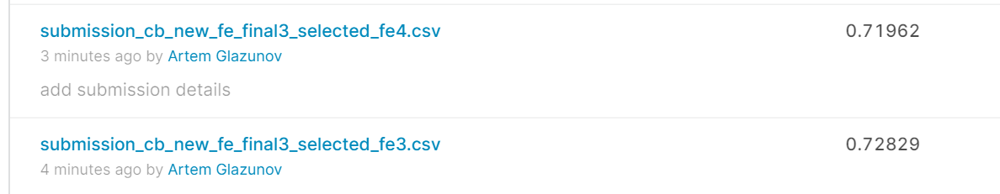

In [31]:
#Индексы значимых признаков полсле предобработки
[num_inds, cat_indices1,cat_indices2]= data_preprocessor(feats_train,params=[0.99, 0.99, 30])# params = [prop_nan,max_prop_unique,N_lim]
cat_columns = list(np.array(features.columns)[cat_indices1]) + list(np.array(features.columns)[cat_indices2])
num_columns = list(np.array(features.columns)[num_inds])
good_columns = num_columns + cat_columns

In [37]:
data_plus_new_num_train = normed_fe_interaction(feats_train[good_columns],level =2 ,max_feats = 150,num_columns=num_columns)
data_plus_new_num_val = normed_fe_interaction(feats_val[good_columns],level =2, max_feats = 150,num_columns=num_columns)

data_train = cat_prep(data_plus_new_num_train,cat_columns)
data_val = cat_prep(data_plus_new_num_val,cat_columns)

In [38]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )



estimator_cb.fit(data_train, labels_train, cat_features = cat_columns,verbose=10, plot=True,
                 eval_set = (data_val, labels_val))

num_cols_selected, cat_cols_selected ,importances = feature_selection_loop_prediction(estimator_cb,data_val,labels_val,cat_columns,threshold=0)
good_columns2 = num_cols_selected + cat_cols_selected

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5605050	test: 0.5497987	best: 0.5497987 (0)	total: 159ms	remaining: 1m
10:	learn: 0.5569304	test: 0.5496511	best: 0.5504943 (2)	total: 1.53s	remaining: 51.5s
20:	learn: 0.6060851	test: 0.5984988	best: 0.5984988 (20)	total: 3.21s	remaining: 54.8s
30:	learn: 0.6806747	test: 0.6734573	best: 0.6734573 (30)	total: 5s	remaining: 56.3s
40:	learn: 0.7110625	test: 0.7010159	best: 0.7010159 (40)	total: 6.88s	remaining: 56.9s
50:	learn: 0.7267386	test: 0.7124145	best: 0.7124145 (50)	total: 8.79s	remaining: 56.7s
60:	learn: 0.7343113	test: 0.7185856	best: 0.7185856 (60)	total: 10.7s	remaining: 55.7s
70:	learn: 0.7391164	test: 0.7219484	best: 0.7219484 (70)	total: 12.6s	remaining: 54.7s
80:	learn: 0.7463315	test: 0.7278416	best: 0.7278416 (80)	total: 14.5s	remaining: 53.4s
90:	learn: 0.7493131	test: 0.7290943	best: 0.7290943 (90)	total: 16.3s	remaining: 51.8s
100:	learn: 0.7525668	test: 0.7311711	best: 0.7311711 (100)	total: 18.3s	remaining: 50.4s
110:	learn: 0.7544025	test: 0.7316055	b

----------
Var3 diff_metric: 0.0
----------
----------
Var5 diff_metric: 0.0
----------
----------
Var6 diff_metric: 5.2124549241083784e-05
----------
----------
Var9 diff_metric: 0.0
----------
----------
Var10 diff_metric: 0.0
----------
----------
Var13 diff_metric: 6.059352822818109e-05
----------
----------
Var16 diff_metric: 0.0
----------
----------
Var17 diff_metric: 0.0
----------
----------
Var18 diff_metric: 0.0
----------
----------
Var21 diff_metric: 0.0
----------
----------
Var22 diff_metric: -0.0013586662003350902
----------
----------
good_num_columns: ['Var22']
----------
Var24 diff_metric: 0.0
----------
----------
Var25 diff_metric: 0.0002490283106877378
----------
----------
Var28 diff_metric: 0.00047779156451377425
----------
----------
Var33 diff_metric: 0.0
----------
----------
Var36 diff_metric: 1.0082117841703209e-06
----------
----------
Var37 diff_metric: 0.0
----------
----------
Var38 diff_metric: -0.00018883806717329144
----------
----------
good_num_col

In [39]:
data_plus_new_num = normed_fe_interaction(features[good_columns],level =2 ,max_feats = 150,num_columns=num_columns)
data_plus_new_num_test = normed_fe_interaction(test_data[good_columns],level =2, max_feats = 150,num_columns=num_columns)

data = cat_prep(data_plus_new_num ,cat_columns)
data_test = cat_prep(data_plus_new_num_test,cat_columns)

In [41]:
estimator_cb = CatBoostClassifier(task_type='GPU',iterations=380,random_state=0,
                                  eval_metric = 'AUC',
                                  learning_rate=0.08,
                                  boosting_type = 'Ordered',
                                  bootstrap_type='Bernoulli',
                                  subsample=0.8,
                                  one_hot_max_size=10,                                  
                                  leaf_estimation_iterations=10,
                                  max_ctr_complexity=4
                                  )
 

estimator_cb.fit(data[good_columns2], labels, cat_features = cat_cols_selected,verbose=10, plot=True)
              
probs = estimator_cb.predict_proba(data_test[good_columns2])
write_to_submission_file(probs[:,1],out_file='submission_cb_new_fe_final3_selected_fe5.csv')

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5519128	total: 157ms	remaining: 59.6s
10:	learn: 0.5556480	total: 1.34s	remaining: 44.9s
20:	learn: 0.5988294	total: 2.67s	remaining: 45.6s
30:	learn: 0.6510229	total: 3.96s	remaining: 44.6s
40:	learn: 0.6980442	total: 5.36s	remaining: 44.3s
50:	learn: 0.7176897	total: 6.83s	remaining: 44s
60:	learn: 0.7245119	total: 8.2s	remaining: 42.9s
70:	learn: 0.7307275	total: 9.62s	remaining: 41.9s
80:	learn: 0.7362364	total: 11s	remaining: 40.6s
90:	learn: 0.7407193	total: 12.5s	remaining: 39.6s
100:	learn: 0.7438927	total: 13.8s	remaining: 38.2s
110:	learn: 0.7466337	total: 15.3s	remaining: 37.1s
120:	learn: 0.7490082	total: 16.7s	remaining: 35.8s
130:	learn: 0.7514439	total: 18.1s	remaining: 34.4s
140:	learn: 0.7534985	total: 19.5s	remaining: 33.1s
150:	learn: 0.7542914	total: 20.9s	remaining: 31.7s
160:	learn: 0.7556021	total: 22.3s	remaining: 30.3s
170:	learn: 0.7567201	total: 23.7s	remaining: 28.9s
180:	learn: 0.7580822	total: 25s	remaining: 27.5s
190:	learn: 0.7593804	total: 2

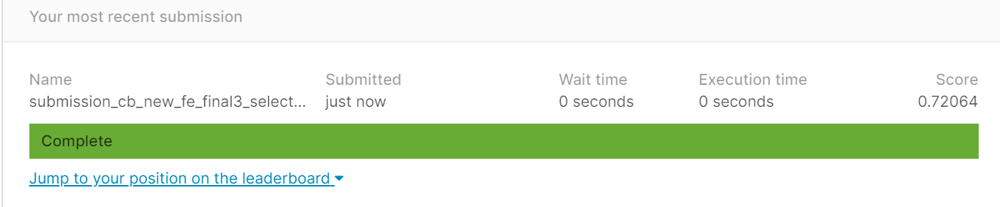

In [42]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8','submission_mean10','submission_mean11',
             'submission_cb_new_fe_final2_selected_fe2','submission_cb_new_fe_final3_selected_fe3','submission_mean12']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean13.csv')

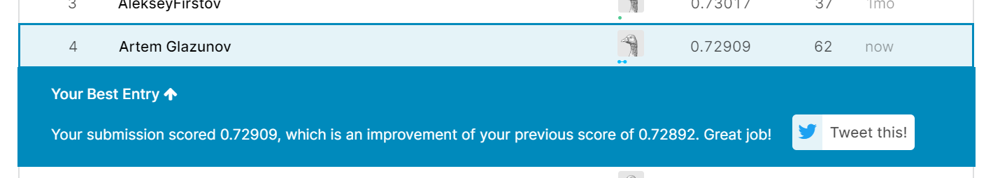

In [43]:
sub_names = ['submission_cb_new_fe1','submission_mean3','submission_mean4','submission_mean5','submission_cb_new_fe6',
             'submission_mean6','submission_mean7','submission_mean8','submission_mean10','submission_mean11',
             'submission_cb_new_fe_final2_selected_fe2','submission_cb_new_fe_final3_selected_fe3','submission_mean12',
             'submission_cb_new_fe_final3_selected_fe5','submission_cb_new_fe9','submission_cb_new_fe5',
             'submission_cb_new_fe4','submission_cb_new_fe3','submission_mean2','submission_cb_new_fe2',
             'submission_mean1','submission_cb6','submission_cb5','submission_cb3','submission_mean13']
submission_list = []
for submission_name in sub_names:
  sub = pd.read_csv(f'{submission_name}.csv',index_col=0)
  submission_list.append(sub) 
sub_df = pd.concat(submission_list,axis=1)
sub_df['mean'] = sub_df.mean(axis=1)
write_to_submission_file(sub_df[['mean']].values,out_file='submission_mean14.csv')

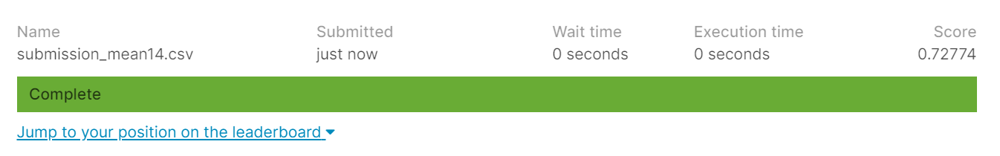

Итак, после множества экспериментов с моделью, признаками и усреднением, победил Catboost c использованием множества дополнительных признаков взаимодействия, также с учетом отбора, и в конце с усреднение нескольких ответов. Место на данный момент 4, метрика 0.72909. 

Теперь можно придумать простую схему работы с потенциально уходящими клиентами. 
Сделаем предварительную оценку эффекта.

In [ ]:
# Метрики алгоритма
precision = 0.3
recall=0.3

# Параметры компании 
n_clients = 1e6
av_revenue_per_client = 500
av_churn_prop = 0.05

# Параметры предложения
discount = 0.05
return_rate = 0.4

In [ ]:
# Экономическая модель

n_activations = n_clients*av_churn_prop*recall/precision #примерное количество срабатываний алгоритма


revenue_from_loyal_clients = n_clients*(1-av_churn_prop)*av_revenue_per_client
revenue_from_returned_clients = n_clients*av_churn_prop*av_revenue_per_client*(1-discount)*recall*return_rate

discount_inacc_loss = n_activations*(1-precision)*av_revenue_per_client*discount

# Доход с учетом модели
total_revenue = revenue_from_loyal_clients + revenue_from_returned_clients - discount_inacc_loss

#Экономический эффект от использования модели
model_gain = total_revenue - revenue_from_loyal_clients

model_gain_percent = model_gain/revenue_from_loyal_clients * 100

print(f'Выгода от использования модели: {model_gain/1e6} млн руб./месяц')
print(f'Относительная выгода: {round(model_gain_percent,3)} %')

Выгода от использвания модели: 1.975 млн руб./месяц
Относительная выгода: 0.416 %


Видно, что при использовании модели имеется экономический эффект.
Зададим функцию для расчета эффекта и посмотрим, как он будет меняться при изменении параметров модели и предложения. Будем считать, что доля уходящих клиентов известна из средней доли за предыдущие периоды.

In [ ]:
def usage_efficiency_est(precision,recall,n_clients,av_revenue_per_client,av_churn_prop,discount,return_rate):


  n_activations = n_clients*av_churn_prop*recall/precision #примерное количество срабатываний алгоритма


  revenue_from_loyal_clients = n_clients*(1-av_churn_prop)*av_revenue_per_client
  revenue_from_returned_clients = n_clients*av_churn_prop*av_revenue_per_client*(1-discount)*recall*return_rate

  discount_inacc_loss = n_activations*(1-precision)*av_revenue_per_client*discount

  # Доход с учетом модели
  total_revenue = revenue_from_loyal_clients + revenue_from_returned_clients - discount_inacc_loss

  #Экономический эффект от использования модели
  model_gain = total_revenue - revenue_from_loyal_clients

  model_gain_percent = model_gain/revenue_from_loyal_clients * 100

  return model_gain,model_gain_percent 

Оценим долю возвращающихся клиентов при использовании скидки, как min(1, 5*discount). Чтобы обосновать данную зависимость, можно провести опросы среди клиентов. При дальнейшем использовании данная оценка может быть уточнена.

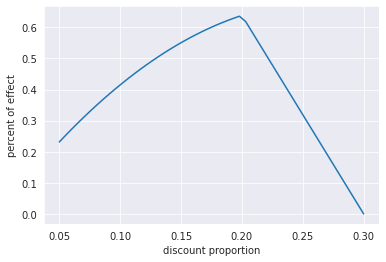

In [ ]:
discounts = np.linspace(0.05,0.3,50)
effects = list(map(lambda discount: usage_efficiency_est(0.3,0.3,1e6,500,0.06,discount,min(1,5*discount))[1],discounts))
plt.plot(discounts,effects)
plt.xlabel('discount proportion')
plt.ylabel('percent of effect');

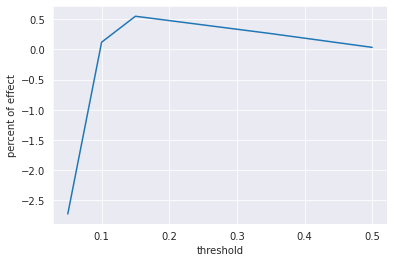

In [ ]:
trsh =[0.05,0.1,0.15,0.35,0.5]
precisions = [0.1,0.2,0.3,0.4,0.6]
recalls = [0.6,0.5,0.3,0.1,0.01]
model_params = list(zip(precisions,recalls))
effects = list(map(lambda param: usage_efficiency_est(param[0],param[1],1e6,500,0.06,0.15,0.75)[1],model_params))
plt.plot(trsh,effects)
plt.xlabel('threshold')
plt.ylabel('percent of effect');

Итак, для лучшей модели и доле потенциально уходящих клиентов 6%, в первом приближении оптимальными получились порог отнесения к оттоку в 0.15 (пороговая вероятность оттока в 15%) и предложение скидки в 15-20%. При таких параметрах относительная выгода при использовании модели больше 0.5%, что при 500 млн руб. дохода составит более 2,5 млн руб. в месяц. В качестве улучшения, можно давать скидку пропорционально вероятности оттока, тогда, в случае если средняя вероятность оттока для клиентов будет меньше той, которая соответствует скидке в 15-20%, будет экономия при тех же значениях доли возвращающихся клиентов.